<a id='beginning_CRVA'></a>
# Climate Risk and Vulnerability Analysis
This notebook helps you download and visualize climate data to perform Climate Risk and Vulnerability analyses

## Usage
this is how to use this script

1. [Define user input](#user_input)
2. [Run wanted climate variables](#climate_variables)
    1. [Atmosphere's climate variables](#atmosphere_climate_variables)
    2. [Land climate's variables](#land_climate_variables)
    3. [Hydrosphere's climate variables](#hydrosphere_climate_variables)
    4. [Second effect's climate variables](#second_effect_climate_variables)
3. [Export data](#Export)

## Input data

* [Shapefile with project location(s) as points or polygon](#load_shapefile)
* List of variables
* List of SSP's
* List of time horizons

## [Climate variables](#climate_variables)
### [Atmosphere's climate variables](#atmosphere_climate_variables)
* [World Bank Climate knowledge portal, Precipitation and Temperature - Atmosphere](#worldbank)
* [Temperature NEX-GDDP-CMIP6](#NEXGDDPCMIP6_Temperature)
* [Precipitation NEX-GDDP-CMIP6](#NEXGDDPCMIP6_Precipitation)
* [Wind](#wind)
* [Humidity](#humidity)
* [Solar radiation](#solar_radiation)
* Air quality deterioration
### [Land's climate variables](#land_climate_variables)
* [Landslides](#landslides)
* Coastal erosion
* Soil erosion
* Soil salinity
### [Hydrosphere's climate variables](#hydrosphere_climate_variables)
* [Relative sea level rise](#relative_sea_level_rise)
* [Seawater temperature](#sea_water_temperature)
* [Water availability](#water_availability)
* floods (fluvial)
* floods (coastal)
* forest fires
### [Second effects of climate variables](#second_effect_climate_variables)
* Storms
* Dust storms
* Wildfire
* Urban heat island
* Growinf season length
* [cyclone risk](#cyclone_risk)



* earthquakes (not climate related)

## Climate impacts
* calculate impact on yields

## [Climate change information concerning the projects in the study area](#climate_change_info_for_each_project_in_study_area)


## Contact

rapy@cowi.com

<a id='user_input'></a>
## User inputs

[Home](#beginning_CRVA)

In [1]:
#User inputs
import os.path

#project locations (shapefile with location of elements to evaluate)
data_folder=r'\\COWI.net\projects\A245000\A248363\CRVA\Datasets'
#data_folder=os.path.join(os.pardir,'dataset')
project_location_path=os.path.join(data_folder,'Mozambique_PPIS/EIB_locations_few.shp')
project_id='Name' #name of column used as id

#study boundary (optional)
study_area_path=os.path.join(data_folder,'Mozambique_PPIS/mozambique.shp')

#study boundary (optional)
#study_area_path=os.path.join(data_folder,'timor/boundaries.shp')
#area_sq=os.path.join(data_folder,'timor/timor_.shp')
#output folder
out_path=r'\\COWI.net\projects\A245000\A248363\CRVA\Scripts\outputs'
out_path_database=r'\\COWI.net\projects\A245000\A248363\CRVA\Datasets'
#projection CRS (default = 'EPSG:4326')
bCRS='EPSG:4326'

#buffer for climate/grid variables
buffer=10000 #buffer in meters, 0 = no buffer is computed

mCRS='EPSG:31983' #metric CRS for buffer in meters (find relevant metric CRS for location!)

## Import python packages

In [2]:
#Import python packages
from rasterstats import zonal_stats
import pandas as pd
import geopandas as gpd
import rasterio
from rasterio.plot import show
import rioxarray #used when calling ncdata.rio.write_crs
import xarray as xr
import os
import os.path
import matplotlib.pyplot as plt
import netCDF4 as nc#not directly used but needs to be imported for some nc4 files manipulations, use for nc files
from netCDF4 import Dataset
import csv #REMOVE ? not in use ?
import numpy as np
import numpy.ma as ma
from mpl_toolkits.basemap import Basemap
import shutil # to move folders
import warnings
warnings.filterwarnings('ignore') # to ignore the warnings
#import io
import cdsapi # for copernicus function
import datetime # to have actual date
from osgeo import gdal, ogr, osr # in order to convert shp in raster
from geopandas import GeoDataFrame
from shapely.geometry import Point
from matplotlib.lines import Line2D
import seaborn as sns

import sys 
sys.path.append("../0-Functions")

from FunctionsAndClass import read_cckp_ncdata
from FunctionsAndClass import get_cckp_file_name

from Functions_Indicators import temporal_avg
from Functions_Indicators import temporal_max
from Functions_Indicators import df_stat_distr
from Functions_Indicators import number_day_above_threshold
from Functions_Indicators import filter_dataframe
from Functions_Indicators import changes_in_indicators
from Functions_Indicators import dataframe_n_day_event
from Functions_Indicators import dataframe_max_5_days_event
from Functions_Indicators import level_exposure
from Functions_Indicators import vulnerability
from Functions_Indicators import dataframe_threshold_coresponding_to_return_period_model
from Functions_Indicators import dataframe_return_period_coresponding_to_past_100year_event_model

from Functions_ImportData import import_treat_modeled_NEX_GDDP_CMIP6
from Functions_ImportData import sensitivity
from Functions_ImportData import import_BC_NOAA_NEX_GDDP_CMIP6

from Graphs_functions import plot_lines
from Graphs_functions import trends_month

from Functions_likelihood import likelihood_accross_models
from Functions_likelihood import likelihood_accross_models_and_ssps

from Functions_likelihood import look_best_distr
from Functions_likelihood import range_likelihood

<a id='load_shapefile'></a>
## Load shapefiles and plot

In [3]:
#load shapefiles
projects = gpd.read_file(project_location_path).to_crs(bCRS)
study_area = gpd.read_file(study_area_path).to_crs(bCRS)
area_square=gpd.read_file(area_sq)
#sea_area = gpd.read_file(sea_area_path).to_crs(bCRS)

#Calculate buffer around points/shape
if buffer != 0:
    projects_buf=projects.to_crs(mCRS) #project to crs with metric units to get buffer in meters
    projects_buf['geometry']=projects.to_crs(mCRS).buffer(buffer)#assign the buffer as the new geometry - 
    projects_buf=projects_buf.to_crs(bCRS) #project back to orginal crs

    
#plot shapefiles
fig, ax = plt.subplots()
study_area.plot(ax=ax,)
#projects.plot(ax=ax,color='Black')
projects_buf.plot(ax=ax,edgecolor="red", facecolor="none") 
ax.set_title('Study area and projects showing the selected buffer')

#show table
projects[[project_id]]

#create output directory
if not os.path.isdir('outputs'):
    os.mkdir('outputs') 


NameError: name 'area_sq' is not defined

In [ ]:
# name project in mozambique, those ones were added in the shp (there were initially not in the shapefile)
name_projects = np.array(['WTP_Mutua_EIB', 'Gorongosa_EIB', 'Chimoio_WTP_EIB', 'Pemba_EIB'])

lon_projects_data = np.array([34.5927839939706, 34.07824286310398 , 33.47333313659342, 40.52545156033736]) # decimal degrees
lon_projects = pd.Series(lon_projects_data)

lat_projects_data = np.array([-19.495079648575242, -18.68063728746643, -19.125095255188334,-12.973942656747809]) # decimal degrees
lat_projects = pd.Series(lat_projects_data) 
buffer_area_project=2
area_projects = [lat_projects - buffer_area_project, lat_projects+buffer_area_project, lon_projects-buffer_area_project,lon_projects+buffer_area_project] # list format

# elevation above sea level 
elevation_asl_data = np.array([15, 383, 723, 47]) # unit m 
elevation_asl = pd.Series(elevation_asl_data) # unit m 

# add informations of projects in one dataframe
infos_projects = pd.DataFrame()
infos_projects['Name project'] = name_projects
infos_projects['Longitude DD'] = lon_projects
infos_projects['Latitude DD'] = lat_projects
infos_projects['Elevation above sea level m'] = elevation_asl
infos_projects

<a id='load_shapefile'></a>
## Load shapefiles and plot

In [ ]:
#load shapefiles
projects = gpd.read_file(project_location_path).to_crs(bCRS)
study_area = gpd.read_file(study_area_path).to_crs(bCRS)

#calculate buffer around points/shape
if buffer != 0:
    projects_buf=projects.to_crs(mCRS)  #project to crs with metric units to get buffer in meters
    projects_buf['geometry']=projects.to_crs(mCRS).buffer(buffer) #assign the buffer as the new geometry - 
    projects_buf=projects_buf.to_crs(bCRS)#project back to orginal crs

    
#plot shapefiles
study_area.plot()
projects.plot()
projects_buf.plot() 


#show table
projects[[project_id]]

# prepare name_project for use 
name_project = projects['Name'].str.replace(' ','_') # take off every blank space of project names
name_project = name_project.str.replace('(','') # take off every ( of project names
name_project = name_project.str.replace(')','') # take off every ) of project names
name_project = name_project.str.replace('-','') # take off every - of project names
name_project = name_project.str.replace('/','_') # take off every / of project names
name_project = name_project.str.replace(r'"\"','_') # take off every \ of project names

# register geographic information concerning projects
lon_projects = projects['geometry'].x
lat_projects = projects['geometry'].y
area_projects = [lat_projects - 5, lat_projects+5, lon_projects-5,lon_projects+5] # list format
# 5 degres trop grand 
#### determination of the geographical zone of interest 
#lat_min_wanted = min(study_area['LAT'])-10
#lat_max_wanted = max(study_area['LAT'])+10
#lon_min_wanted = min(study_area['LON'])-20
#lon_max_wanted = max(study_area['LON'])+20
# addind and substracting to lon and lat to have margin
# substracting more to longitude because the range of longitude is -180 to 180. The range of latitude is -90 to 90

#area = [lat_min_wanted, lon_min_wanted, lat_max_wanted,lon_max_wanted,] # used to download from copernicus
first_year=1950
last_year =2100
### YEAR
year = np.arange(first_year,(last_year+1),1) # create vector of years
year_str = [0]*len(year) # create initiale empty vector to convert years in int
index = np.arange(0,len(year)) # create vector of index for year
i = 0 # initialize index
for i in index: # convert all the date in string format
    year_str[i]=str(year[i])

start_date = "01-01-"+year_str[0] # string start date based on start year
stop_date = "31-12-"+year_str[len(year)-1] # string stop date based on stop year
dates = pd.date_range(start_date,stop_date) # vector of dates between start date and stop date
index_dates = np.arange(0,len(dates)) # vector containning index or dates vector

In [ ]:
# name project in mozambique, those ones were added in the shp (there were initially not in the shapefile)
name_projects = np.array(['WTP_Mutua_EIB', 'Gorongosa_EIB', 'Chimoio_WTP_EIB', 'Pemba_EIB'])

lon_projects_data = np.array([34.5927839939706, 34.07824286310398 , 33.47333313659342, 40.52545156033736]) # decimal degrees
lon_projects = pd.Series(lon_projects_data)

lat_projects_data = np.array([-19.495079648575242, -18.68063728746643, -19.125095255188334,-12.973942656747809]) # decimal degrees
lat_projects = pd.Series(lat_projects_data) 
buffer_area_project=2
area_projects = [lat_projects - buffer_area_project, lat_projects+buffer_area_project, lon_projects-buffer_area_project,lon_projects+buffer_area_project] # list format

# elevation above sea level 
elevation_asl_data = np.array([15, 383, 723, 47]) # unit m 
elevation_asl = pd.Series(elevation_asl_data) # unit m 

# add informations of projects in one dataframe
infos_projects = pd.DataFrame()
infos_projects['Name project'] = name_projects
infos_projects['Longitude DD'] = lon_projects
infos_projects['Latitude DD'] = lat_projects
infos_projects['Elevation above sea level m'] = elevation_asl
infos_projects

<a id='climate_variables'></a>
# Climate variables

[Home](#beginning_CRVA)

<a id='atmosphere_climate_variables'></a>
# ATMOSPHERE

[Home](#beginning_CRVA)

<a id='worldbank'></a>
## World Bank Climate knowledge portal, Precipitation and Temperature - Atmosphere
data source: https://climateknowledgeportal.worldbank.org/download-data

List of different variables:

### Precipitation 
* return period of current 50 and 100 year event
* yearly average precipitation
* seasonal average precipitation - OR MONTH? i word documnet: average dry season precipitation 
* maximum precipitation in one day - NOT REALLY, instead "Average of the largest daily precipitation amount" rx1day 
* maximum precipitation in five days - NOT REALLY, instead "Average of the largest 5-day consecutive precipitation amount".
* FORSLAG: Could also include: precipitation amount from very wet days/ days >50mm. eg. 

### Temperature
* Yearly mean temperature (average) - tas 
* Number of hot days >40 degrees C (average)
* Number of hot days >35 degrees C (average) 
* Maximum of daily max-temperature (per year) -txx
* Average of maximum temperature (daily??) - tasmax 

### How to use
define 

`variables = {variablename1:{'periods':['2020-2039'],'ssps':['ssp245','ssp370'],'gcms':['median','p10','p90']}, variablename2:...}`

where variablename corresponds to a variable name in the cckp, periods include the desired periods, ssps the desired ssp-rcp scenarios, and gcms can be either median, p10, or p90 (50%, 10%, and 90% percentile of ensemble models).

fig, ax = plt.subplots()
data_clip = data.rio.clip(study_area.geometry, study_area.crs, drop=True)
#nodata = rasterio.open(data_clip).nodata
#data_clip = rasterio.open(data_clip)
#data_clip.close()
#data_clip=data # Shows sorunding temperatures - not cliped to the study_area
xlim = ([study_area.total_bounds[0]-0.5,  study_area.total_bounds[2]+0.5])
ylim = ([study_area.total_bounds[1]-0.5,  study_area.total_bounds[3]+0.5])

#data_clip=data_clip.where(data_clip != 1e+20)
data_clip.plot(ax=ax, cmap='Reds', xlim=(xlim),ylim=(ylim))
projects_buf.plot(ax=ax,edgecolor="red", facecolor="none") 

study_area.plot(ax=ax, edgecolor="black", facecolor="none")
title='Chosen climate scenario: \n'+var+'_ '+ssp+'_ '+period+'_ '+gcm
ax.set_title(title)

data_clip.close()

<a id='NEXGDDPCMIP6_Temperature'></a>
## NEX-GDDP-CMIP6 Temperature

By comparing NEX GDDP CMIP6 data to observed data, we know that the models 'TAIESM1' and 'CMCC-CM2-SR5' do not comply to the observed data. We are taking them off the analysis.
A bias correction does not better the quality of the data. It follows oberved data enough. The data use below were not bias corrected a second time.

In [348]:
csv_path=r'\\cowi.net\projects\A245000\A248363\CRVA\Datasets\NEX-GDDP-CMIP6-AllMoz\csv_file'
locNames='_projectsMoz' 
df_tas_NEXGDDPCMIP6=import_treat_modeled_NEX_GDDP_CMIP6('tas','Celsius','day',1950,2100,csv_path,locNames)

In [349]:
loc='WTP_Mutua_EIB' #name of location point at interest
#df_tas_NEXGDDPCMIP6_loc = filter_dataframe(df_tas_NEXGDDPCMIP6,[loc],['TaiESM1','CMCC-CM2-SR5','NESM3','ACCESS-CM2','ACCESS-ESM1-5','NorESM2-MM','MPI-ESM1-2-LR','MRI-ESM2-0','MIROC6'])

In [297]:
#PLOT DIFFERENT MODELS
#fig,ax=plt.subplots()
#plt.tight_layout() # Adjust the padding between and around subplots.
df_tas_NEXGDDPCMIP6_loc = filter_dataframe(df_tas_NEXGDDPCMIP6,[loc],['TaiESM1','CMCC-CM2-SR5'])#'TaiESM1','CMCC-CM2-SR5','NESM3'

In [298]:
df_tas_NEXGDDPCMIP6_loc

,Name project,Experiment,Model,Latitude,Longitude,Date,Daily Near-Surface Air Temperature °C,Year,Month,Season
0,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,01-01-1950,30.038757,1950,Jan,Humid
1,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,02-01-1950,30.407043,1950,Jan,Humid
2,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,03-01-1950,30.592712,1950,Jan,Humid
3,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,04-01-1950,31.287659,1950,Jan,Humid
4,WTP_Mutua_EIB,historical,ACCESS-CM2,-19.375,34.625,05-01-1950,25.517853,1950,Jan,Humid
...,...,...,...,...,...,...,...,...,...,...
2209359,WTP_Mutua_EIB,ssp370,NorESM2-MM,-19.375,34.625,27-12-2100,33.455231,2100,Dec,Humid
2209360,WTP_Mutua_EIB,ssp370,NorESM2-MM,-19.375,34.625,28-12-2100,33.220306,2100,Dec,Humid
2209361,WTP_Mutua_EIB,ssp370,NorESM2-MM,-19.375,34.625,29-12-2100,33.295776,2100,Dec,Humid
2209362,WTP_Mutua_EIB,ssp370,NorESM2-MM,-19.375,34.625,30-12-2100,33.413116,2100,Dec,Humid


### Incremental air temperature change BC

In [253]:
# calculate mean per year for location
df_yearly_avg_tas_NEXGDDPCMIP6_loc=temporal_avg(df_tas_NEXGDDPCMIP6_loc,'temperature','Yearly average air temperature','year')
df_yearly_avg_tas_NEXGDDPCMIP6_loc=df_yearly_avg_tas_NEXGDDPCMIP6_loc.reset_index() #reset index derived from groupby when using temporal_avg function

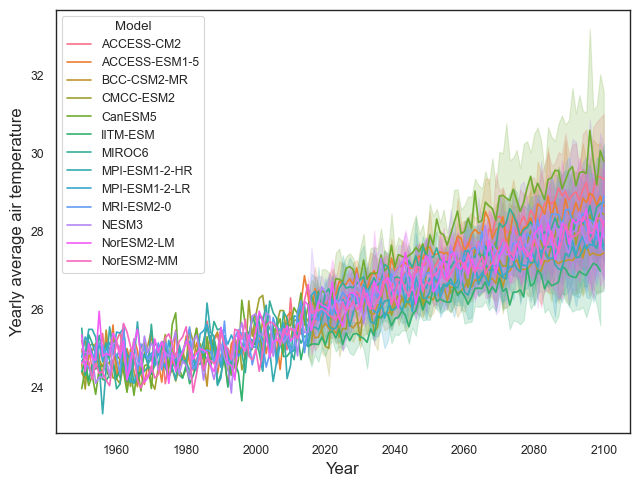

In [254]:
#PLOT DIFFERENT MODELS
fig,ax=plt.subplots()
plt.tight_layout() # Adjust the padding between and around subplots.
#df=df_yearly_avg_tas_NEXGDDPCMIP6_loc
p=sns.lineplot(df_yearly_avg_tas_NEXGDDPCMIP6_loc,x='Year',y='Yearly average air temperature',hue='Model')

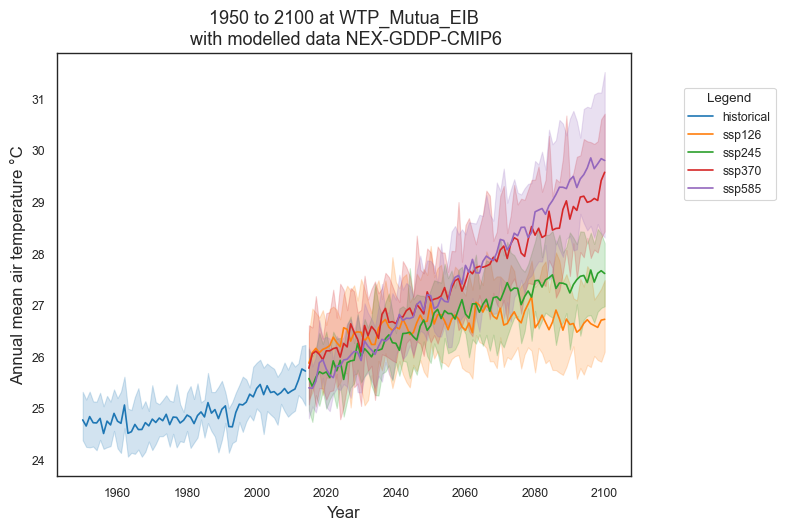

In [224]:
plot_title='avg_temp_'+loc+'_1950-2100'
plot_lines(df_yearly_avg_tas_NEXGDDPCMIP6_loc,'Year','Yearly average air temperature','Experiment','NEX-GDDP-CMIP6','Annual mean air temperature °C','',loc,y_start=1950,y_stop=2100,tuple_error_bar=('pi',80))
plt.savefig(plot_title+'.svg', bbox_inches='tight')

## cdf-curves (tas) 

In [1]:
#USE THIS ONE
# CDF-curves for Models with different scenarios 
var='Daily mean '
scenario='ssp585' #'ssp126', ssp245', 'ssp370','ssp585'

#models=['ACCESS-CM2', 'ACCESS-ESM1-5', 'BCC-CSM2-MR', 'CanESM5',
       #'CMCC-CM2-SR5', 'CMCC-ESM2', 'MIROC6', 'MPI-ESM1-2-HR',
      # 'MPI-ESM1-2-LR', 'MRI-ESM2-0', 'NESM3', 'NorESM2-LM', 'NorESM2-MM',
      # 'TaiESM1']  
loc_= loc.replace('_','') # take off every - of project names
loc_=loc_.replace('WTP','')
loc_=loc_.replace('EIB','')

df_tas_scen=df_tas_NEXGDDPCMIP6_loc[df_tas_NEXGDDPCMIP6_loc['Experiment']==scenario]

f, ax = plt.subplots()
#for m in models:
ax = sns.ecdfplot(x=df_tas_scen['Daily Near-Surface Air Temperature °C'], hue=df_tas_scen['Model'])
ax.grid(False)
sns.set_context( rc={"axes.titlesize":13,"axes.labelsize":12})  
ylim_min=0#df[y_axis].min()
ylim_max=1.02#df[y_axis].max()
ax.set_ylim(ylim_min,ylim_max)
ax.tick_params(labelsize=11)
plt.xlabel('Daily air temperature (°C)')
sns.set_style("white")
sns.set_style(rc = {'axes.facecolor': 'white'})
title=loc_+ ': ' + scenario
plt.title(title)
f.tight_layout#
f.savefig(loc+'_tas_'+scenario+ '.svg', bbox_inches='tight')

NameError: name 'loc' is not defined

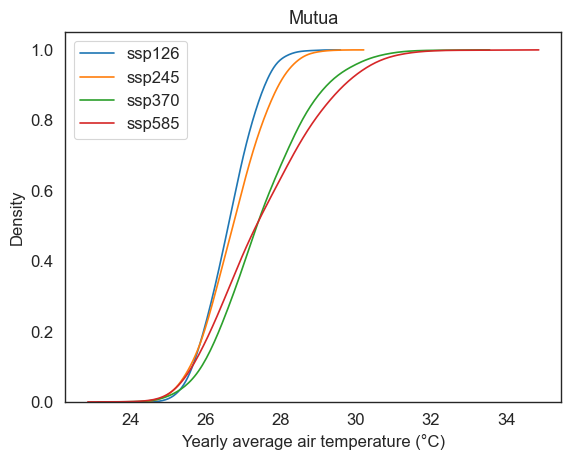

In [230]:
# CDF-curves scenarios 

scenario=['ssp126', 'ssp245', 'ssp370','ssp585']
f, ax = plt.subplots()
plt.tight_layout
for s in scenario:
    df_tas_scen=df_yearly_avg_tas_NEXGDDPCMIP6_loc[df_yearly_avg_tas_NEXGDDPCMIP6_loc['Experiment']==s]
    ax = sns.kdeplot(df_tas_scen['Yearly average air temperature'], cumulative=True)

ax.legend(labels=scenario,fontsize=12)
ax.grid(False)
sns.set_context( rc={"axes.titlesize":13,"axes.labelsize":12})  
ax.tick_params(labelsize=12)
plt.xlabel('Yearly average air temperature (°C)')
sns.set_style("white")
sns.set_style(rc = {'axes.facecolor': 'white'})
title=loc_#+ ':'+' '+var
plt.title(title)
f.tight_layout#
plt.savefig(loc+'_tas_yearlyMean'+'scenarios'+ '.svg', bbox_inches='tight')


#### Vulnerability - Exposure - daily - no aggregation

In [340]:
df_tas_NEXGDDPCMIP6_loc_future=df_tas_NEXGDDPCMIP6_loc.reset_index()[df_tas_NEXGDDPCMIP6_loc.reset_index()['Year'].between(2030,2074)][['Name project','Daily Near-Surface Air Temperature °C','Model','Experiment']]
df_tas_NEXGDDPCMIP6_loc_past=df_tas_NEXGDDPCMIP6_loc.reset_index()[df_tas_NEXGDDPCMIP6_loc.reset_index()['Year'].between(1970,2014)][['Name project','Daily Near-Surface Air Temperature °C','Model','Experiment']]
df_tas_NEXGDDPCMIP6_loc_past

,Name project,Daily Near-Surface Air Temperature °C,Model,Experiment
7305,WTP_Mutua_EIB,27.728607,ACCESS-CM2,historical
7306,WTP_Mutua_EIB,28.151520,ACCESS-CM2,historical
7307,WTP_Mutua_EIB,28.743713,ACCESS-CM2,historical
7308,WTP_Mutua_EIB,28.420227,ACCESS-CM2,historical
7309,WTP_Mutua_EIB,27.893341,ACCESS-CM2,historical
...,...,...,...,...
308628,WTP_Mutua_EIB,31.013275,NorESM2-MM,historical
308629,WTP_Mutua_EIB,31.318359,NorESM2-MM,historical
308630,WTP_Mutua_EIB,30.952240,NorESM2-MM,historical
308631,WTP_Mutua_EIB,30.701385,NorESM2-MM,historical


In [345]:
df_stat_distr_tas_NEXGDDPCMIP6_loc_past = df_stat_distr(df_tas_NEXGDDPCMIP6_loc.reset_index()[df_tas_NEXGDDPCMIP6_loc.reset_index()['Year'].between(1970,2014)][['Name project','Daily Near-Surface Air Temperature °C']])

df_stat_distr_tas_NEXGDDPCMIP6_loc_future = df_stat_distr(df_tas_NEXGDDPCMIP6_loc.reset_index()[df_tas_NEXGDDPCMIP6_loc.reset_index()['Year'].between(2030,2074)][['Name project','Daily Near-Surface Air Temperature °C']])
df_stat_distr_tas_NEXGDDPCMIP6_loc_past


Daily Near-Surface Air Temperature °C                       \
                                              count       mean       std   
Name project                                                               
WTP_Mutua_EIB                              213604.0  25.059786  2.956748   

                                                                     
                     min        10%        50%        90%       max  
Name project                                                         
WTP_Mutua_EIB  13.602173  20.887338  25.482574  28.625418  36.64505

In [346]:
df_stat_distr_tas_NEXGDDPCMIP6_loc_future

Daily Near-Surface Air Temperature °C                       \
                                              count       mean       std   
Name project                                                               
WTP_Mutua_EIB                              837980.0  26.925823  3.130842   

                                                                      
                     min        10%        50%        90%        max  
Name project                                                          
WTP_Mutua_EIB  12.412506  22.538116  27.290802  30.747223  39.436371

#### Vulnerability - Exposure - yearly aggregation

In [347]:
df_stat_distr_tas_NEXGDDPCMIP6_loc_past = df_stat_distr(df_yearly_avg_tas_NEXGDDPCMIP6_loc.reset_index()[df_yearly_avg_tas_NEXGDDPCMIP6_loc.reset_index()['Year'].between(1970,2014)][['Name project','Yearly average air temperature']])
df_stat_distr_tas_NEXGDDPCMIP6_loc_future = df_stat_distr(df_yearly_avg_tas_NEXGDDPCMIP6_loc.reset_index()[df_yearly_avg_tas_NEXGDDPCMIP6_loc.reset_index()['Year'].between(2030,2074)][['Name project','Yearly average air temperature']])

,Name project,Yearly average air temperature
20,WTP_Mutua_EIB,24.679706
21,WTP_Mutua_EIB,24.826077
22,WTP_Mutua_EIB,25.047384
23,WTP_Mutua_EIB,25.063256
24,WTP_Mutua_EIB,24.101149
...,...,...
840,WTP_Mutua_EIB,25.521489
841,WTP_Mutua_EIB,25.455285
842,WTP_Mutua_EIB,25.251929
843,WTP_Mutua_EIB,25.587432


In [319]:
changes_past_future_indicator_tas=changes_in_indicators(df_stat_distr_yearly_avg_tas_NEXGDDPCMIP6_loc_past,df_stat_distr_yearly_avg_tas_NEXGDDPCMIP6_loc_future,'Mean air temperature per year', '°C','Incremental air temperature change')
changes_past_future_indicator_tas #![image-3.png](attachment:image-3.png)

Incremental air temperature change                            \
                   Mean air temperature per year                             
                   Median for the past period °C Change in the median in %   
WTP_Mutua_EIB                          25.027487                  7.315607   

                                                       \
                                                        
              10-th percentile for the past period °C   
WTP_Mutua_EIB                               24.455517   

                                            \
                                             
              Change in 10-th percentile %   
WTP_Mutua_EIB                     5.814307   

                                                       \
                                                        
              90-th percentile for the past period °C   
WTP_Mutua_EIB                                 25.6938   

                                            
                                            
              Change in 90-th percentile %  
WTP_Mutua_EIB                     9.227345

### cdf tas_future

In [ ]:
# CDF-curves for Models with different scenarios 
var='Daily mean '
scenario='ssp585' #'ssp126', ssp245', 'ssp370','ssp585'
#models=['ACCESS-CM2', 'ACCESS-ESM1-5', 'BCC-CSM2-MR', 'CanESM5',
       #'CMCC-CM2-SR5', 'CMCC-ESM2', 'MIROC6', 'MPI-ESM1-2-HR',
      # 'MPI-ESM1-2-LR', 'MRI-ESM2-0', 'NESM3', 'NorESM2-LM', 'NorESM2-MM',
      # 'TaiESM1']  
loc_= loc.replace('_','') # take off every - of project names
loc_=loc_.replace('WTP','')
loc_=loc_.replace('EIB','')

df_tas_scen=df_tas_NEXGDDPCMIP6_loc[df_tas_NEXGDDPCMIP6_loc['Experiment']==scenario]

f, ax = plt.subplots()
#for m in models:
ax = sns.ecdfplot(x=df_tas_scen['Daily Near-Surface Air Temperature °C'], hue=df_tas_scen['Model'])
ax.grid(False)
sns.set_context( rc={"axes.titlesize":13,"axes.labelsize":12})  
ylim_min=0#df[y_axis].min()
ylim_max=1.02#df[y_axis].max()
ax.set_ylim(ylim_min,ylim_max)
ax.tick_params(labelsize=11)
plt.xlabel('Daily air temperature (°C)')
sns.set_style("white")
sns.set_style(rc = {'axes.facecolor': 'white'})
title=loc_+ ': ' + scenario
plt.title(title)
f.tight_layout#
f.savefig(loc+'_tas_'+scenario+ '.svg', bbox_inches='tight')

#### Risk assessment - Likelihood

In [22]:
df_yearly_avg_tas_NEXGDDPCMIP6_loc


Yearly average air temperature
Name project Experiment Model      Year                                
Pemba_EIB    historical ACCESS-CM2 1950                       26.093759
                                   1951                       26.160028
                                   1952                       26.080386
                                   1953                       26.237031
                                   1954                       25.931379
...                                                                 ...
             ssp585     NorESM2-MM 2096                       29.576016
                                   2097                       30.554944
                                   2098                       30.004081
                                   2099                       30.048321
                                   2100                       30.245751

[4908 rows x 1 columns]

best distribution johnsonsb
params a=-0.25, b=0.71, loc=27.30, scale=1.19
proba_event_model 0.0
proba_event_model registered
best distribution exponweib
params a=0.10, c=12.34, loc=27.62, scale=1.77
proba_event_model 0.0
proba_event_model registered
best distribution dweibull
params c=1.50, loc=28.06, scale=0.29
proba_event_model 0.0
proba_event_model registered
best distribution dweibull
params c=1.71, loc=28.38, scale=0.48
proba_event_model 0.0
proba_event_model registered
best distribution exponweib
params a=0.24, c=6.16, loc=27.26, scale=1.15
proba_event_model 0.0
proba_event_model registered
best distribution dweibull
params c=1.64, loc=28.03, scale=0.39
proba_event_model 0.0
proba_event_model registered
best distribution laplace_asymmetric
params kappa=1.31, loc=27.83, scale=0.20
proba_event_model 0.0
proba_event_model registered
best distribution laplace_asymmetric
params kappa=1.89, loc=28.74, scale=0.32
proba_event_model 0.0
proba_event_model registered
best distribution dgamm

<Figure size 1200x800 with 0 Axes>

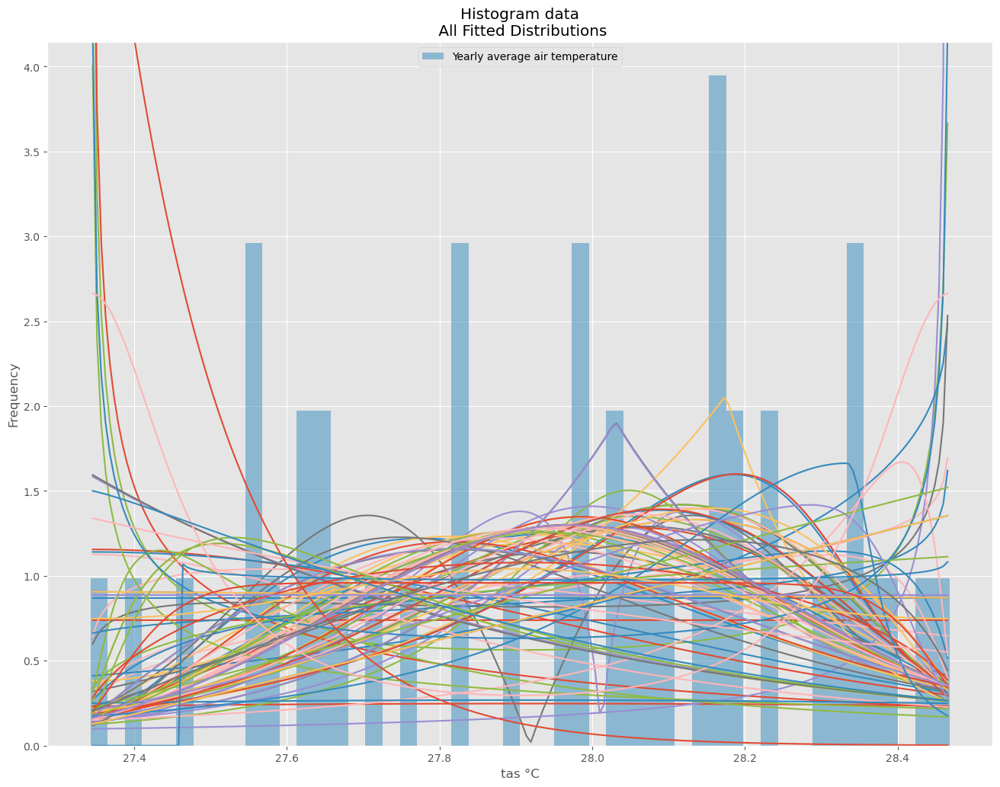

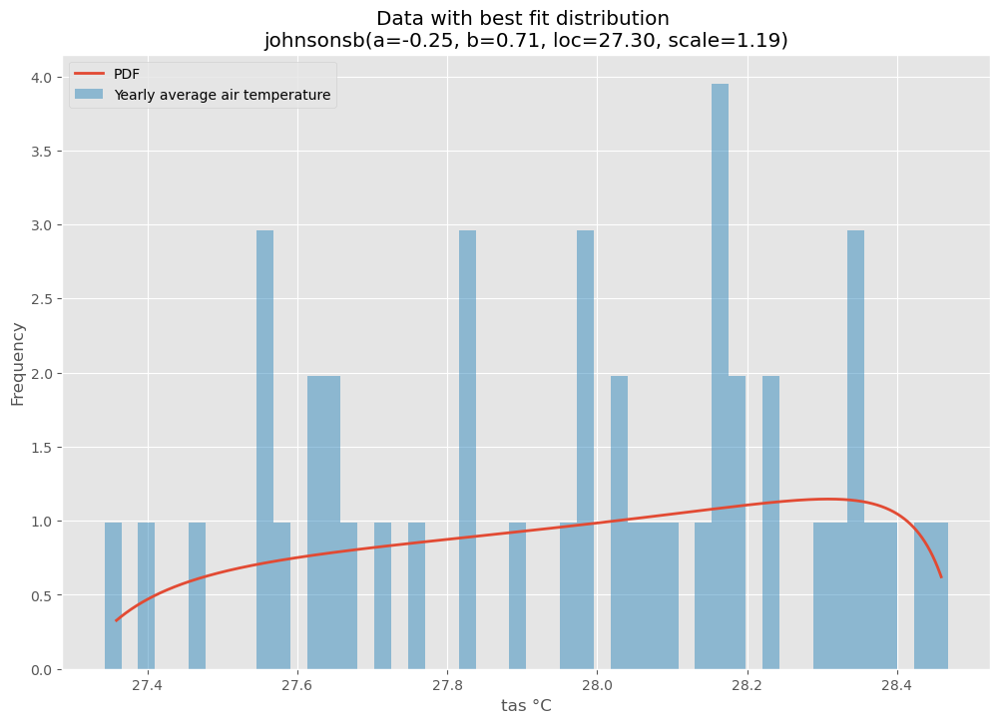

<Figure size 1200x800 with 0 Axes>

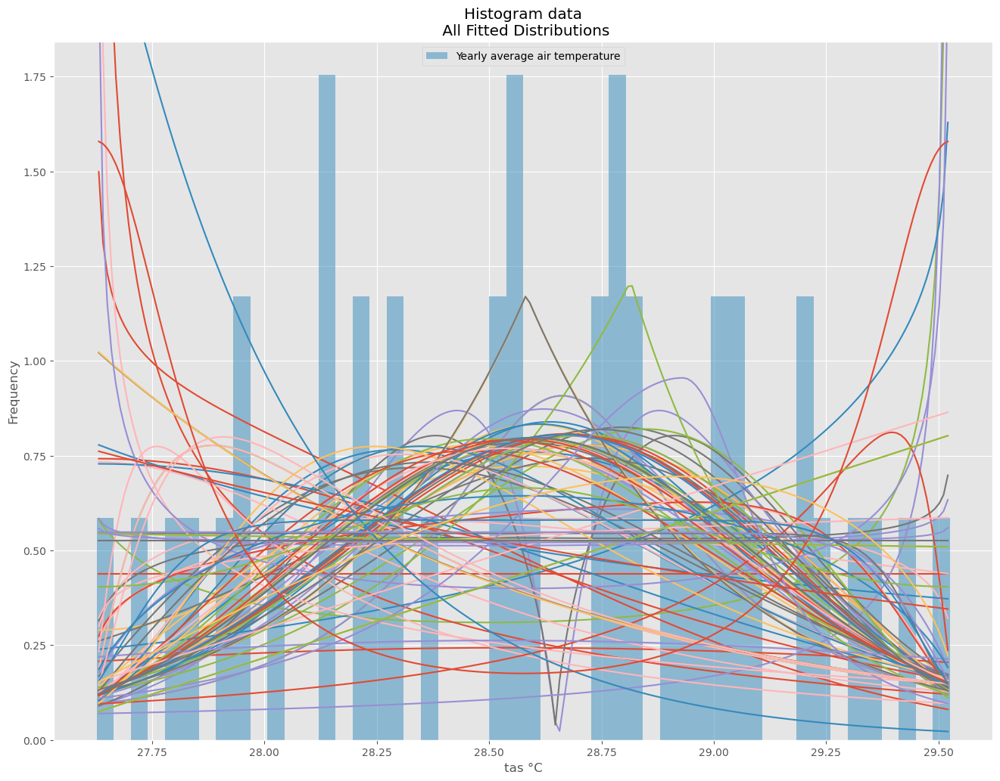

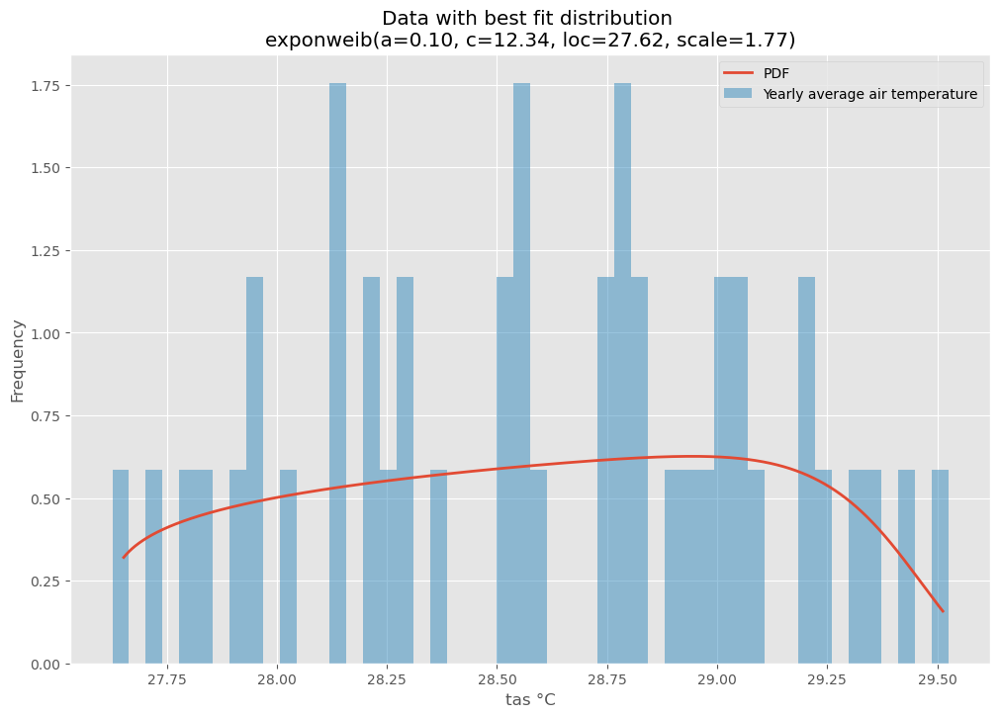

<Figure size 1200x800 with 0 Axes>

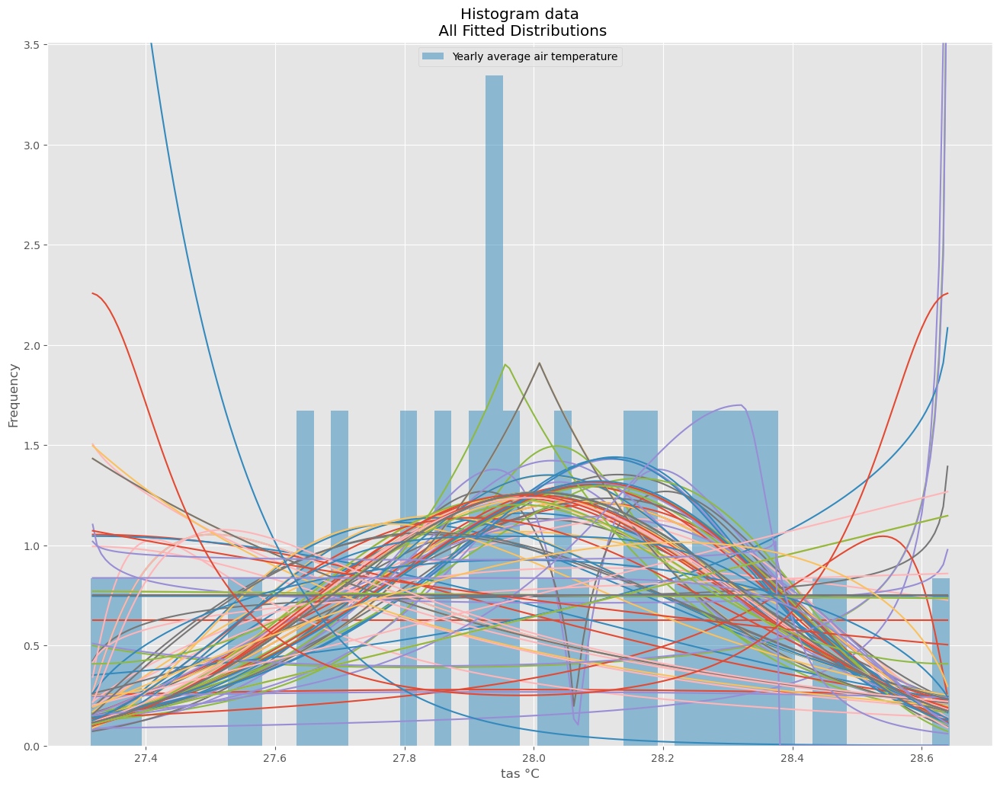

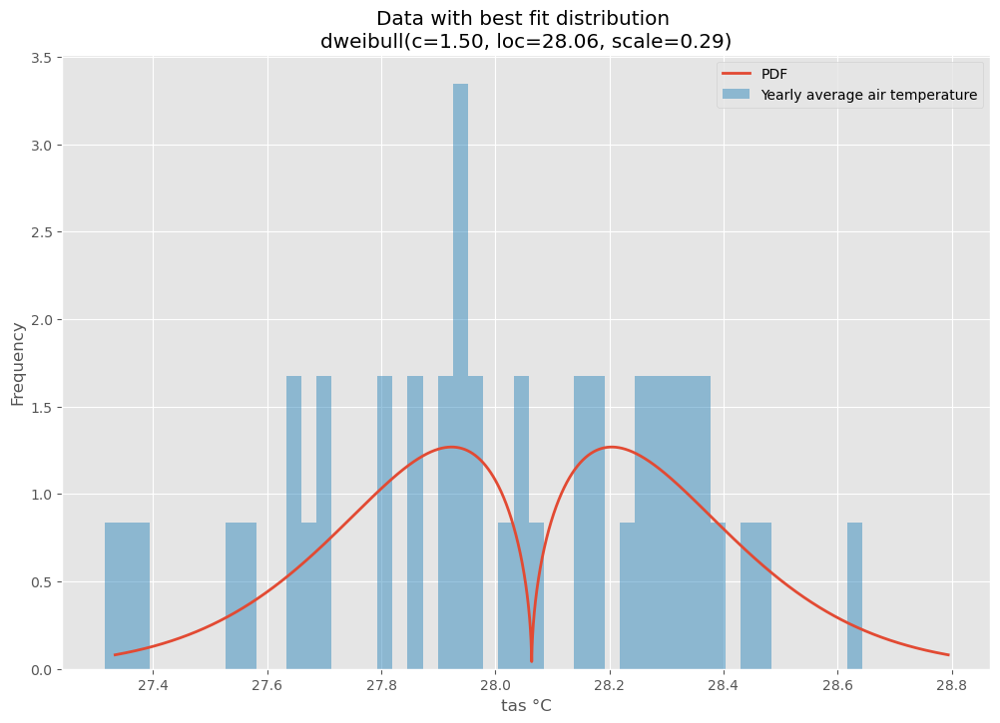

<Figure size 1200x800 with 0 Axes>

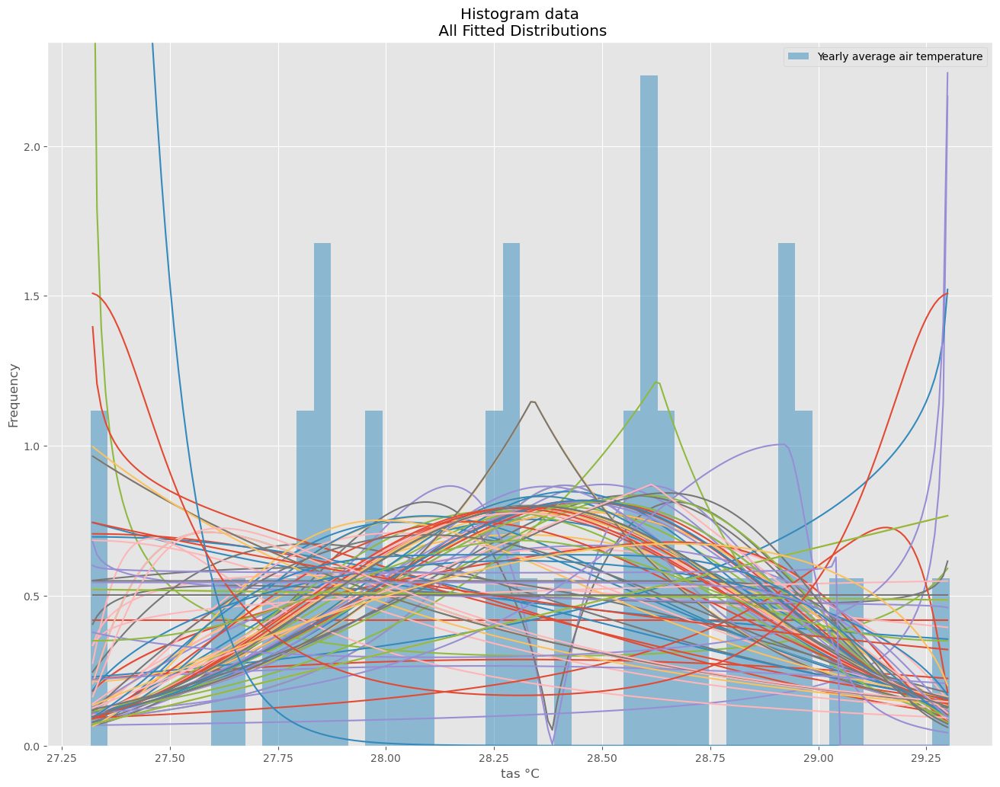

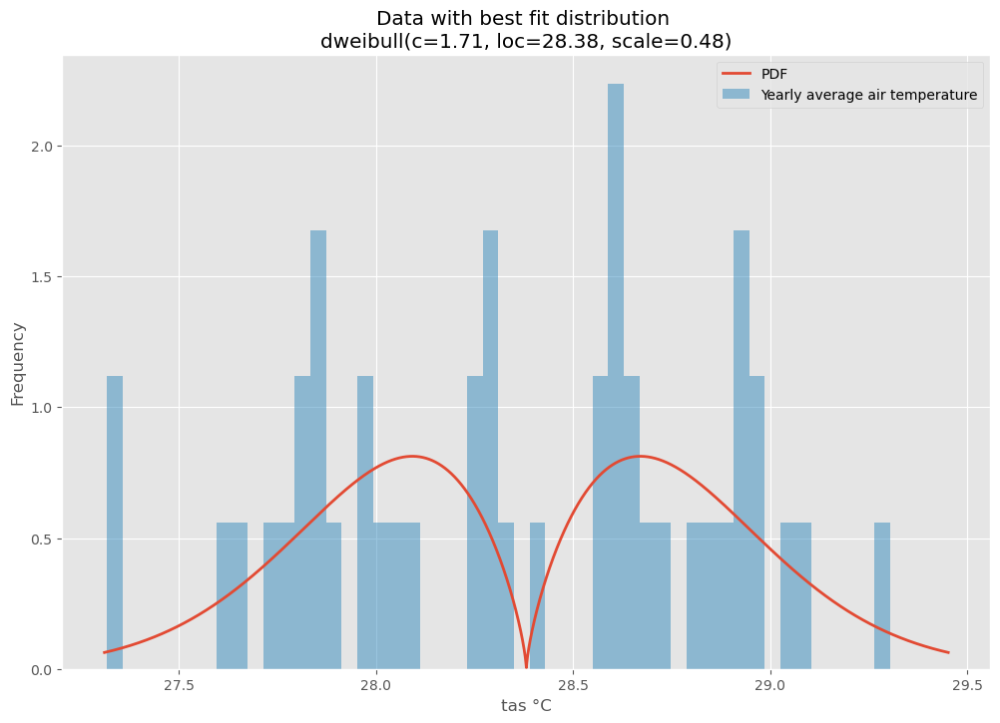

<Figure size 1200x800 with 0 Axes>

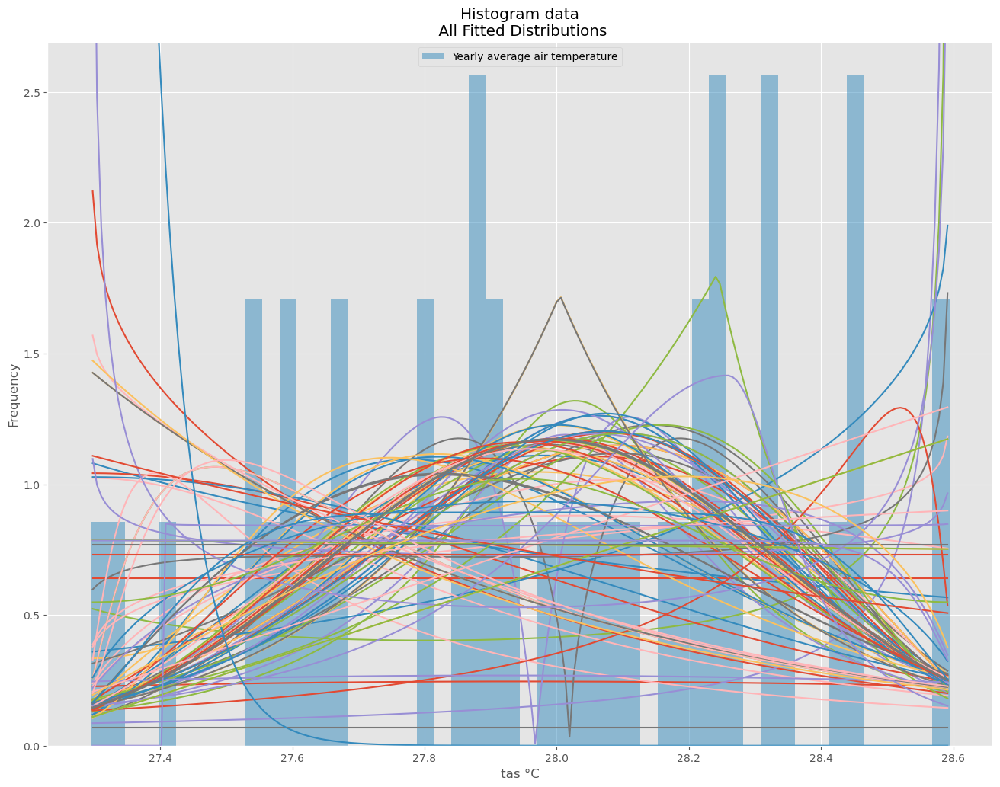

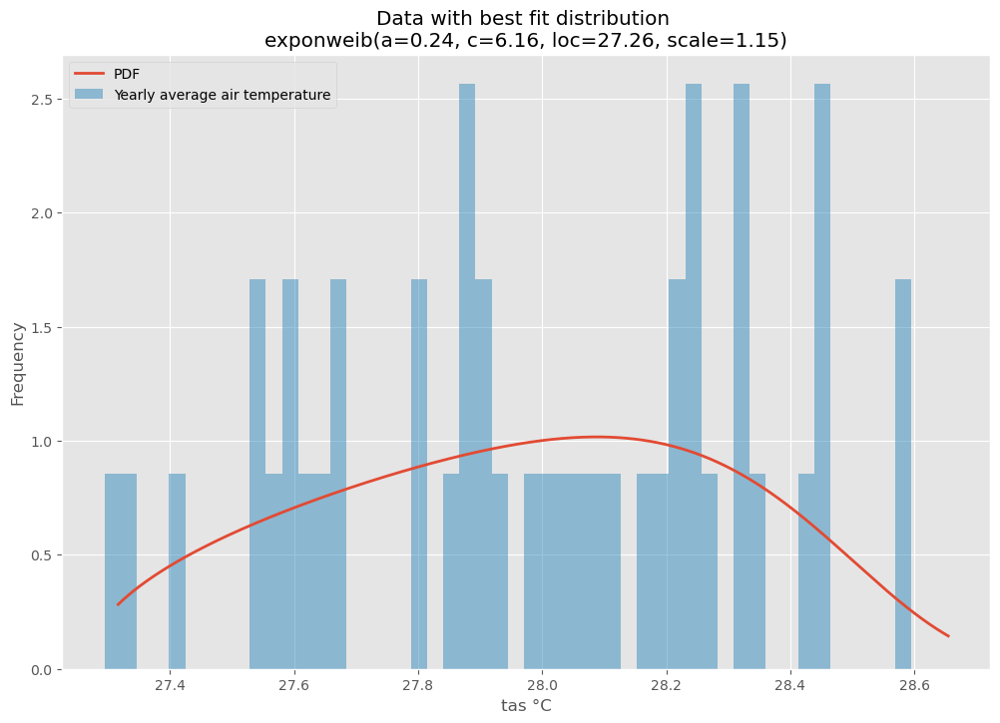

<Figure size 1200x800 with 0 Axes>

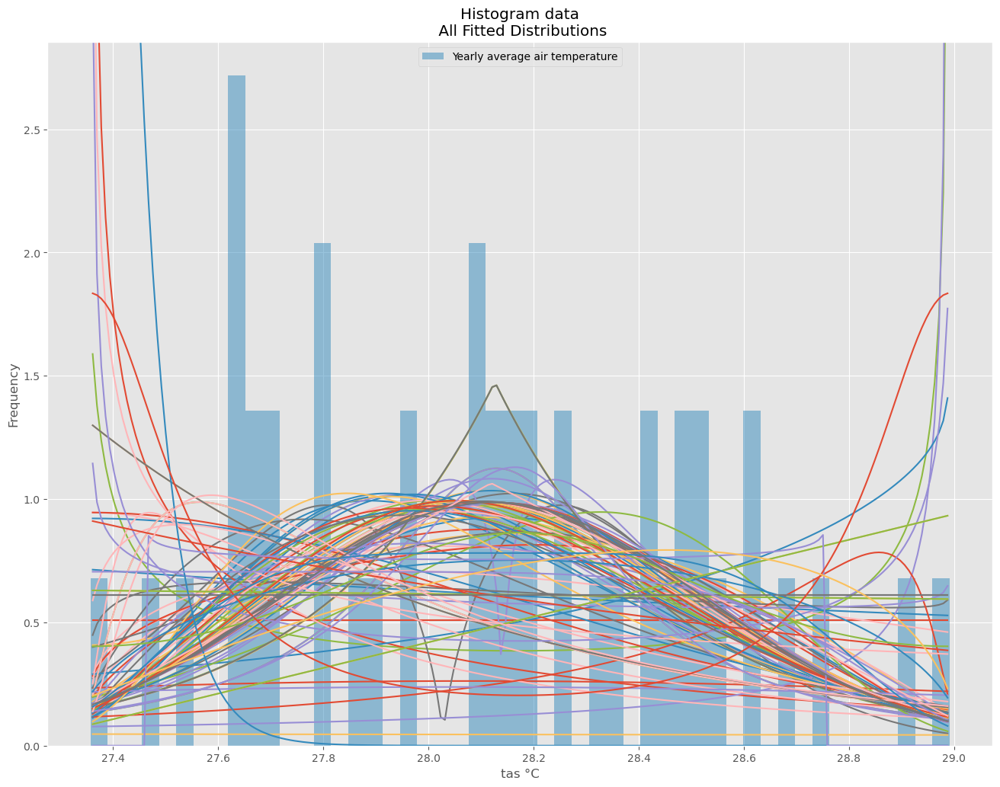

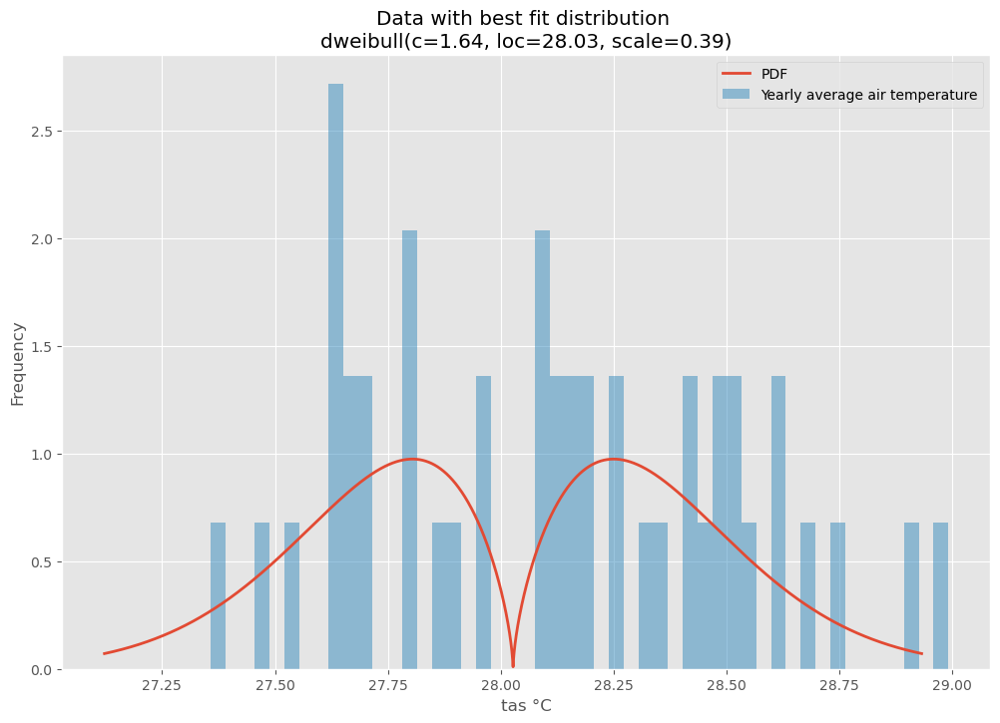

<Figure size 1200x800 with 0 Axes>

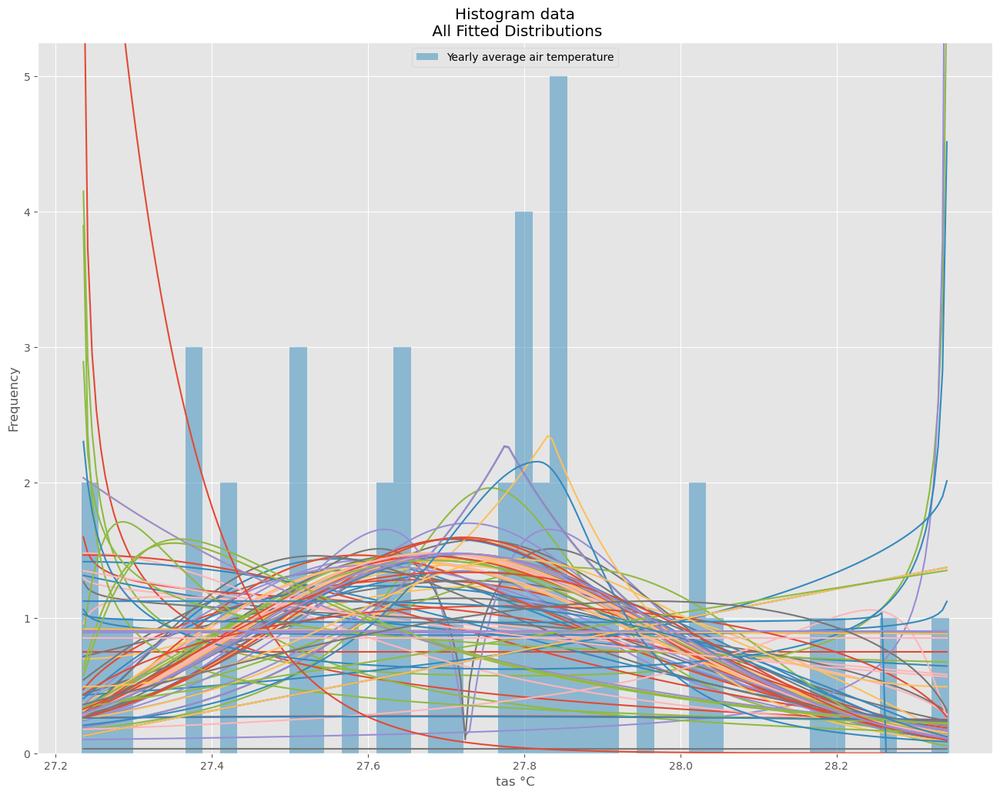

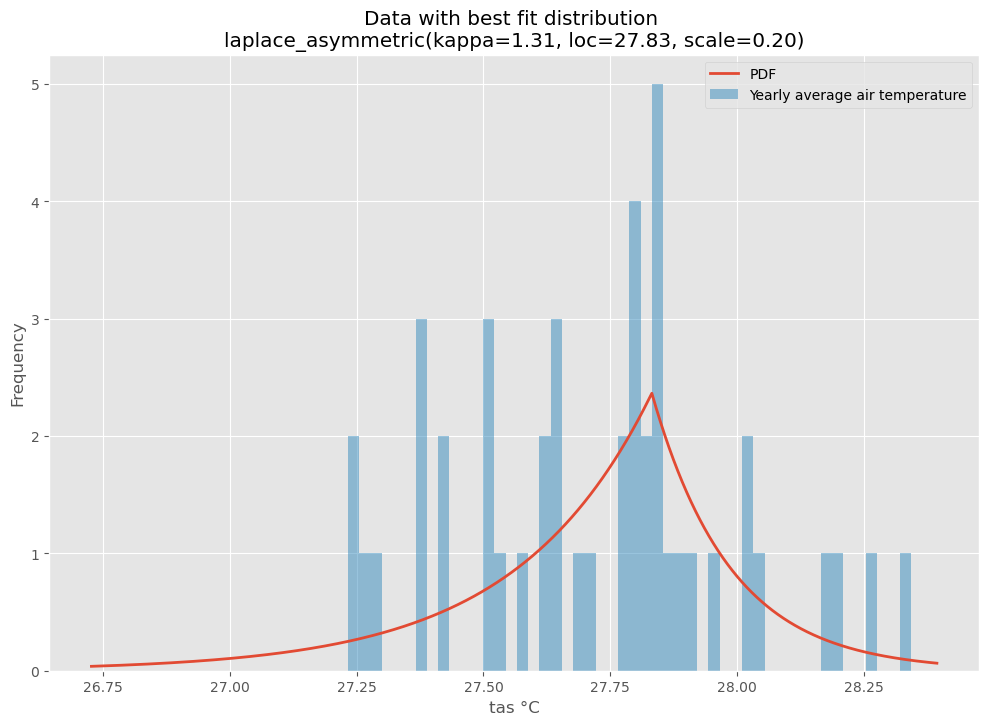

<Figure size 1200x800 with 0 Axes>

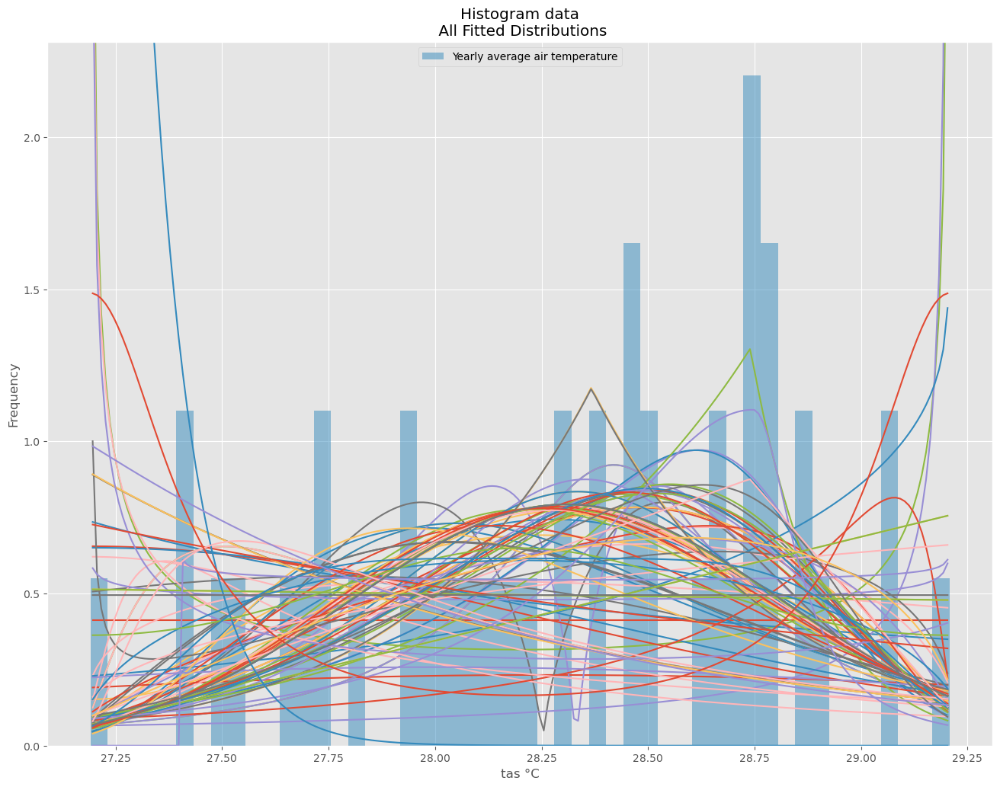

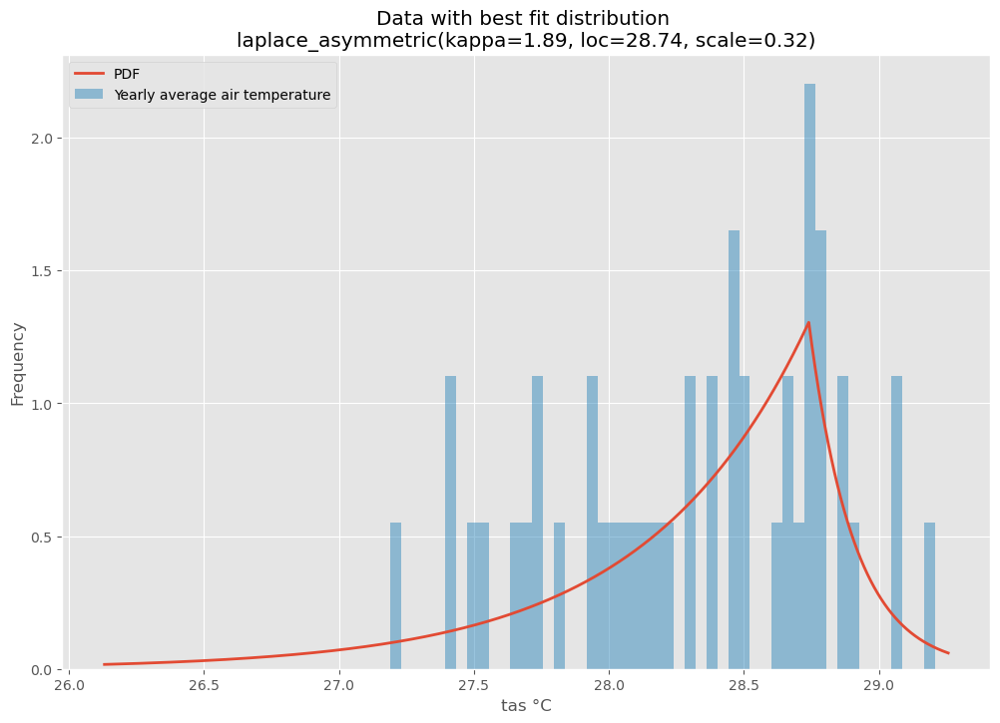

<Figure size 1200x800 with 0 Axes>

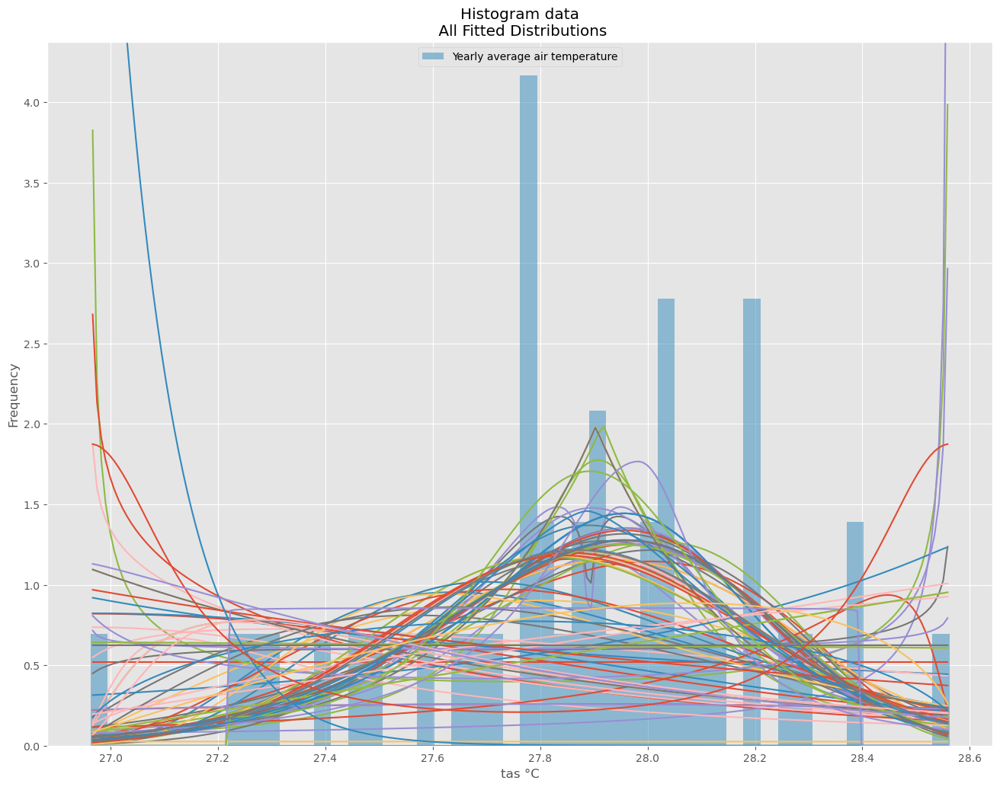

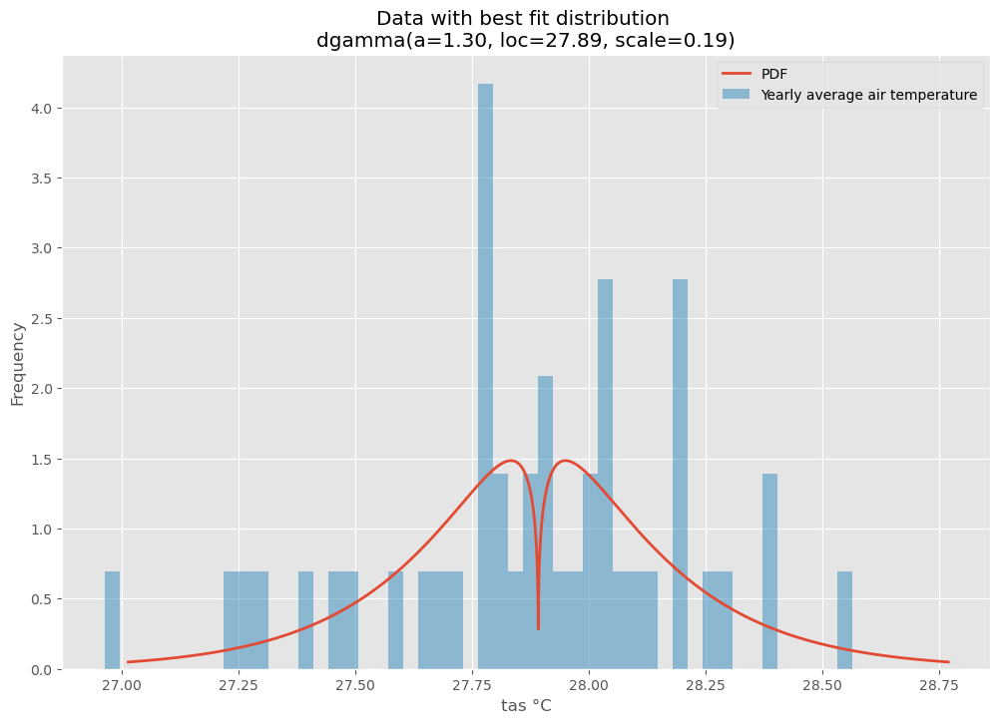

<Figure size 1200x800 with 0 Axes>

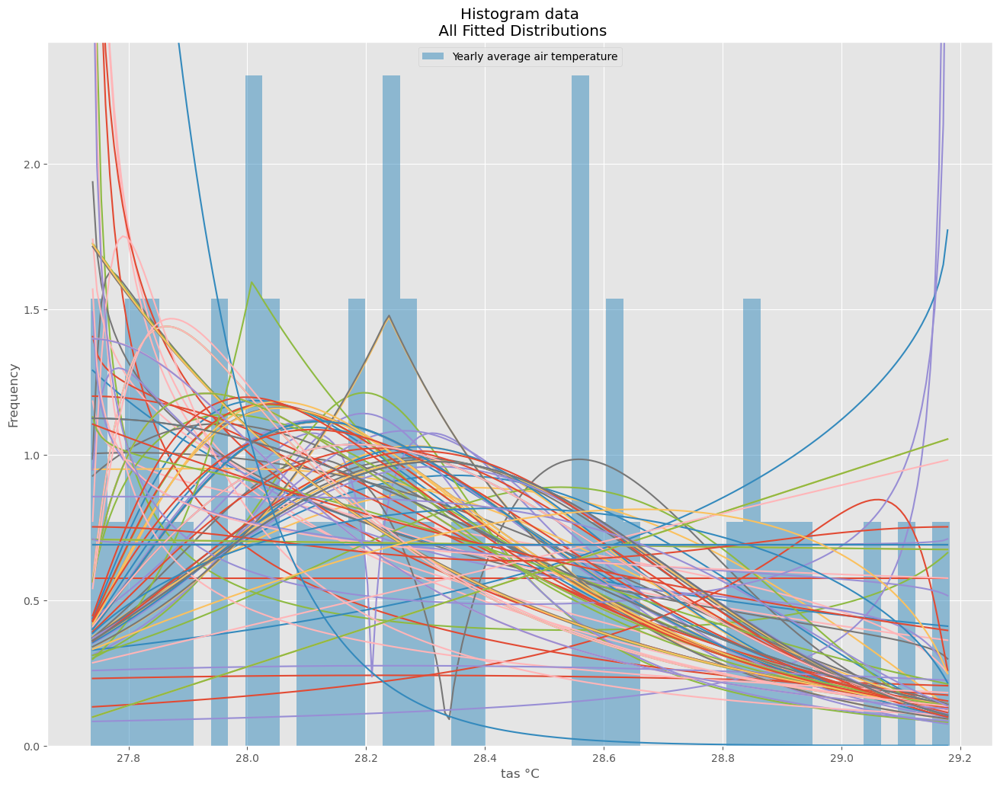

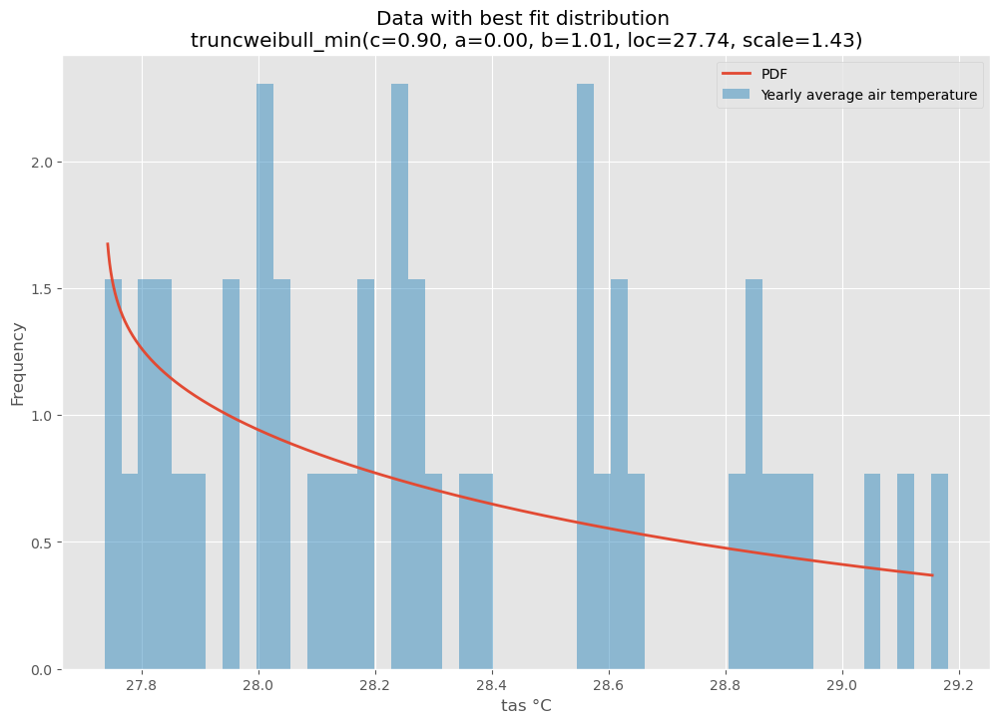

<Figure size 1200x800 with 0 Axes>

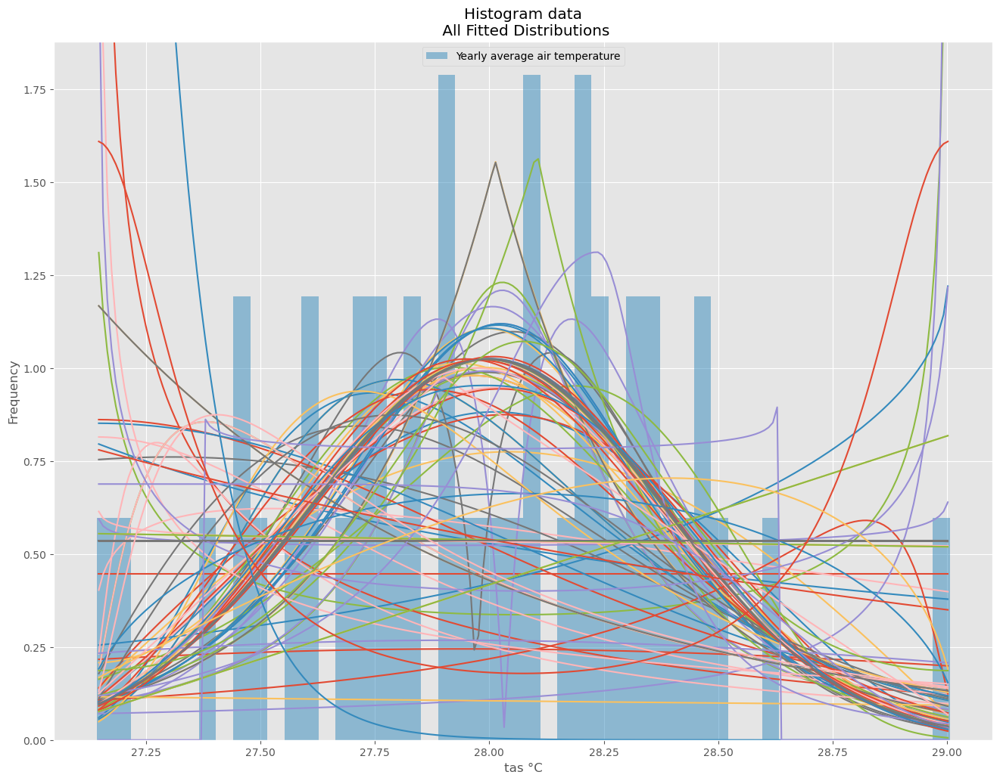

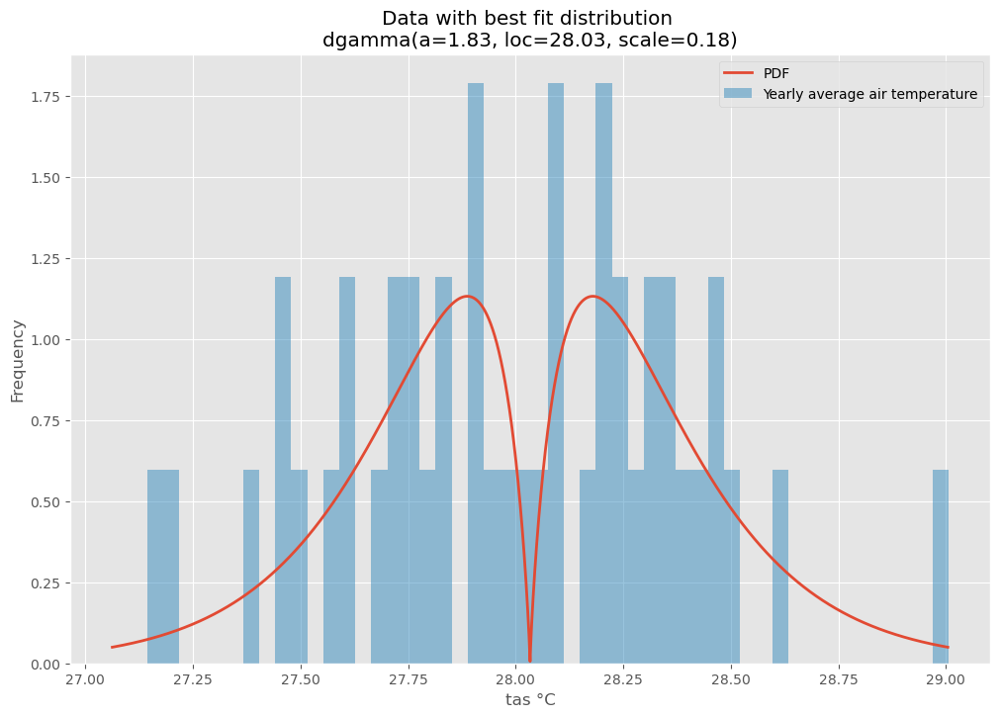

<Figure size 1200x800 with 0 Axes>

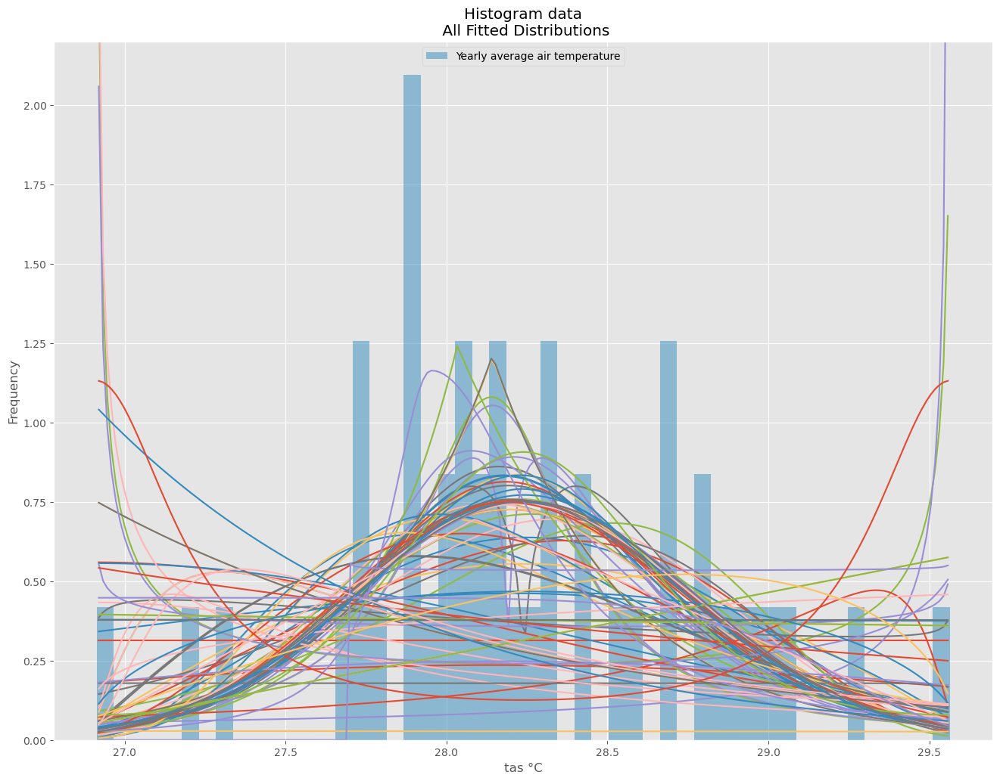

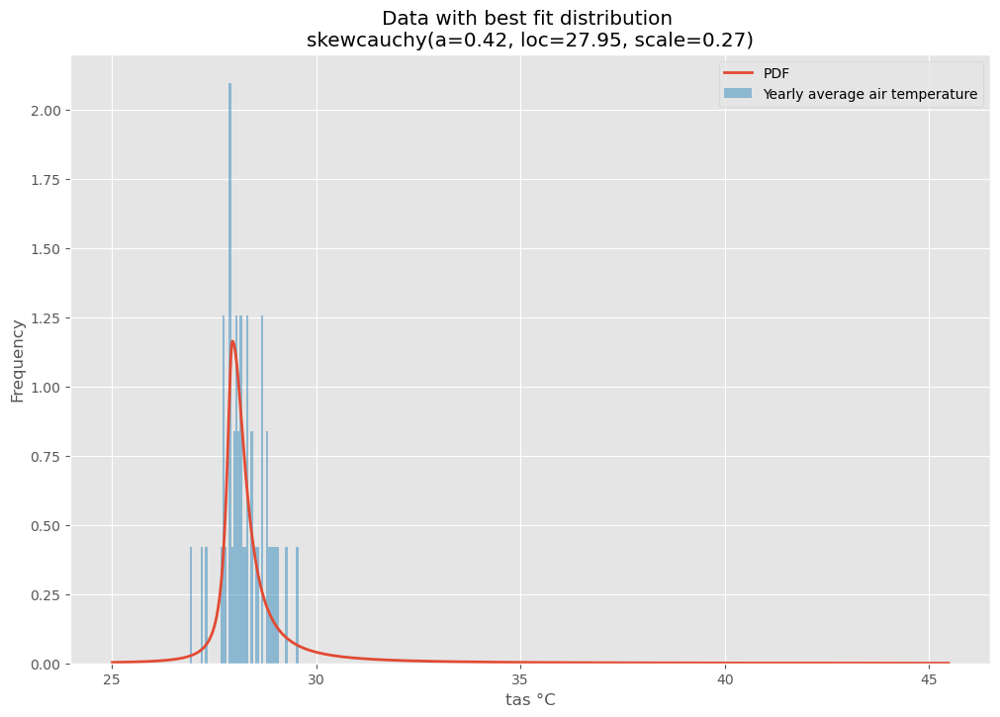

<Figure size 1200x800 with 0 Axes>

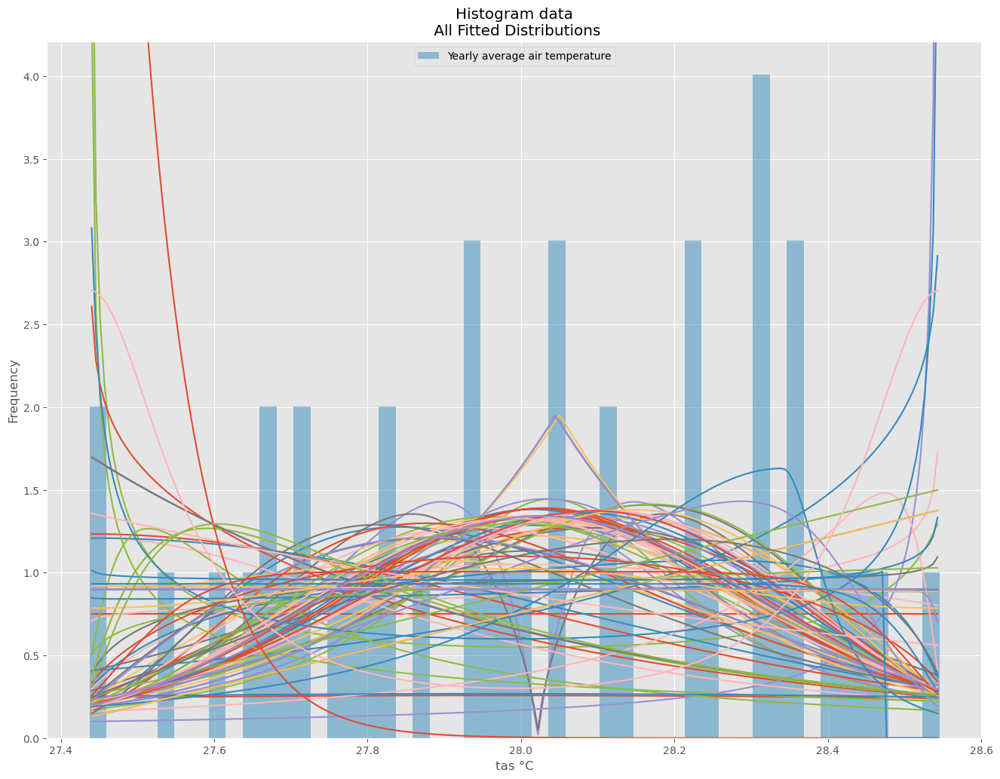

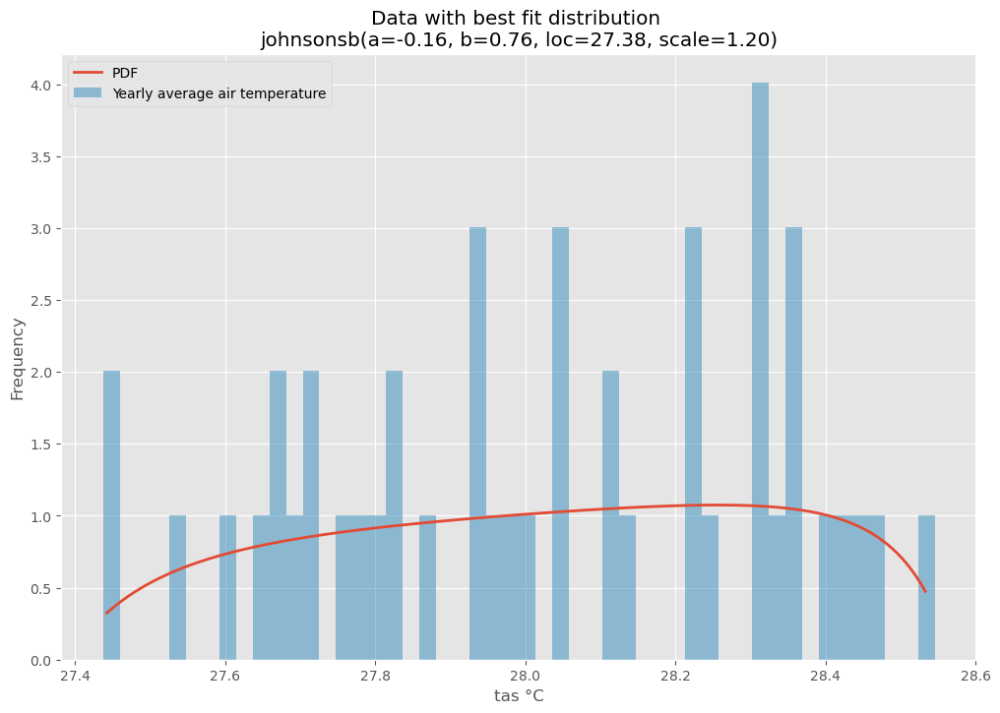

<Figure size 1200x800 with 0 Axes>

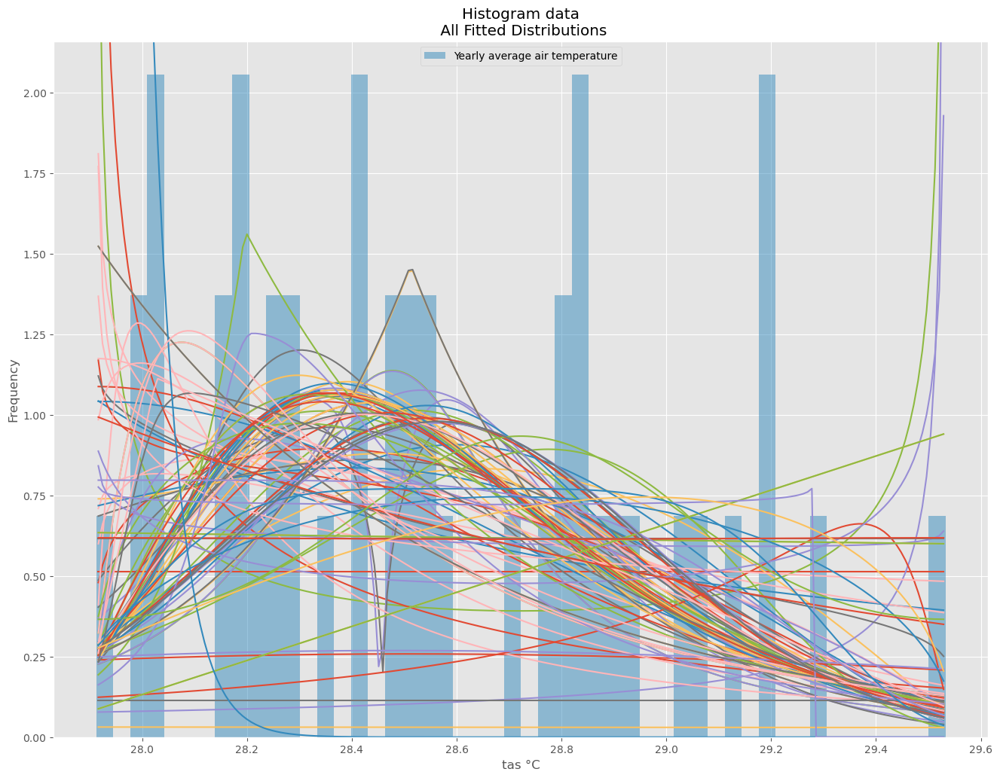

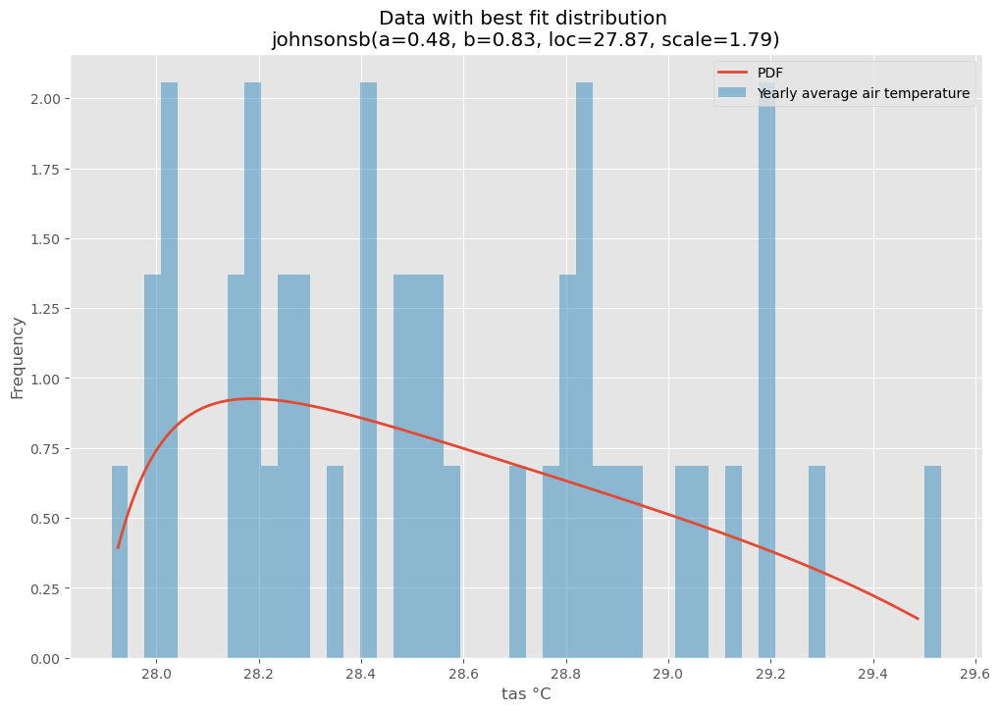

<Figure size 1200x800 with 0 Axes>

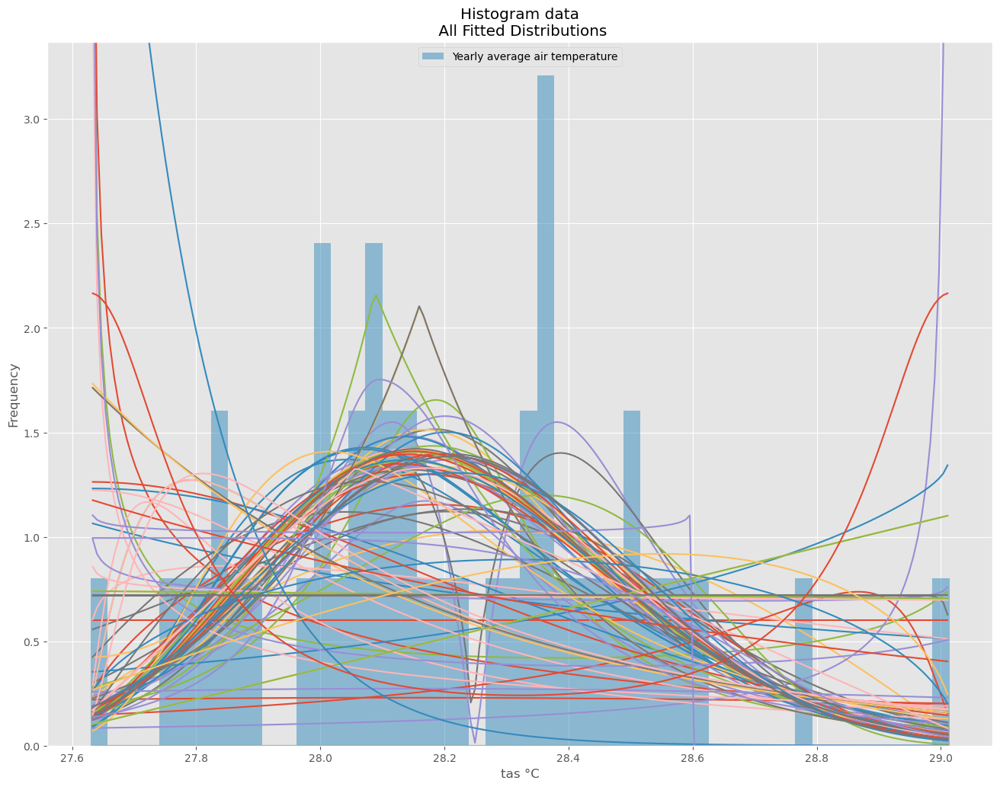

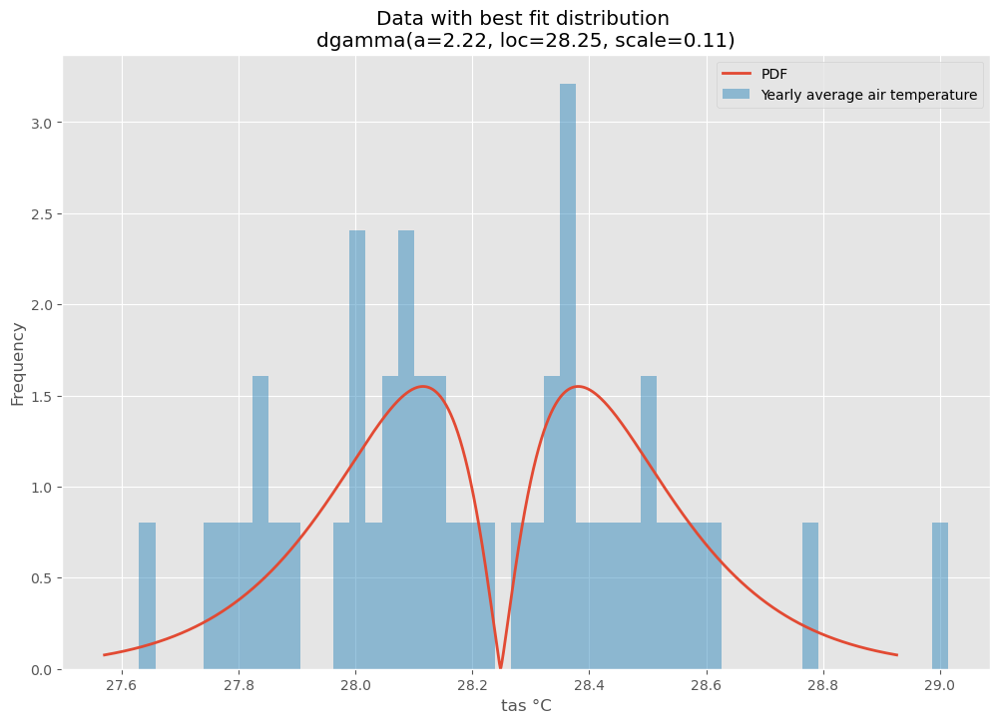

<Figure size 1200x800 with 0 Axes>

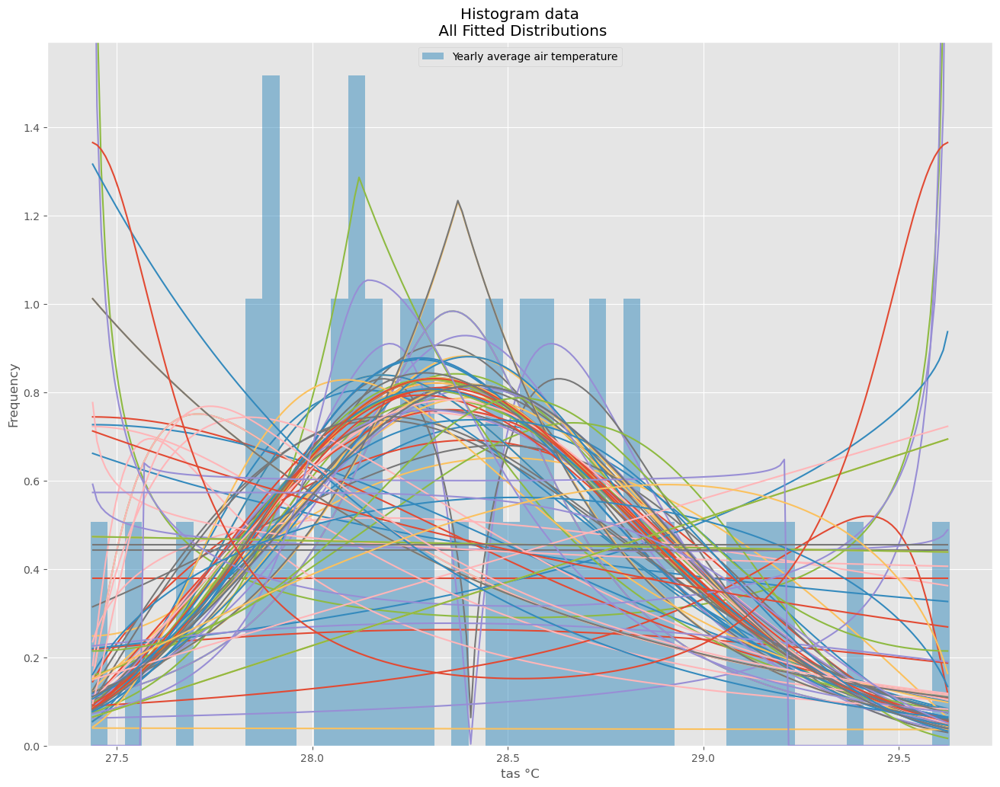

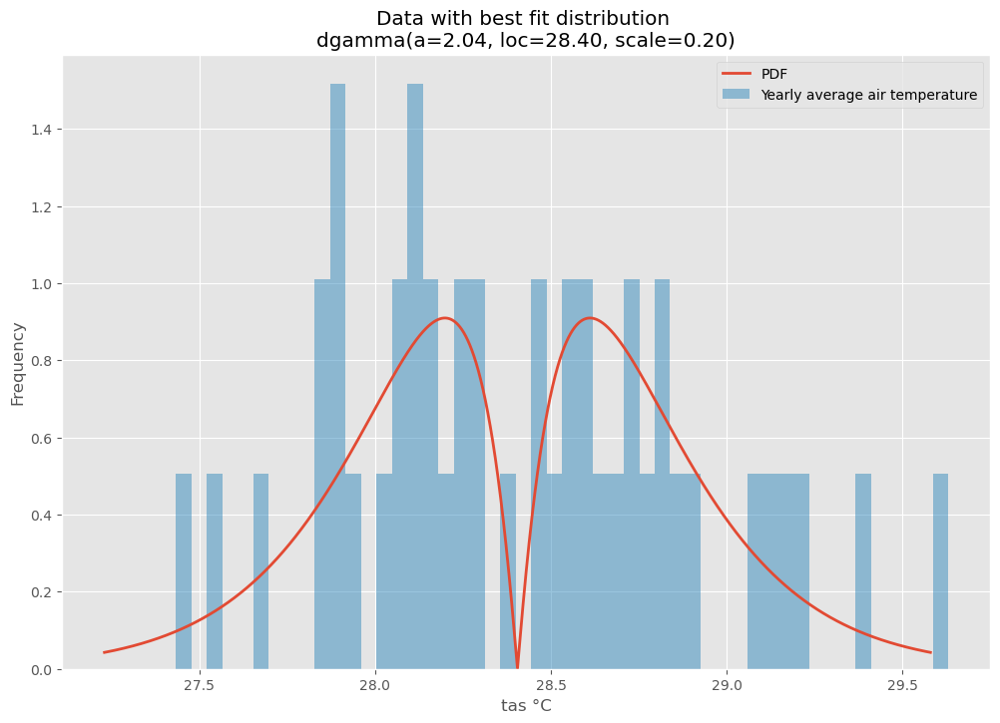

<Figure size 1200x800 with 0 Axes>

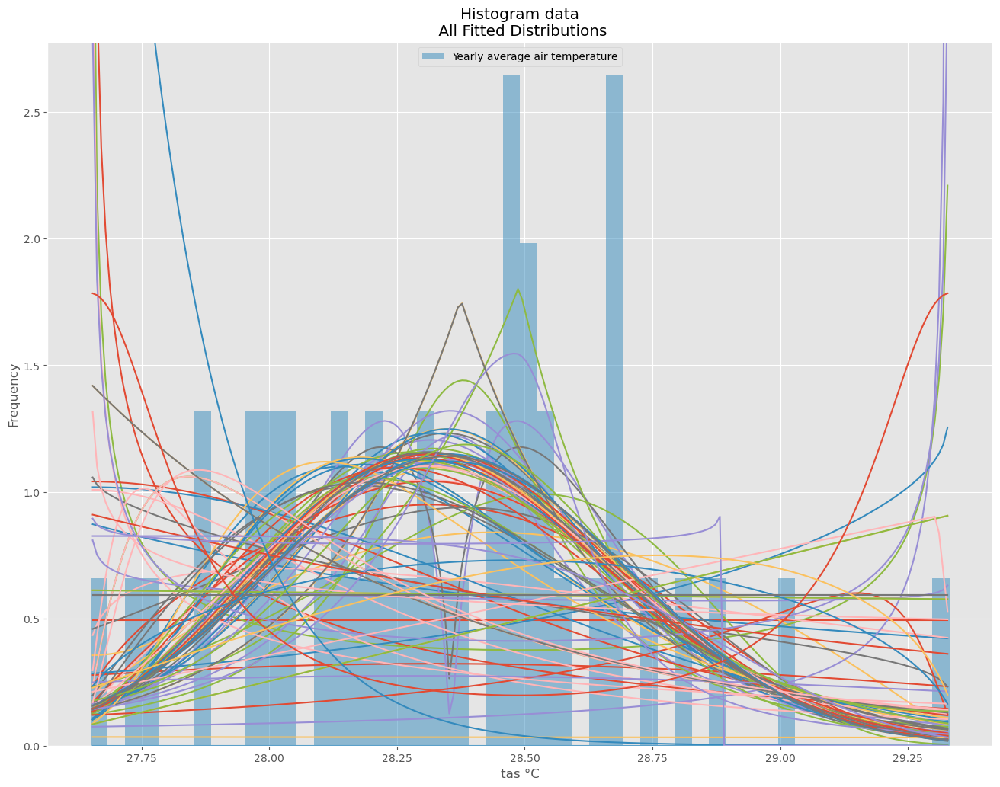

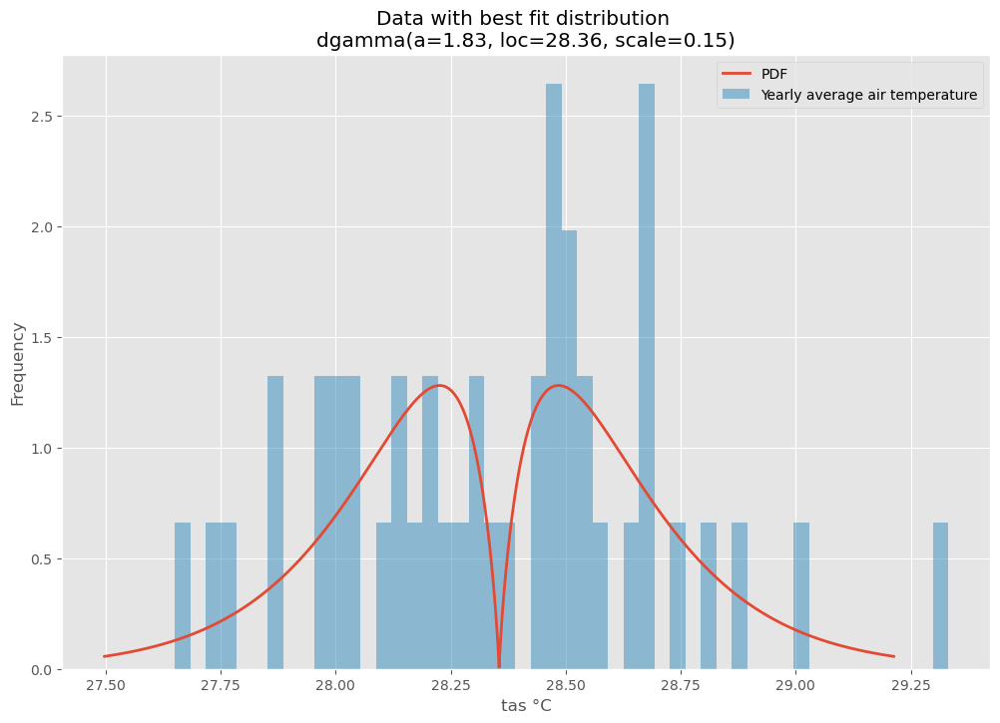

<Figure size 1200x800 with 0 Axes>

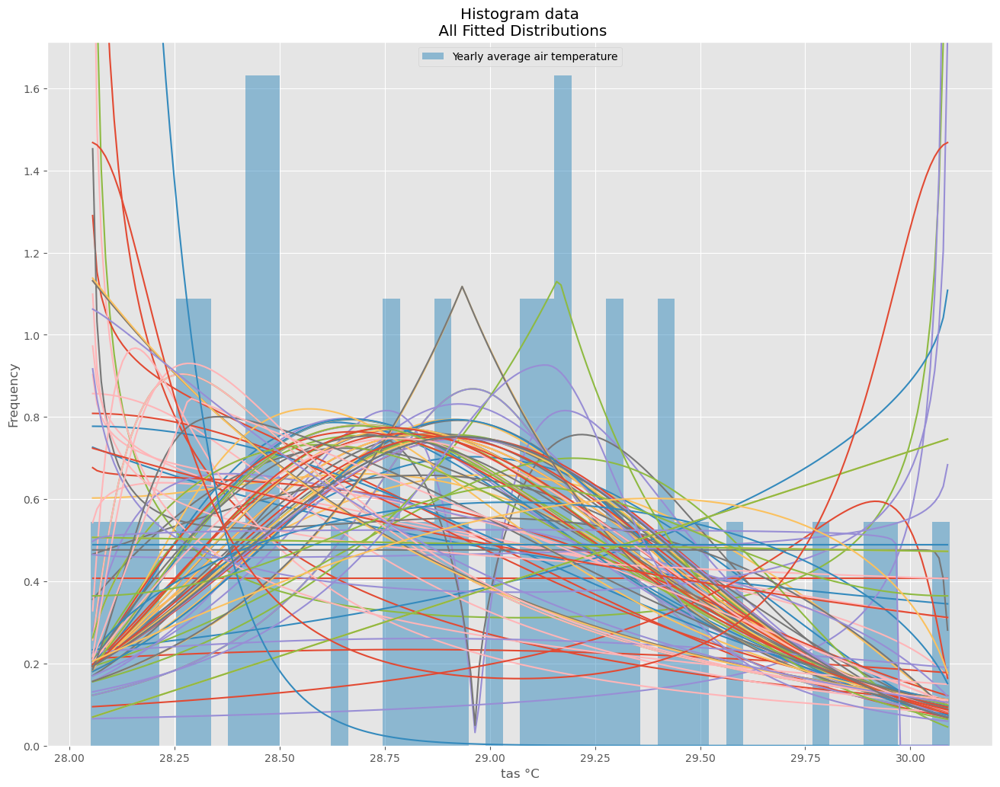

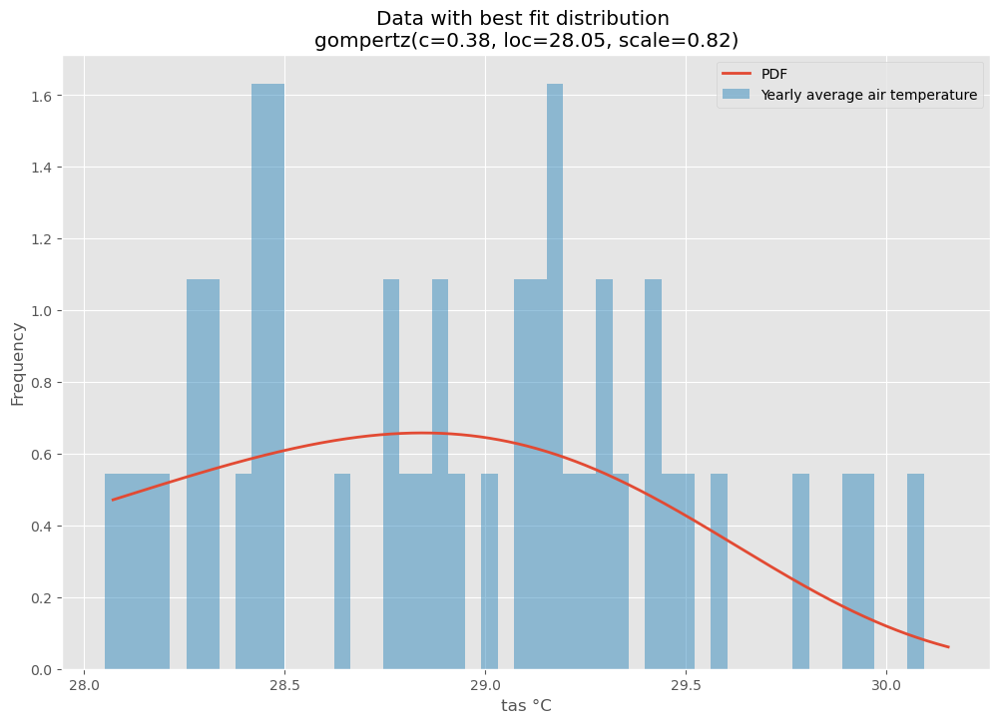

<Figure size 1200x800 with 0 Axes>

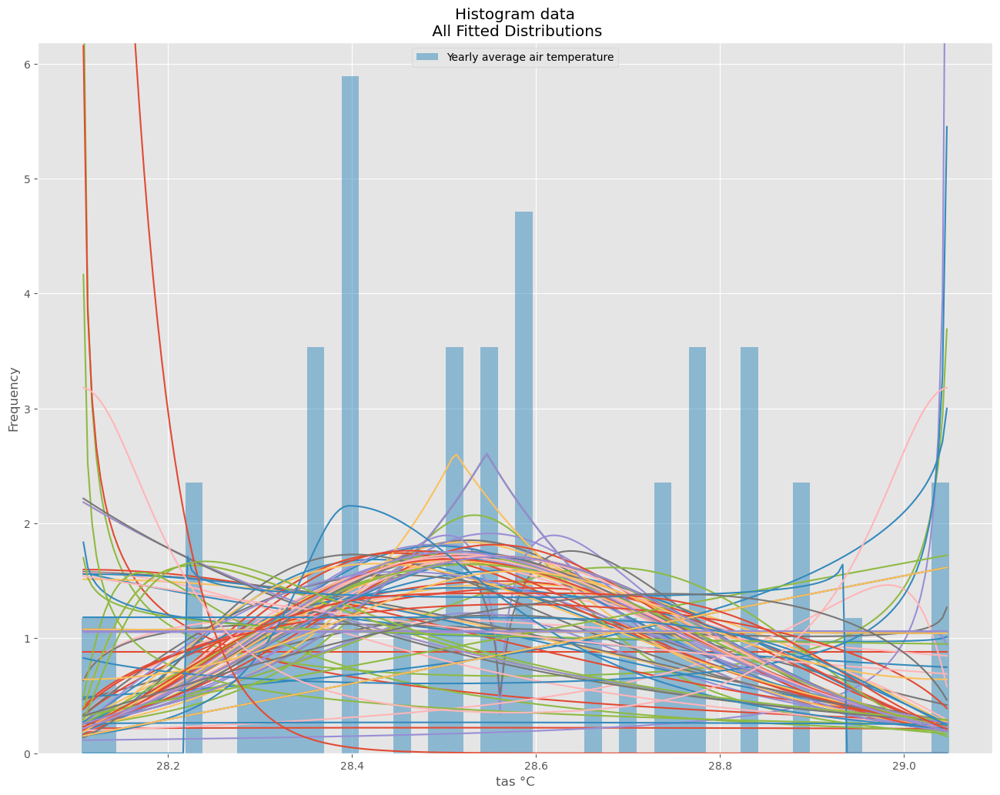

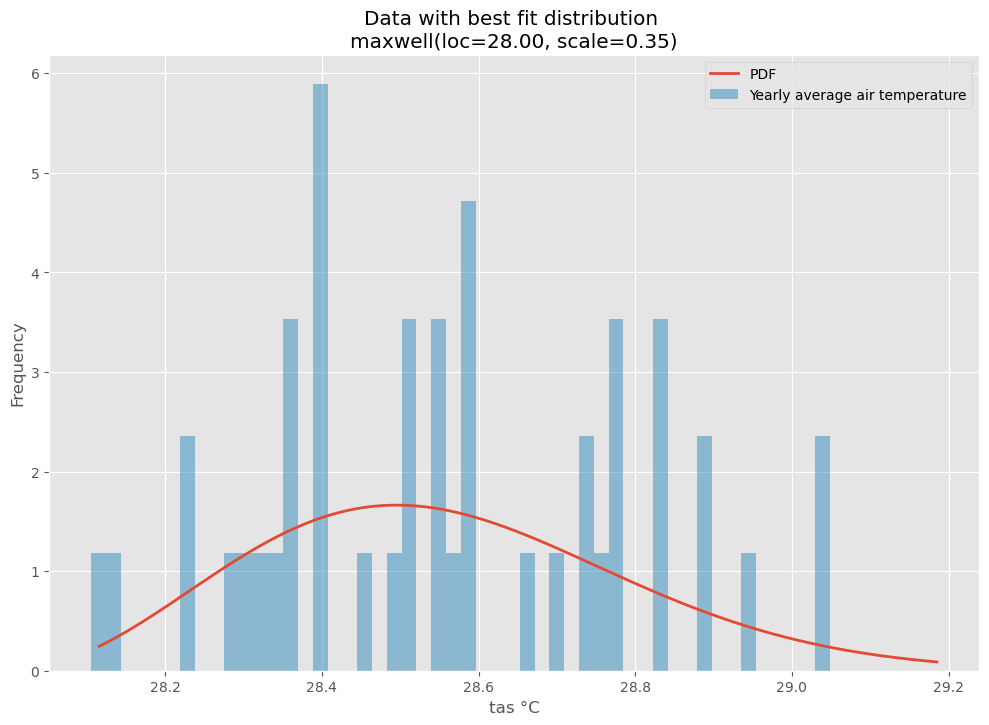

<Figure size 1200x800 with 0 Axes>

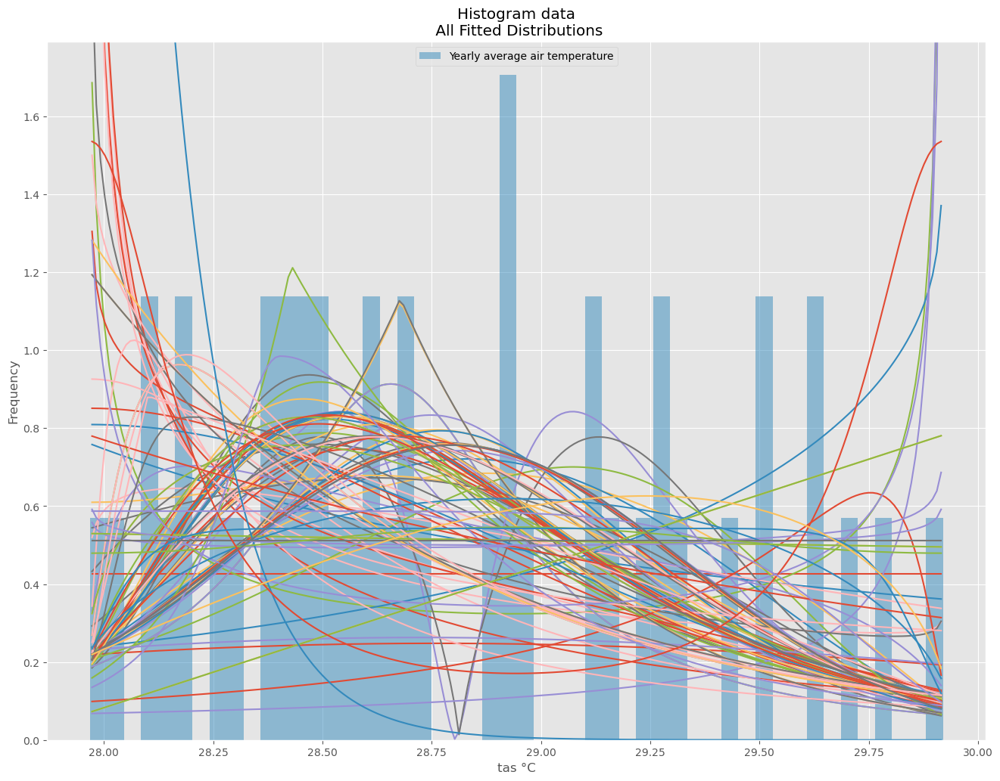

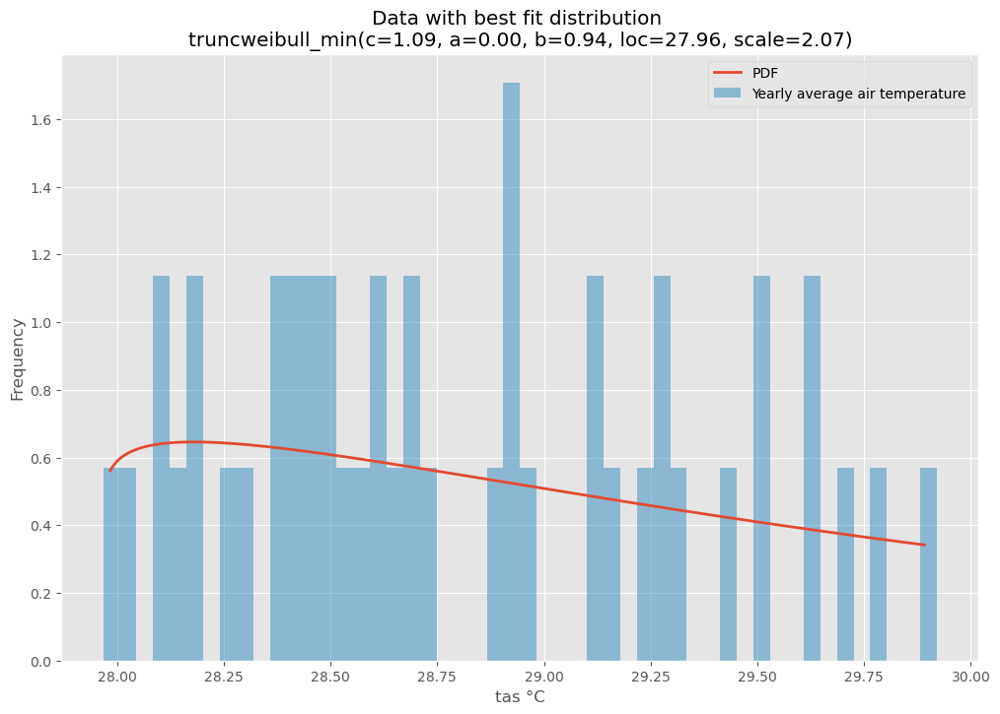

<Figure size 1200x800 with 0 Axes>

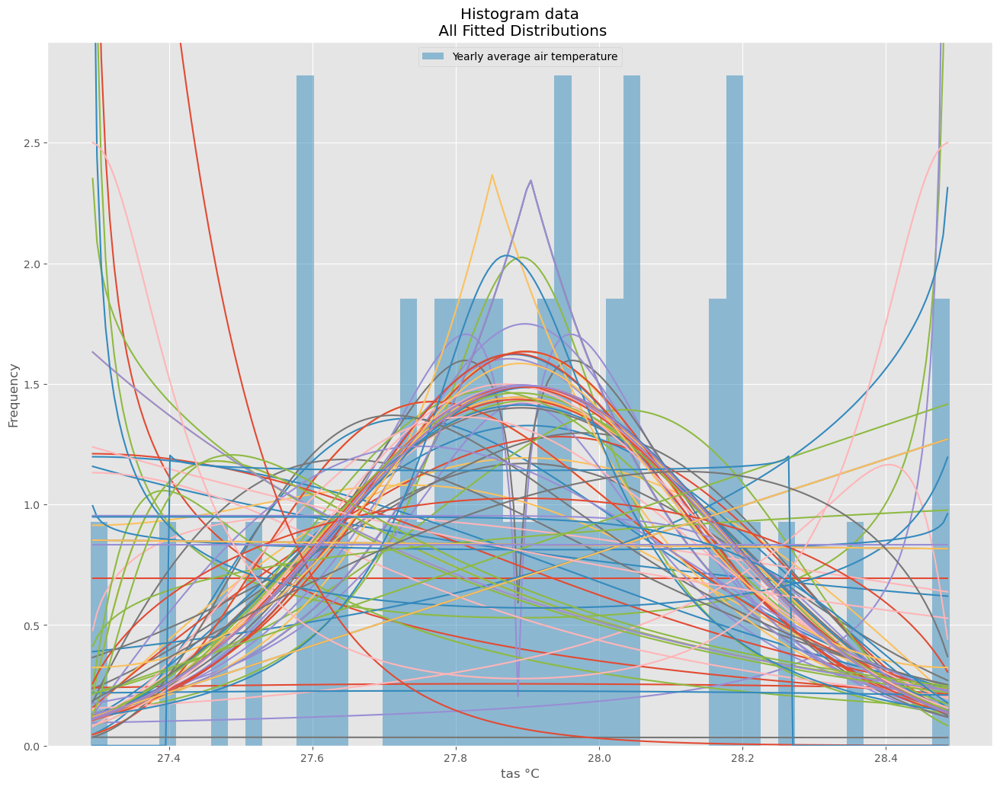

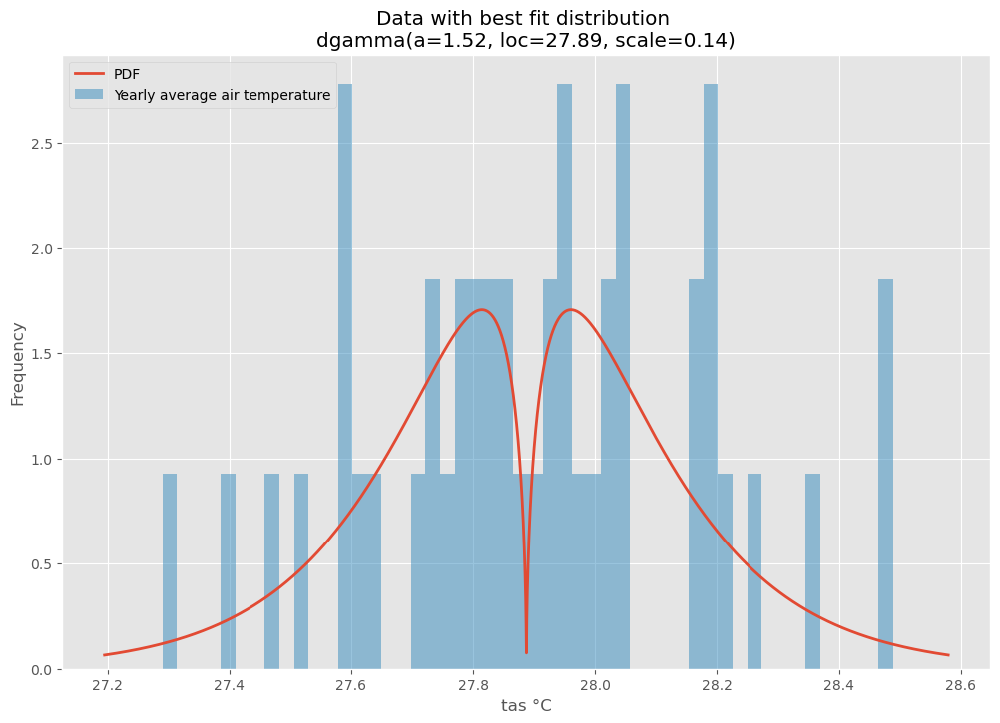

<Figure size 1200x800 with 0 Axes>

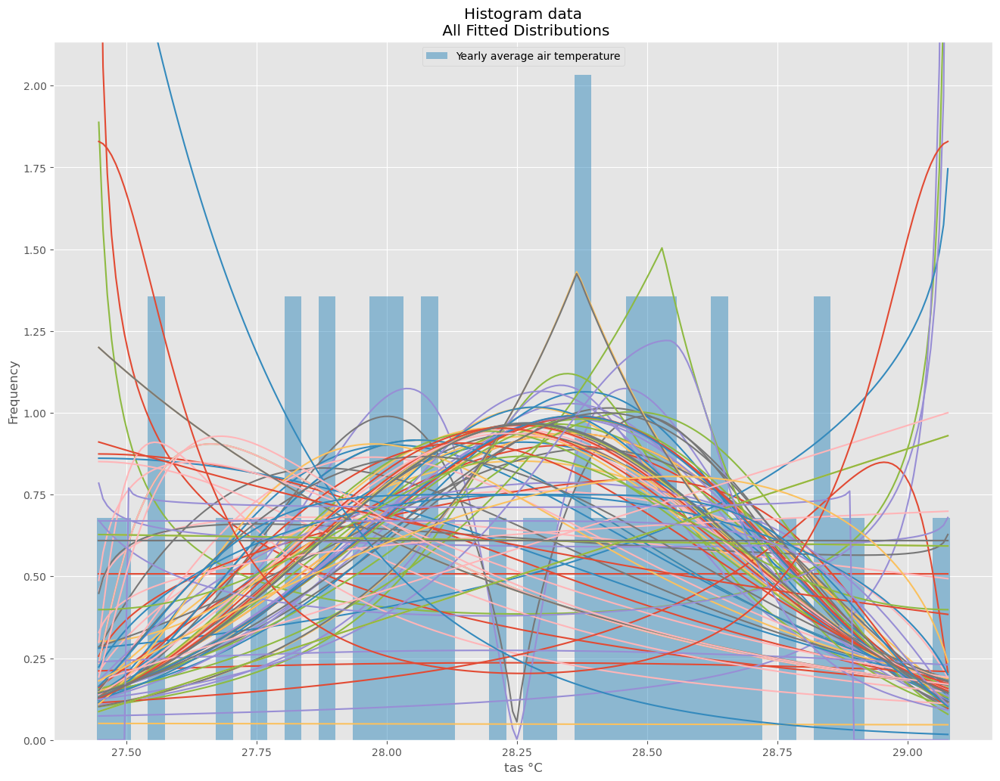

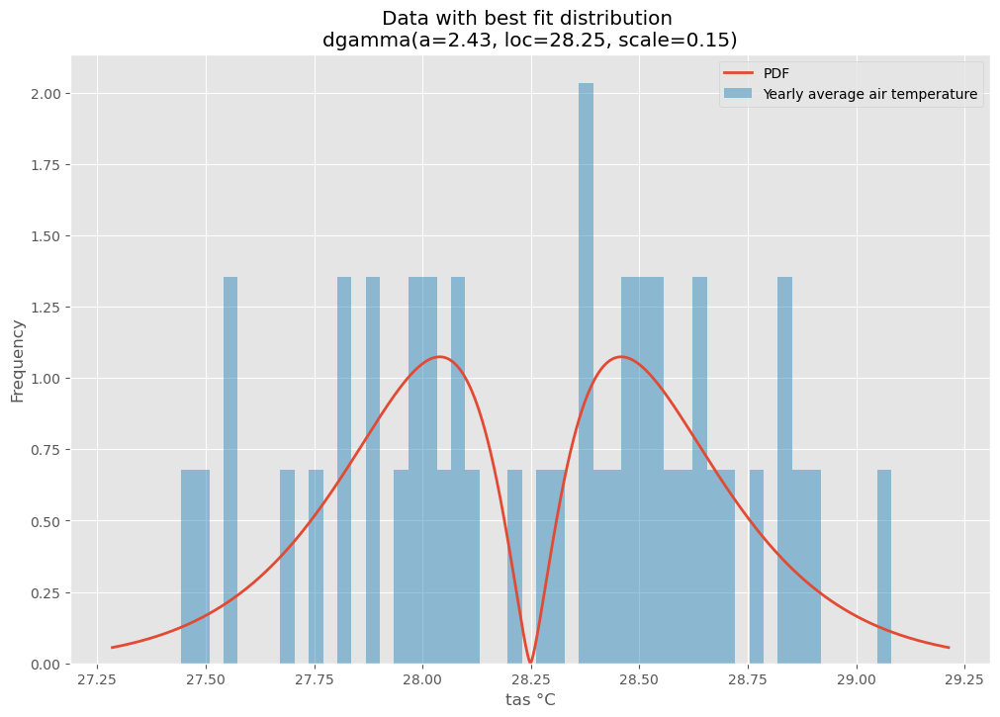

<Figure size 1200x800 with 0 Axes>

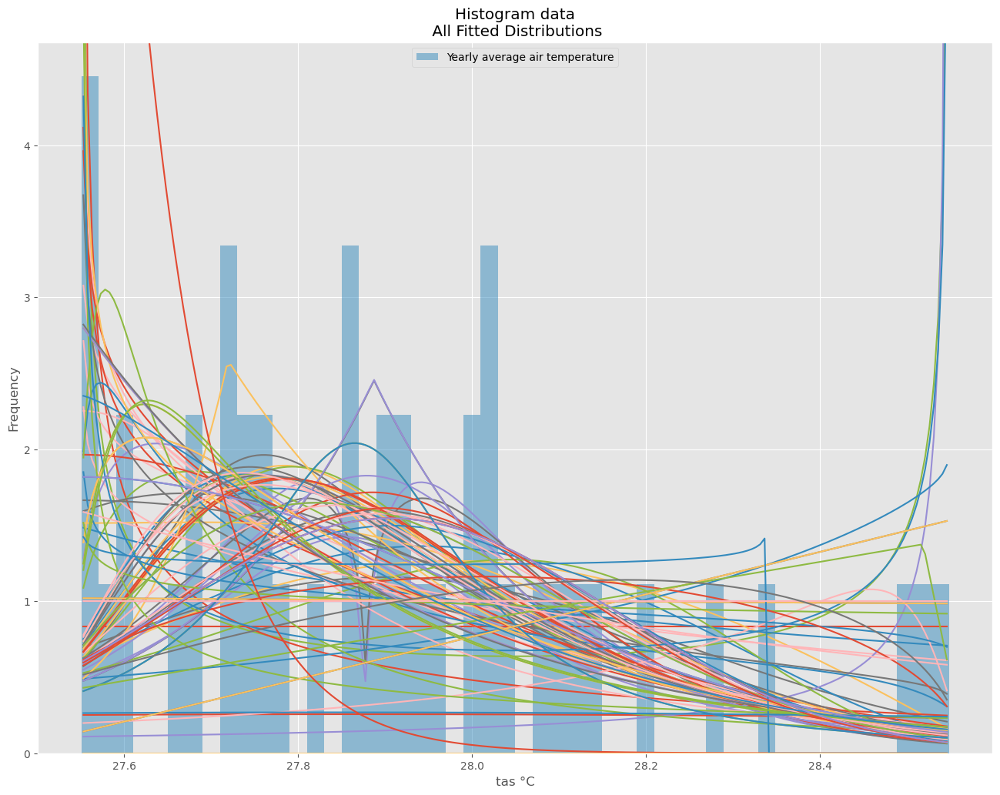

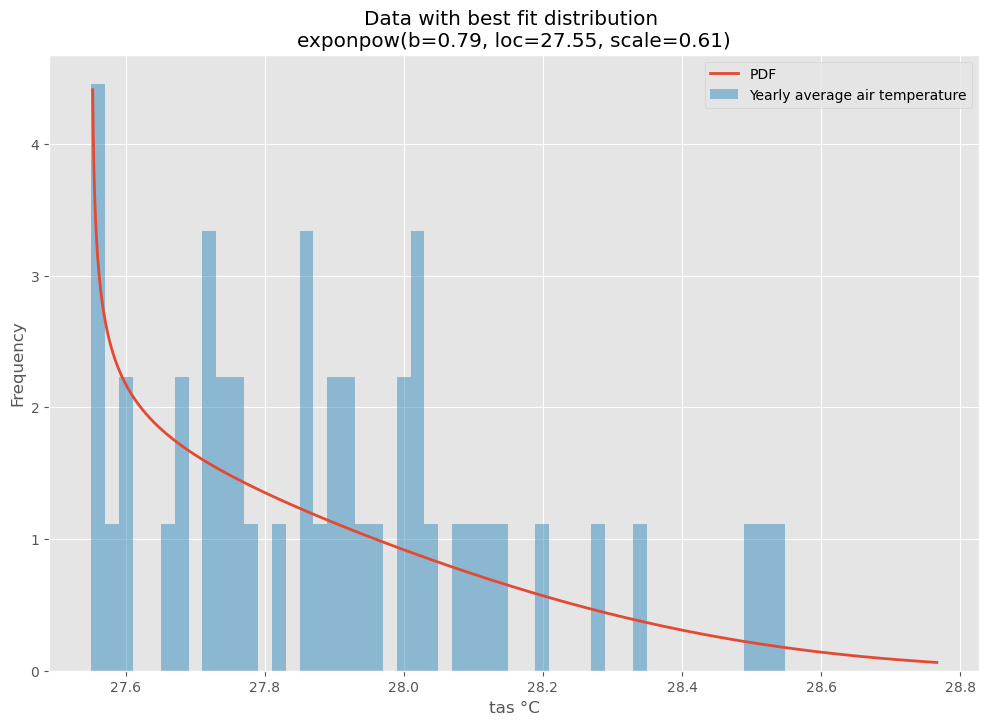

<Figure size 1200x800 with 0 Axes>

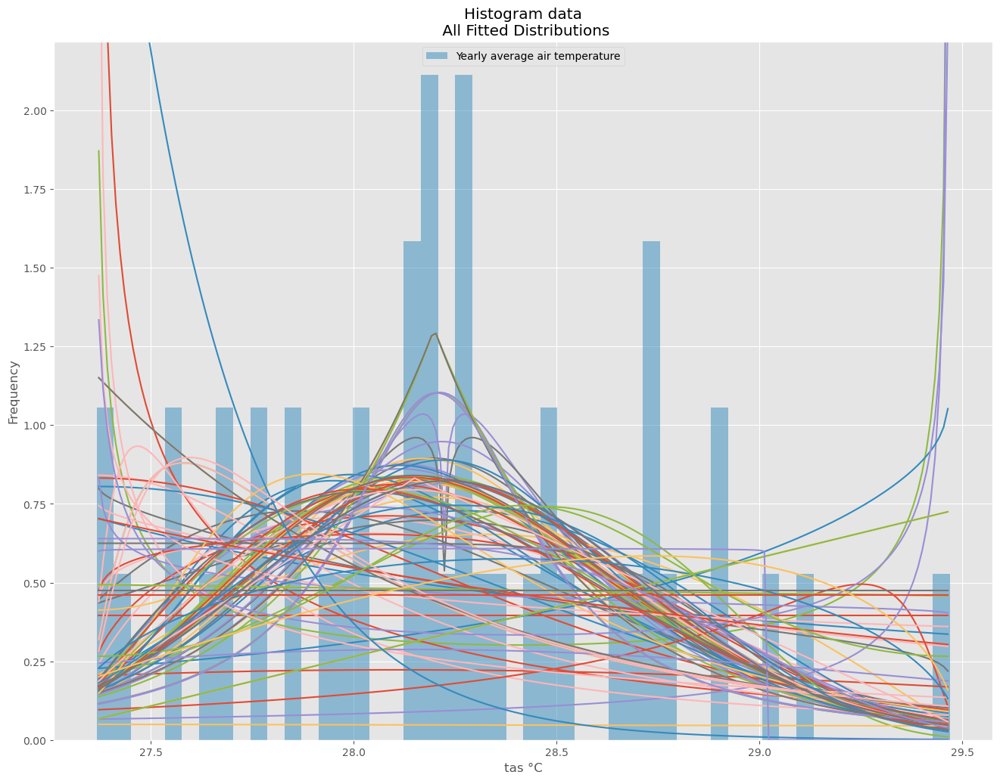

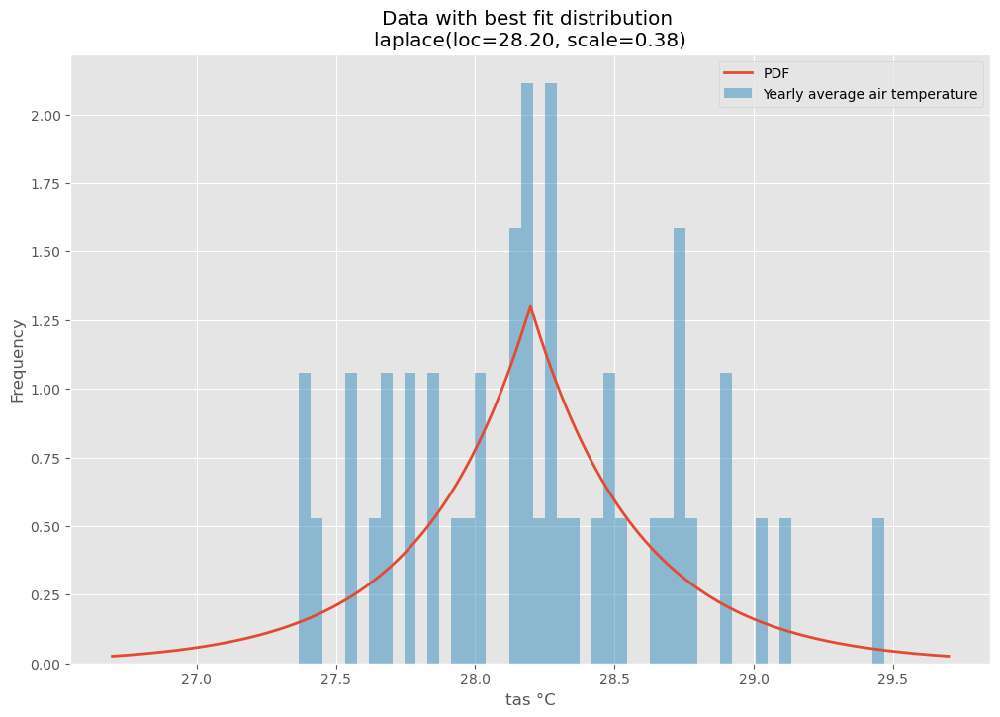

<Figure size 1200x800 with 0 Axes>

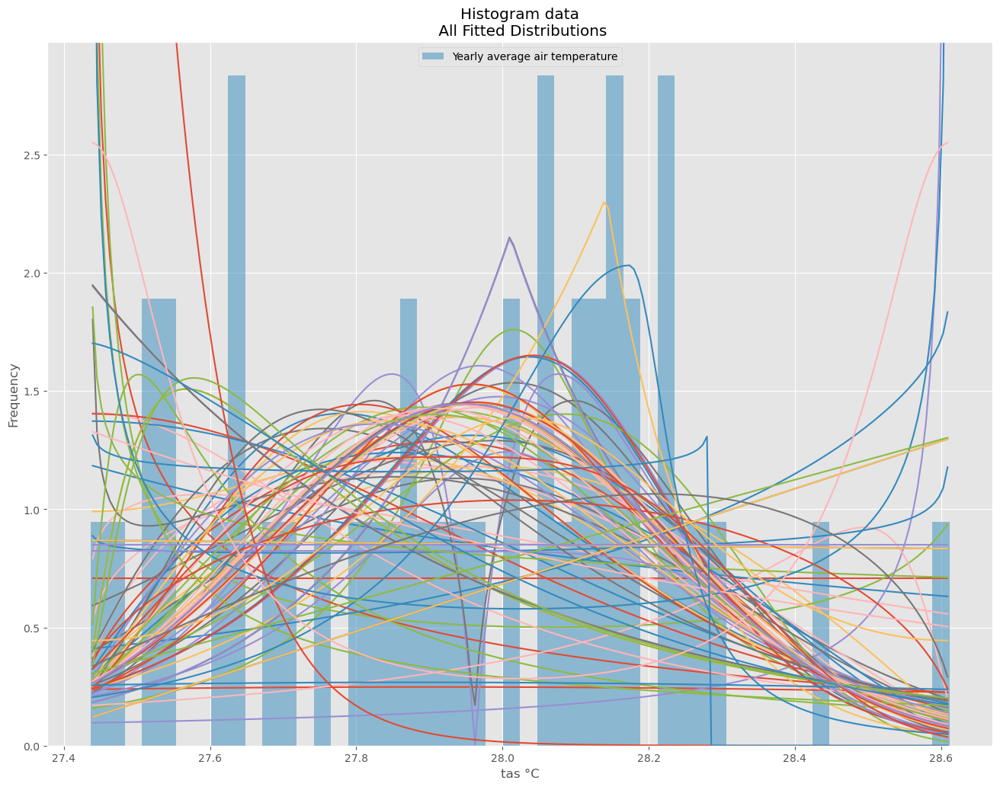

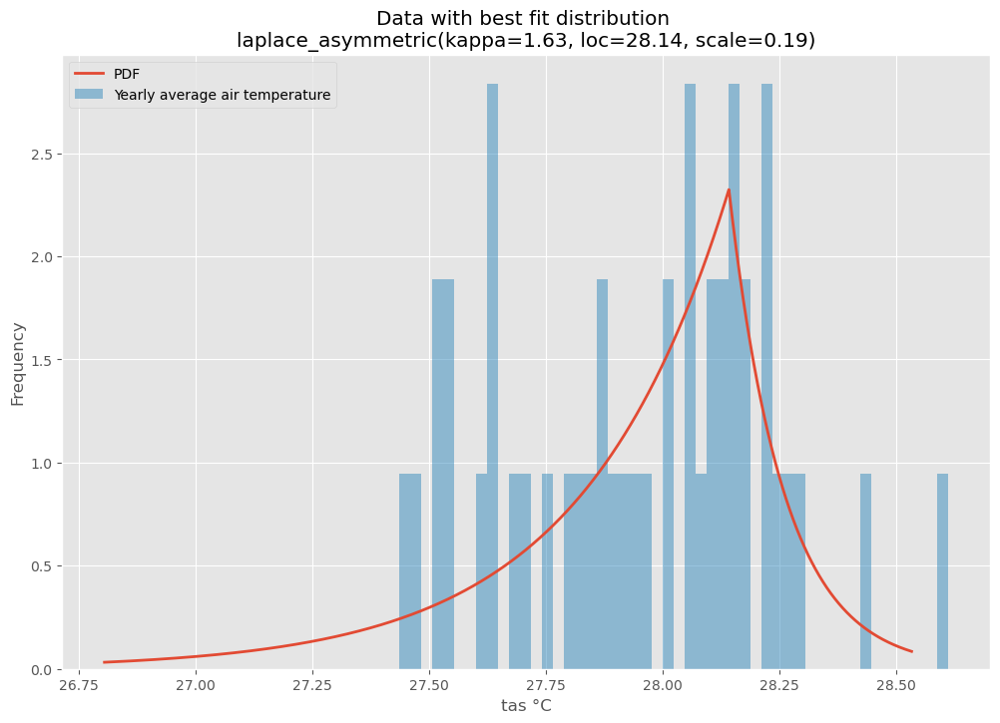

<Figure size 1200x800 with 0 Axes>

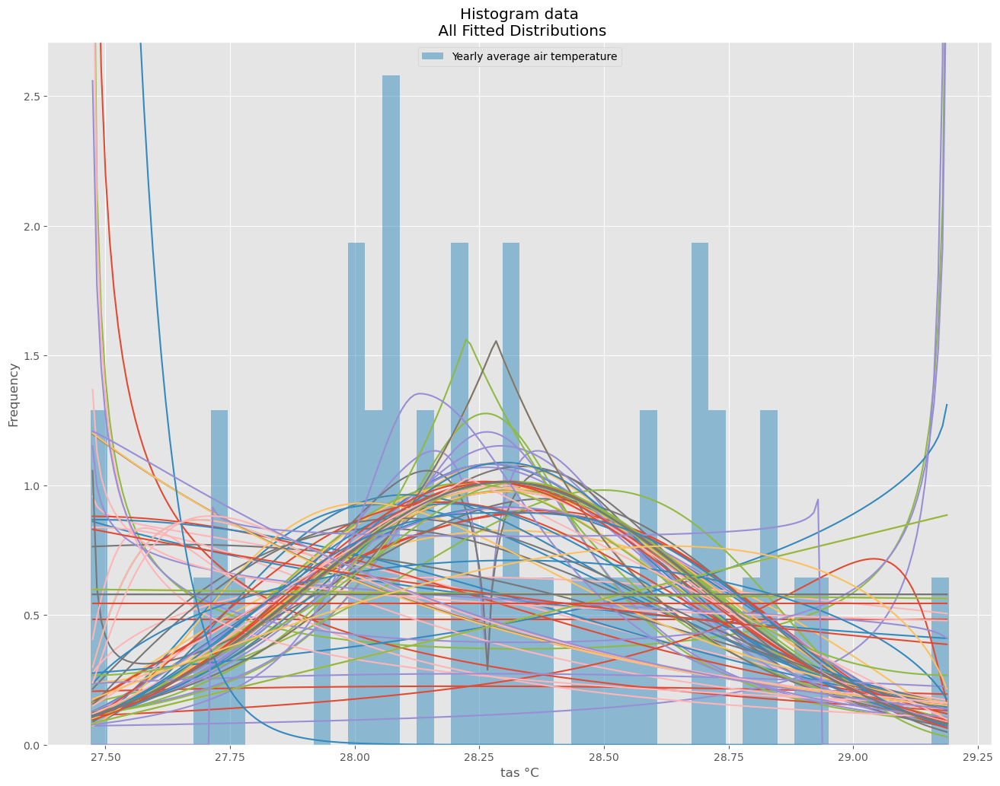

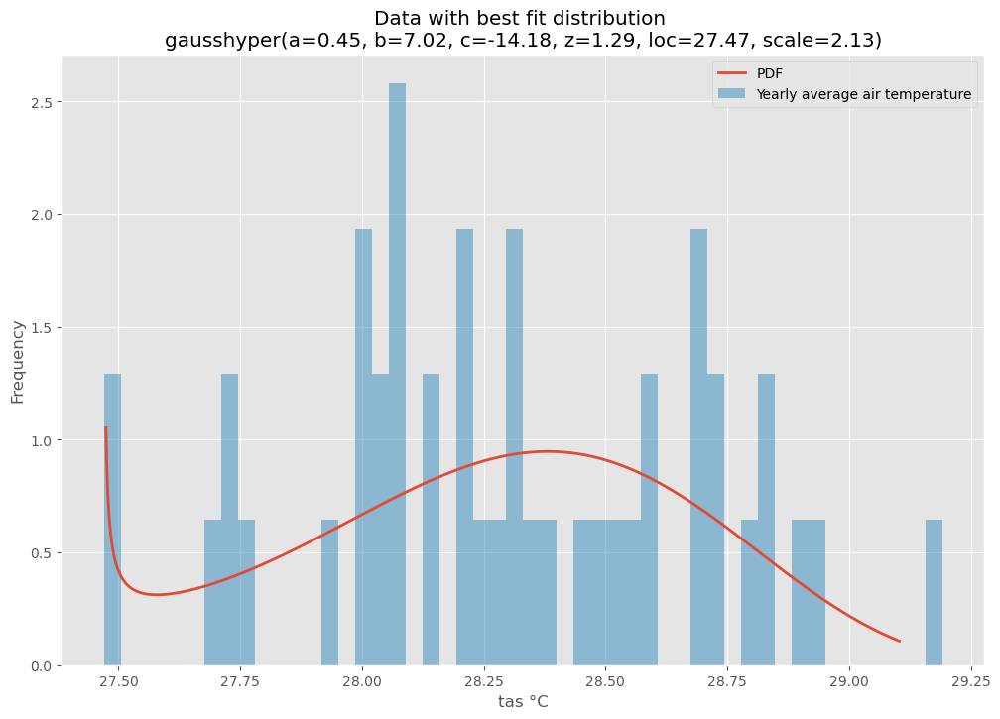

<Figure size 1200x800 with 0 Axes>

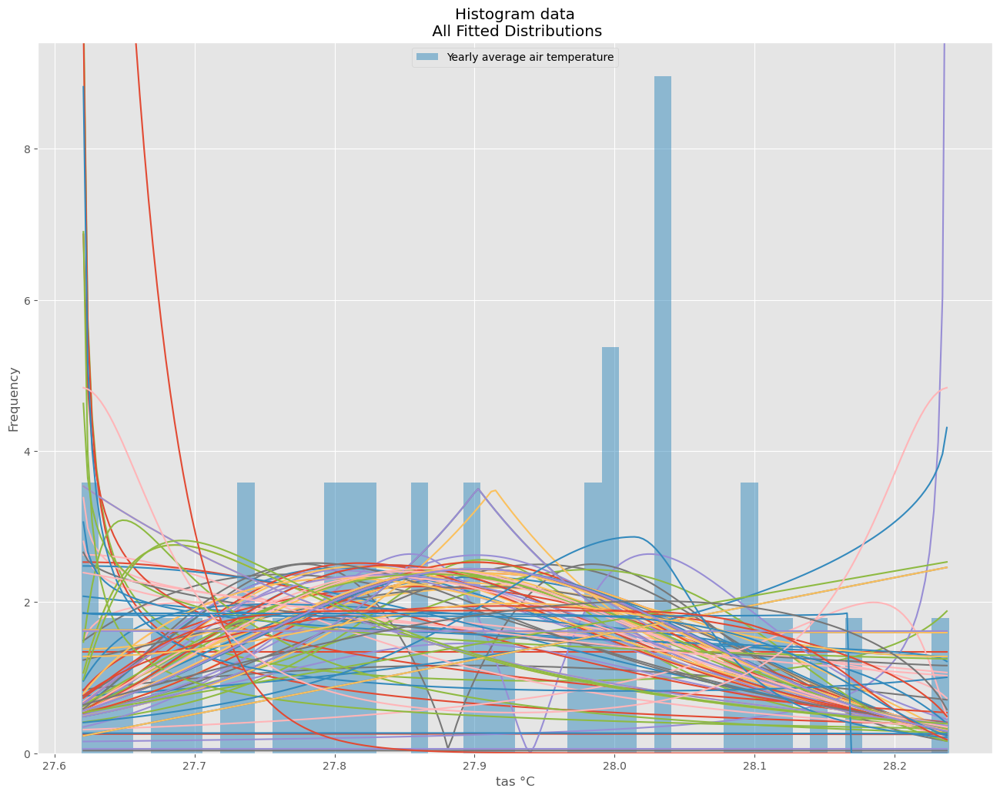

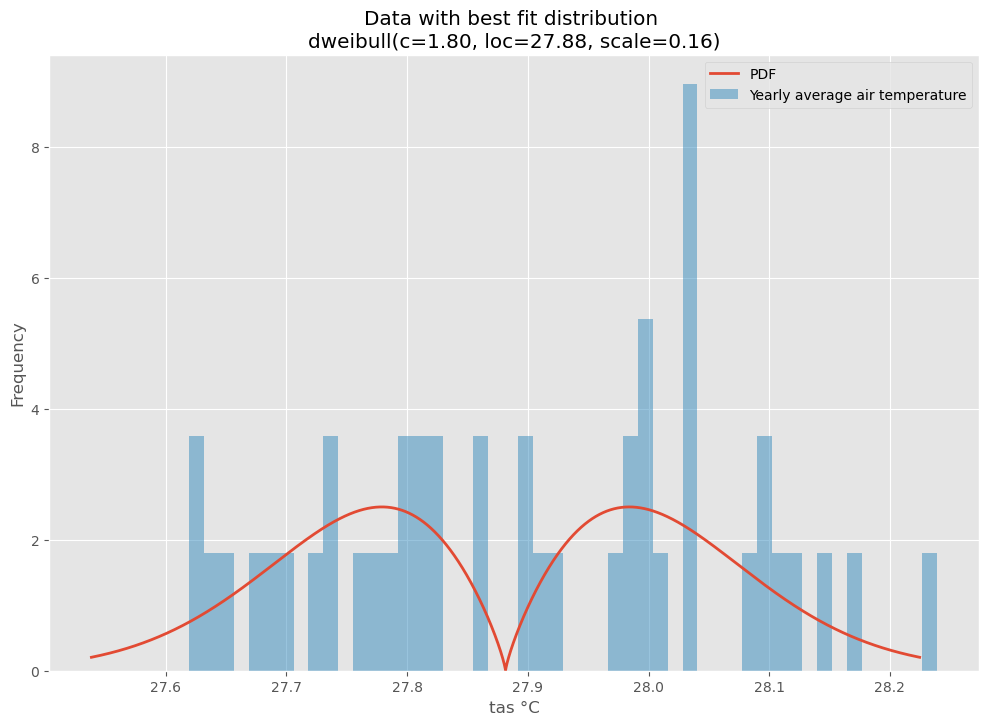

<Figure size 1200x800 with 0 Axes>

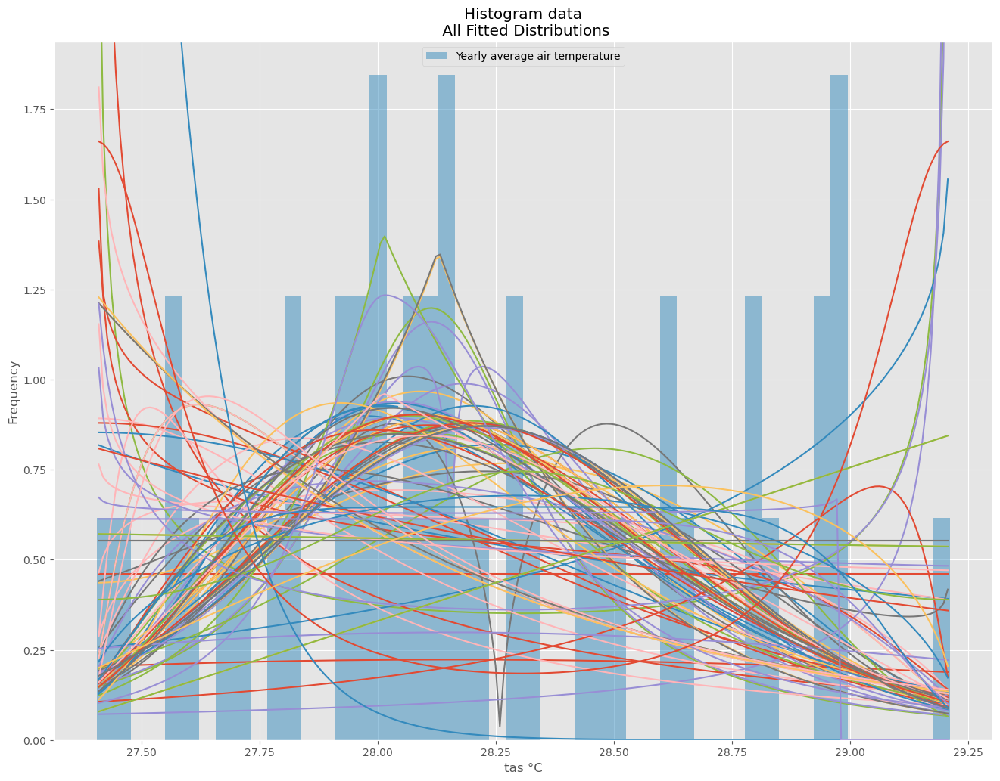

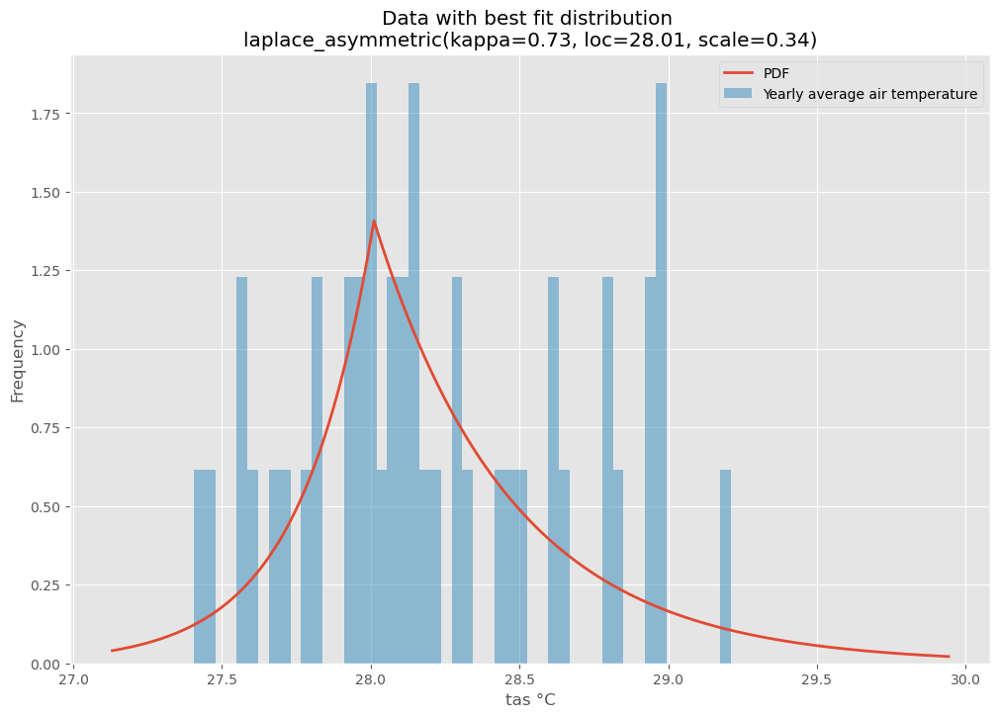

<Figure size 1200x800 with 0 Axes>

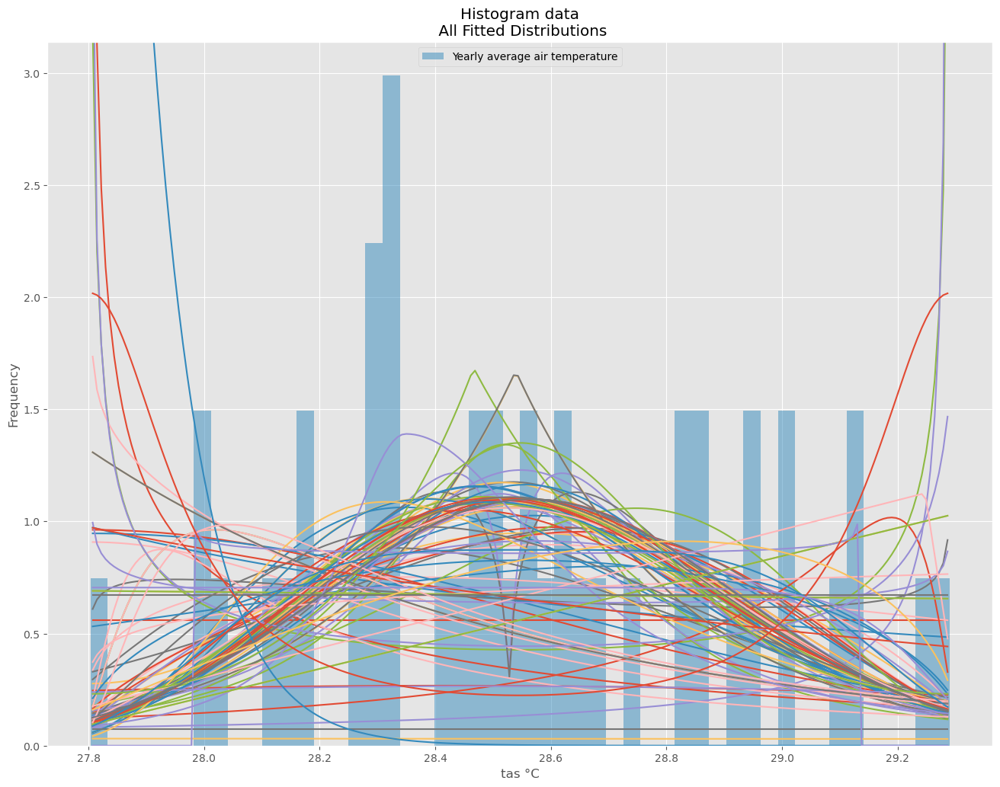

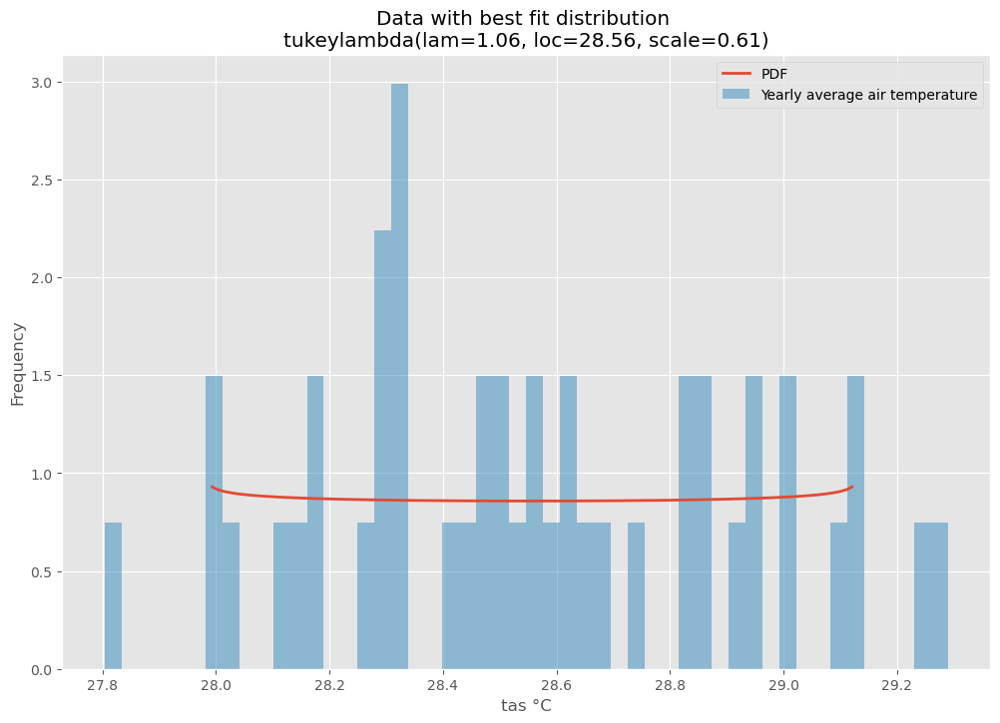

<Figure size 1200x800 with 0 Axes>

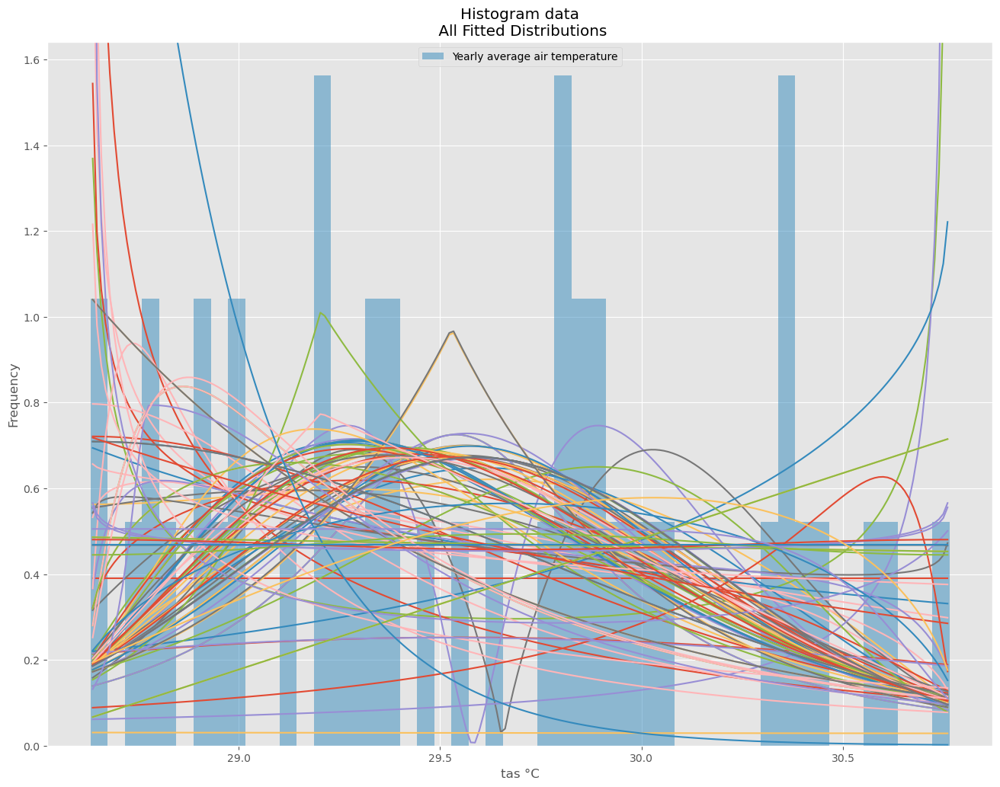

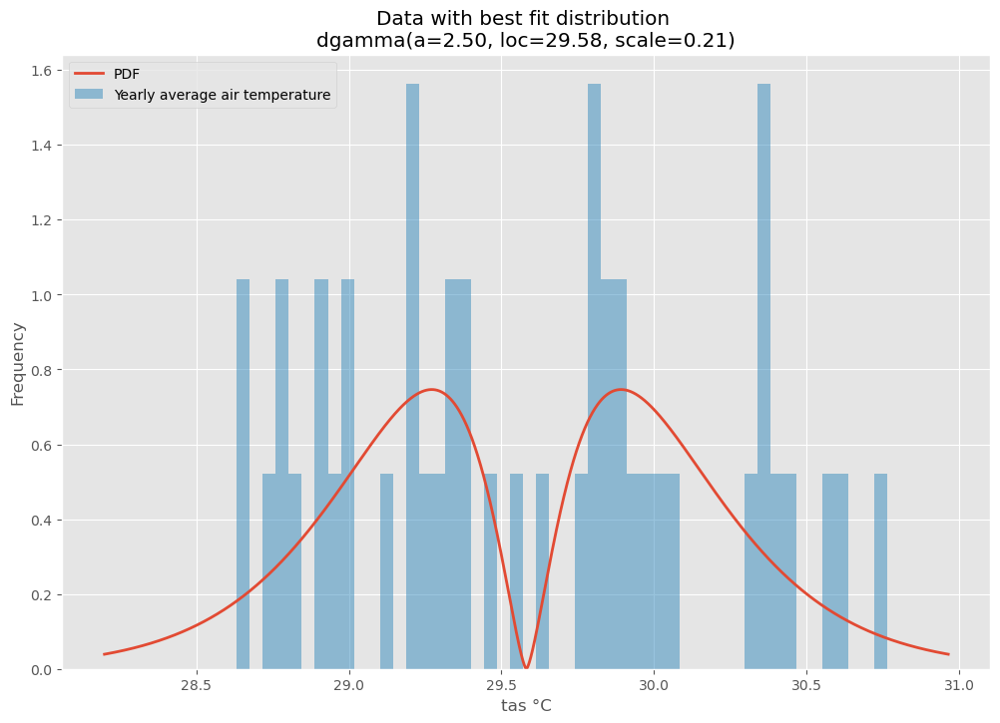

<Figure size 1200x800 with 0 Axes>

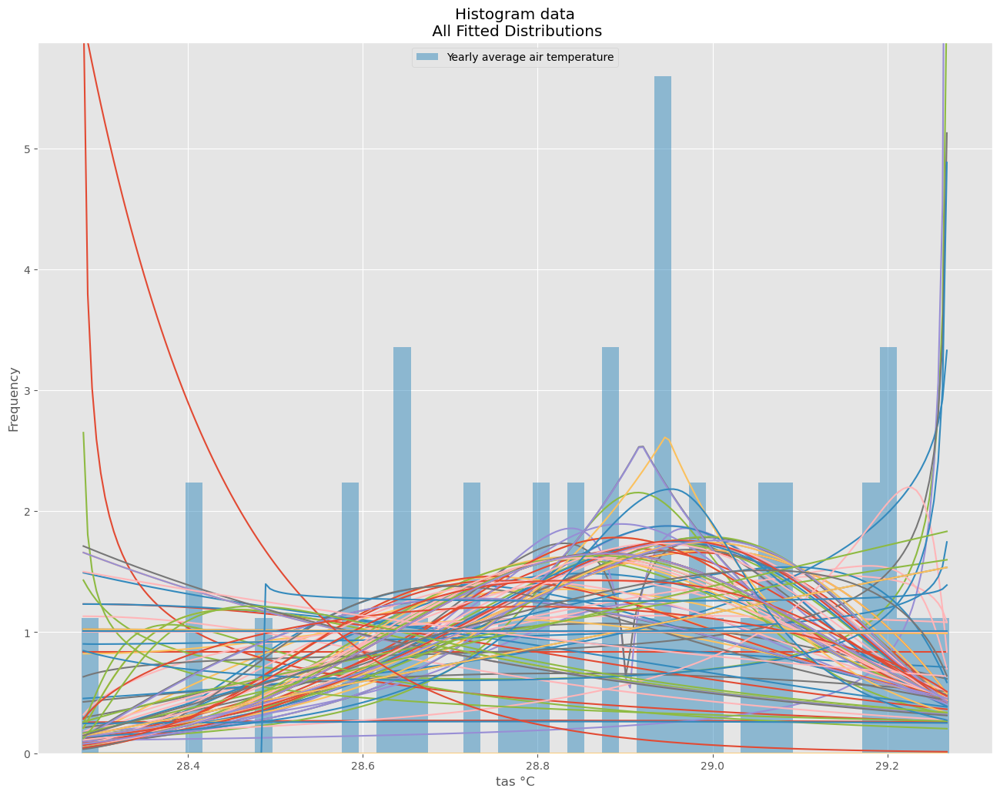

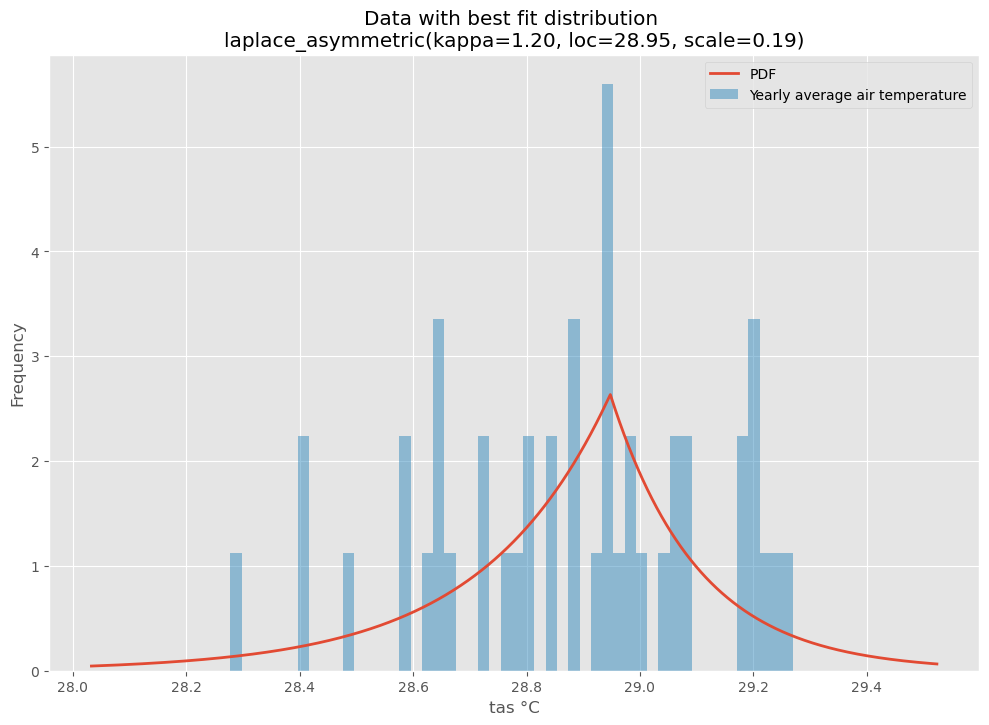

<Figure size 1200x800 with 0 Axes>

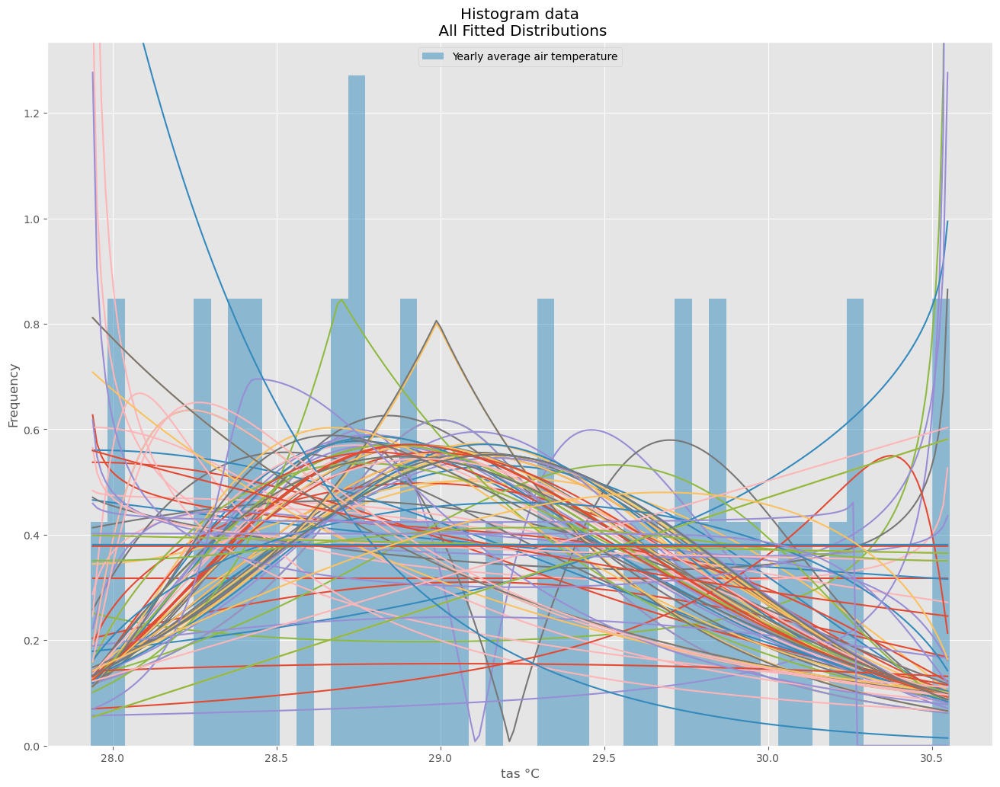

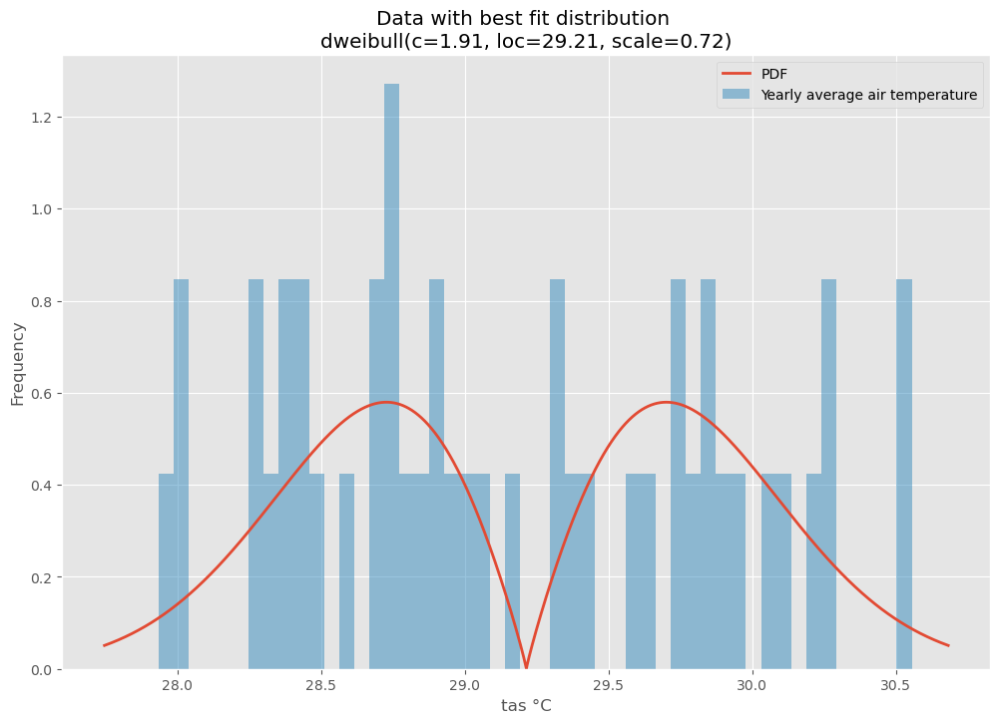

<Figure size 1200x800 with 0 Axes>

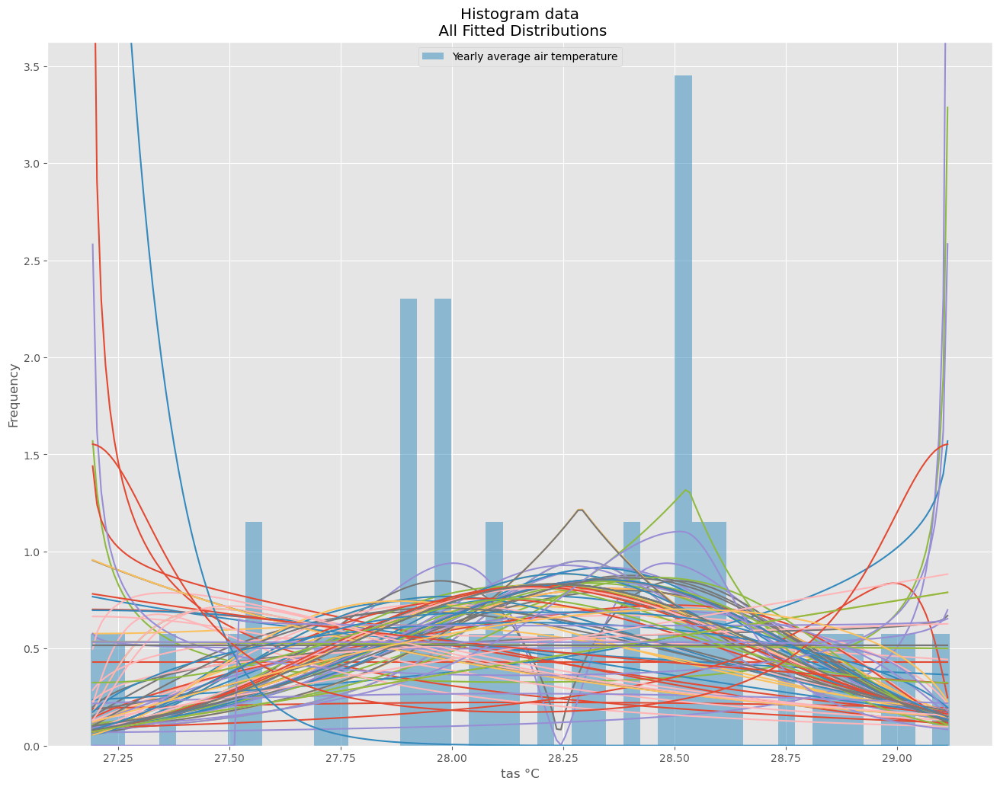

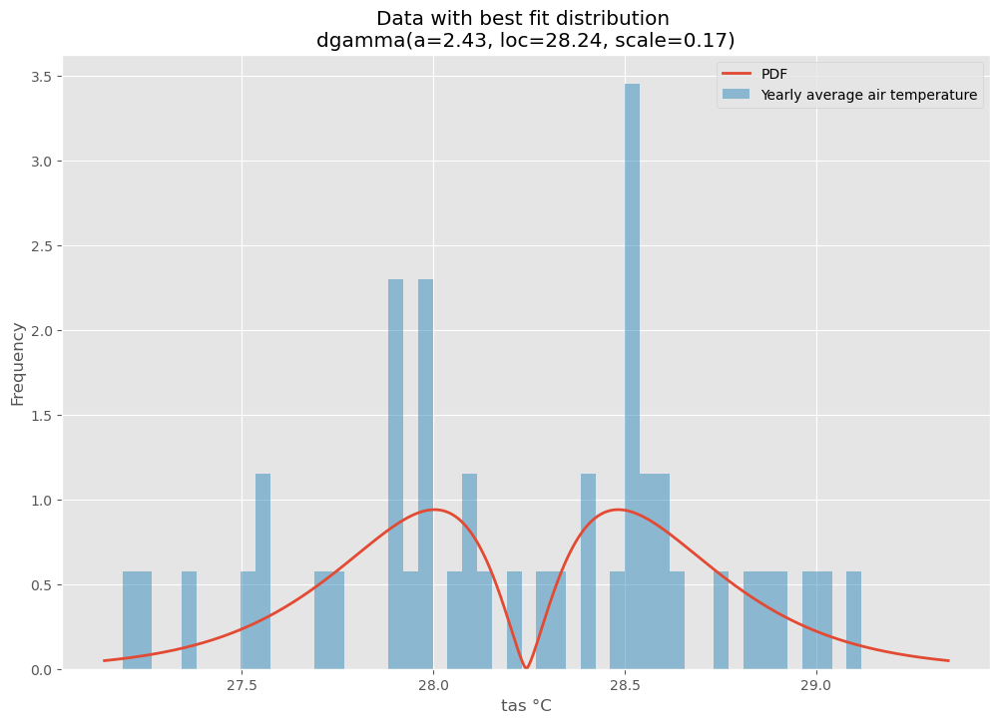

<Figure size 1200x800 with 0 Axes>

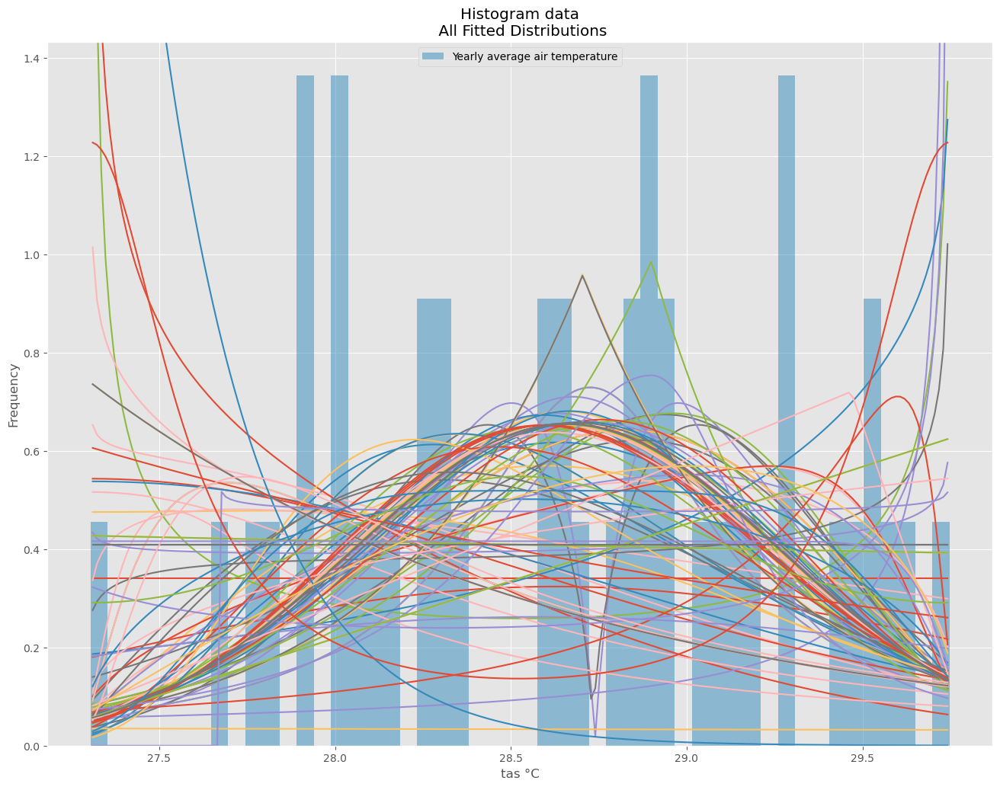

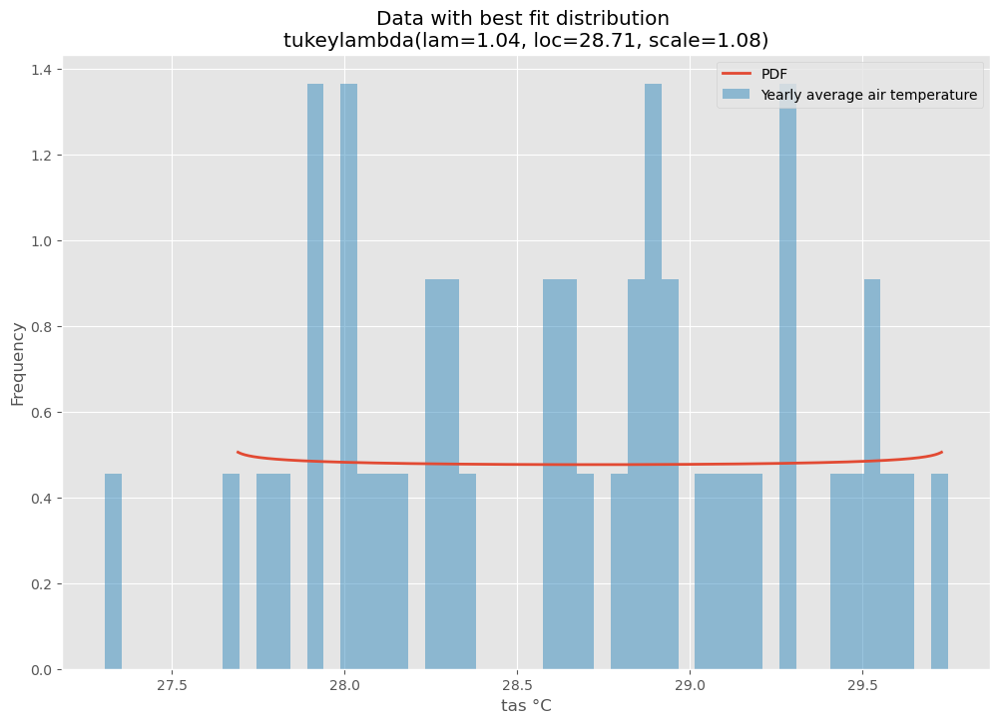

<Figure size 1200x800 with 0 Axes>

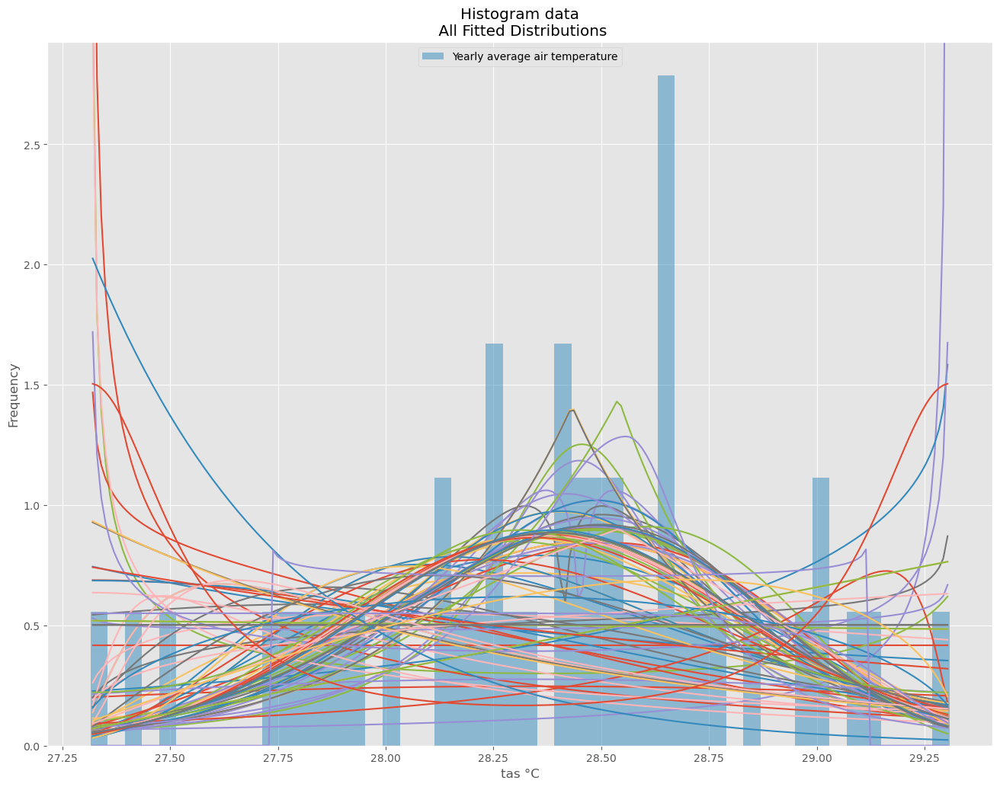

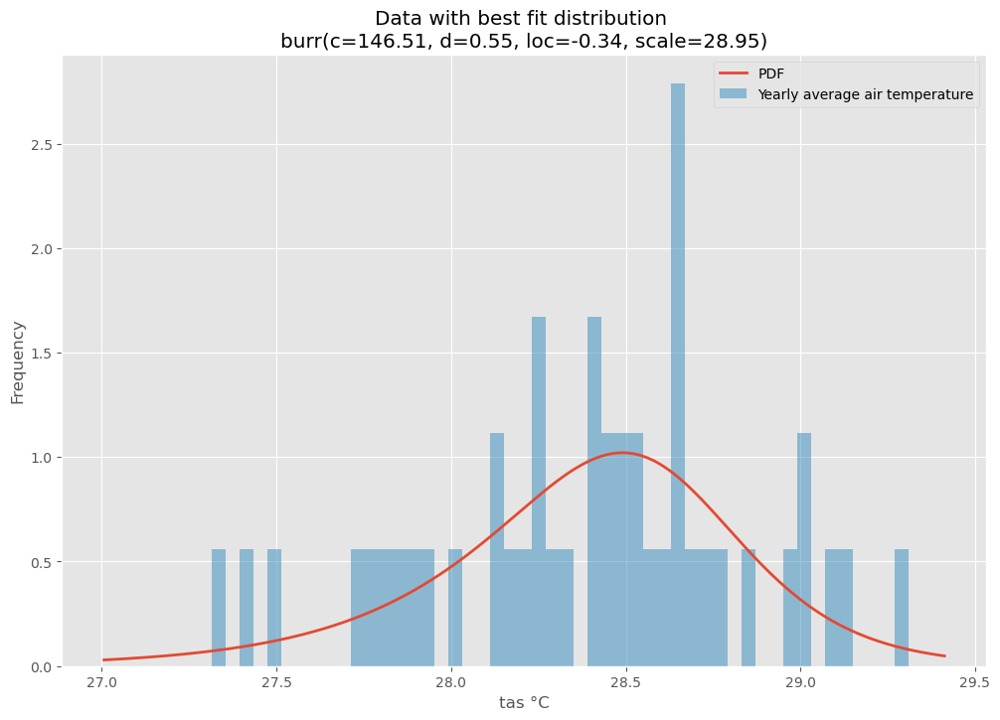

<Figure size 1200x800 with 0 Axes>

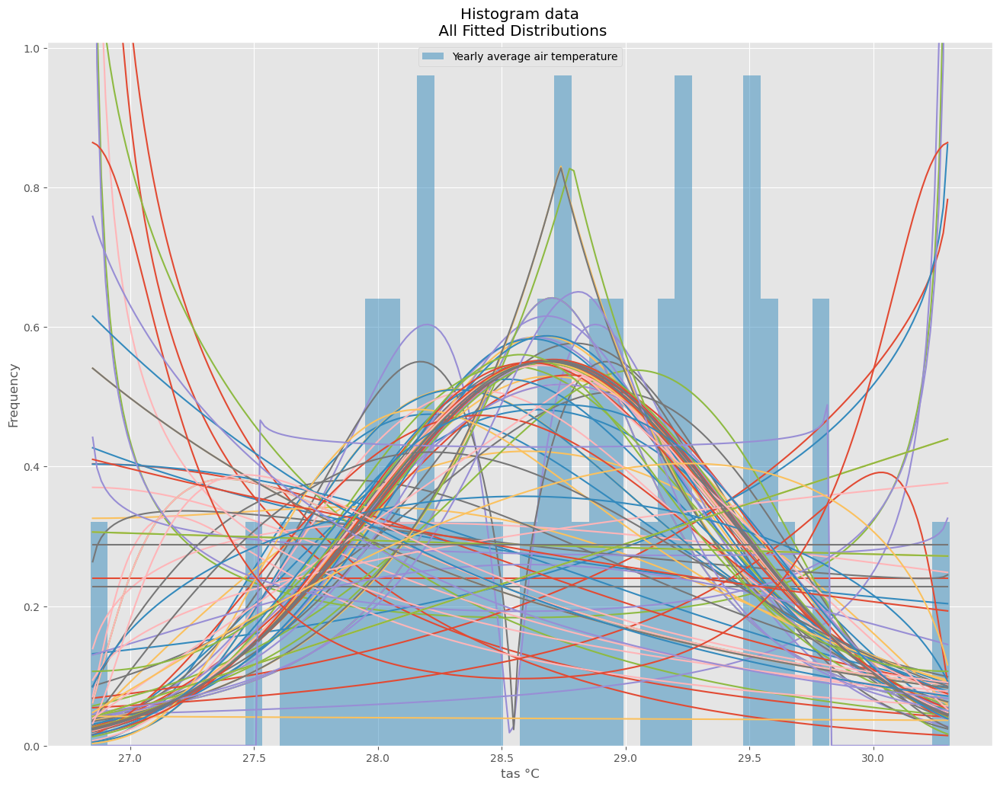

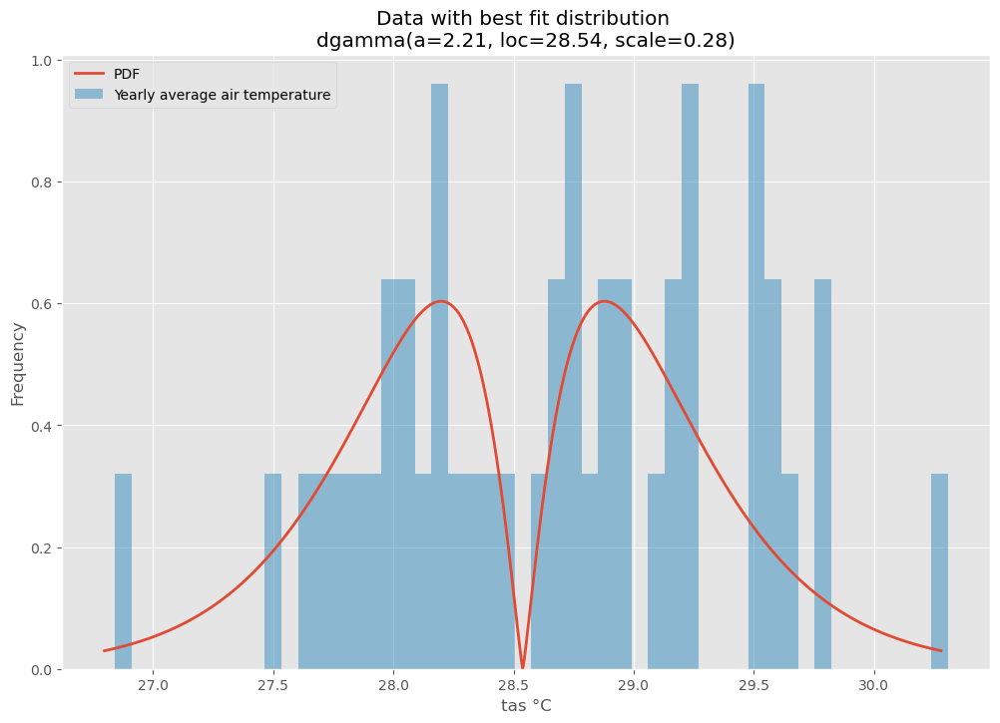

<Figure size 1200x800 with 0 Axes>

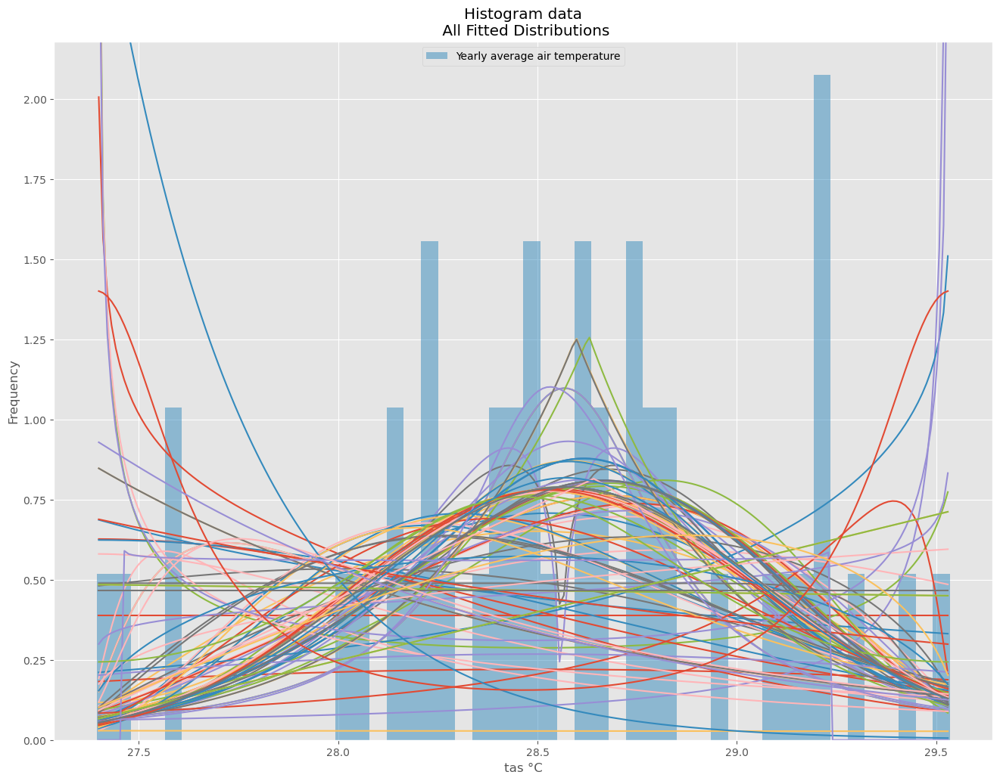

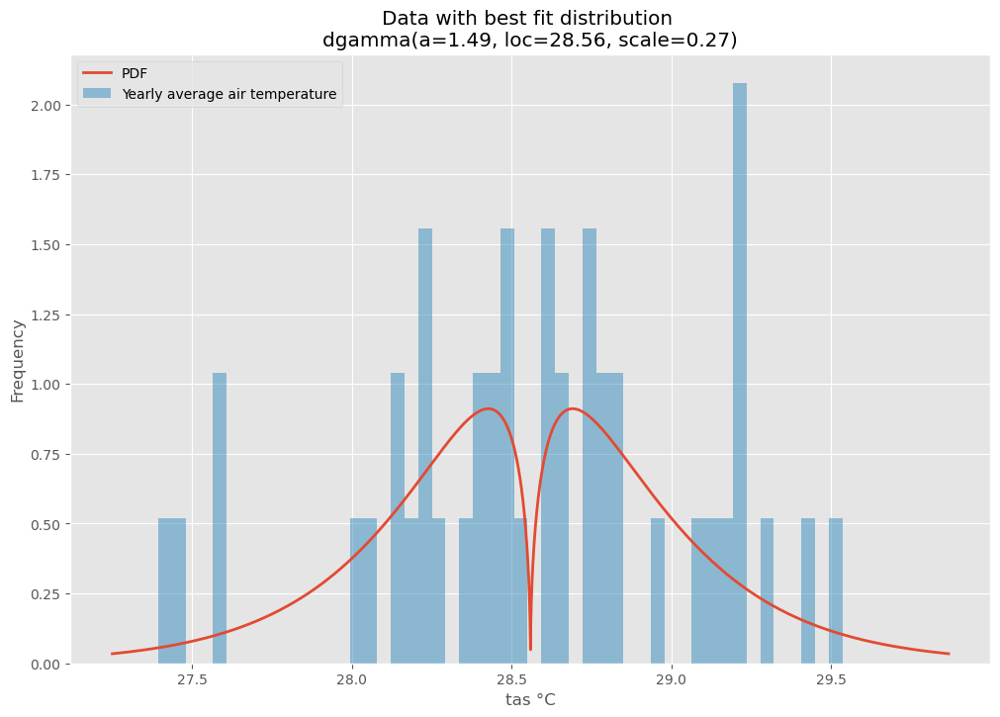

<Figure size 1200x800 with 0 Axes>

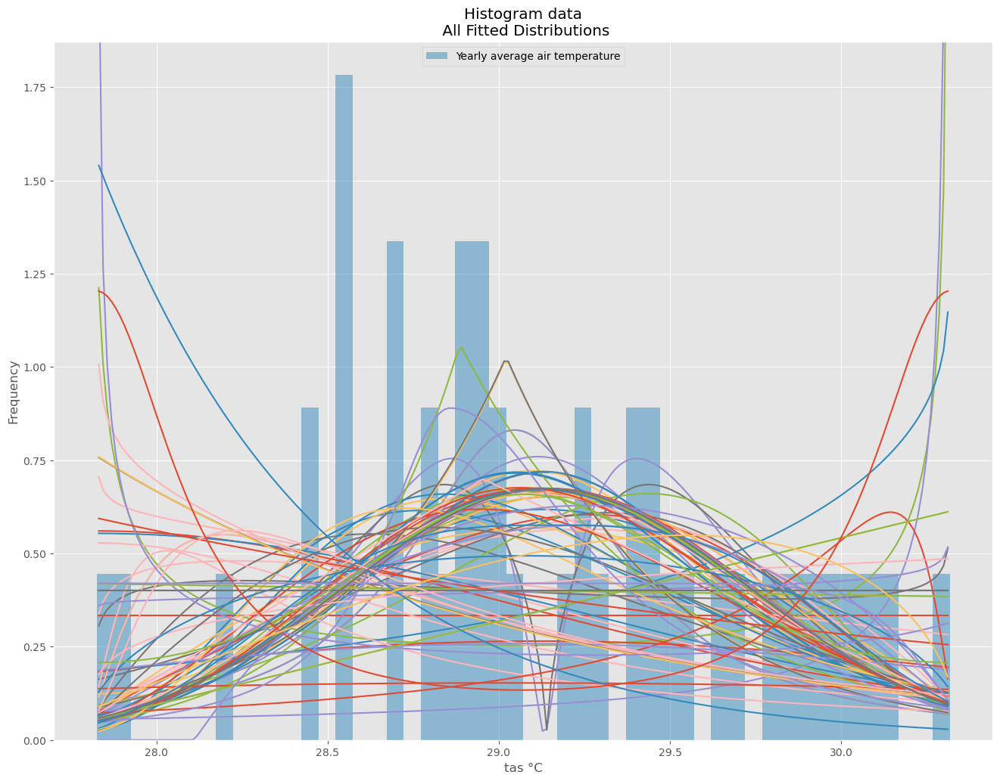

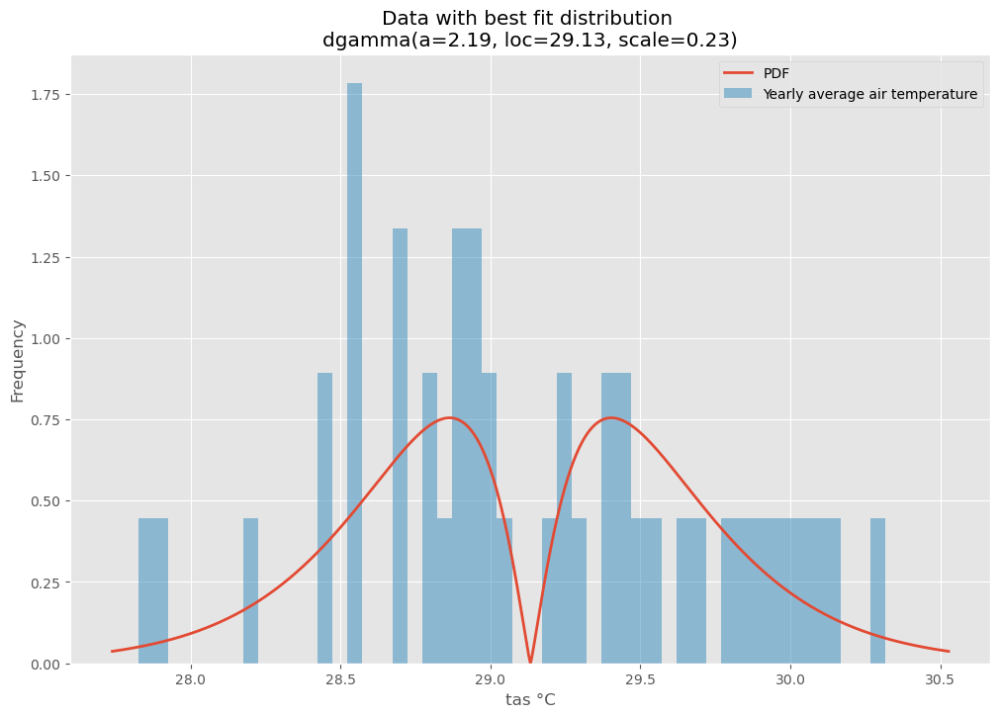

<Figure size 1200x800 with 0 Axes>

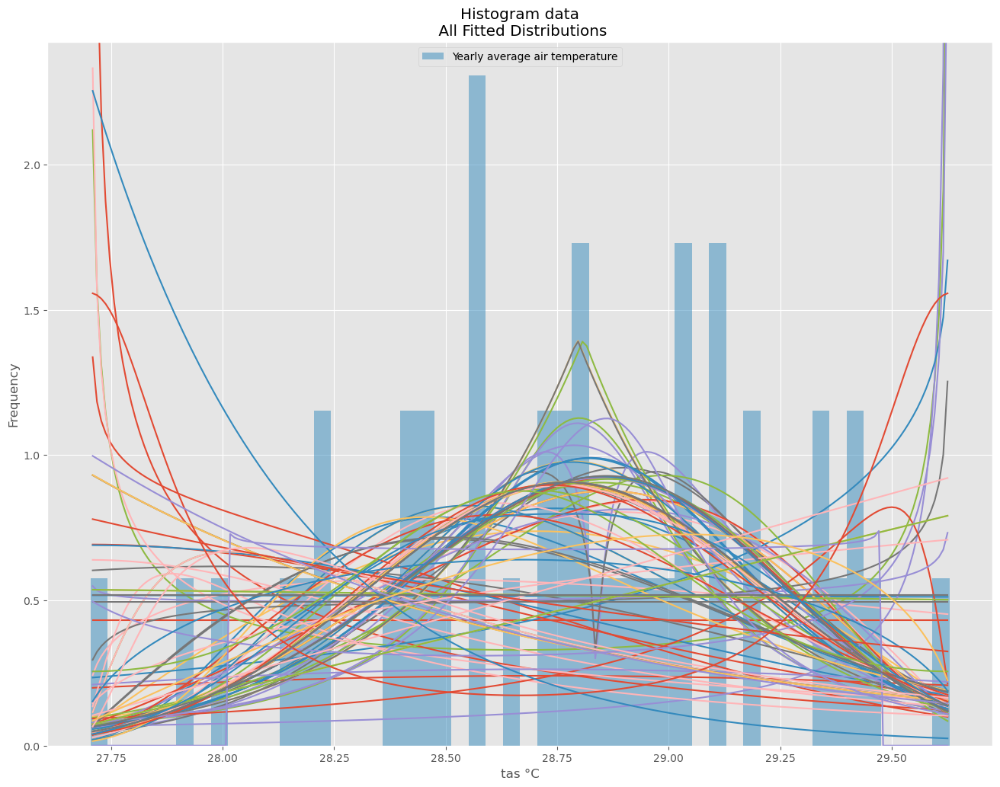

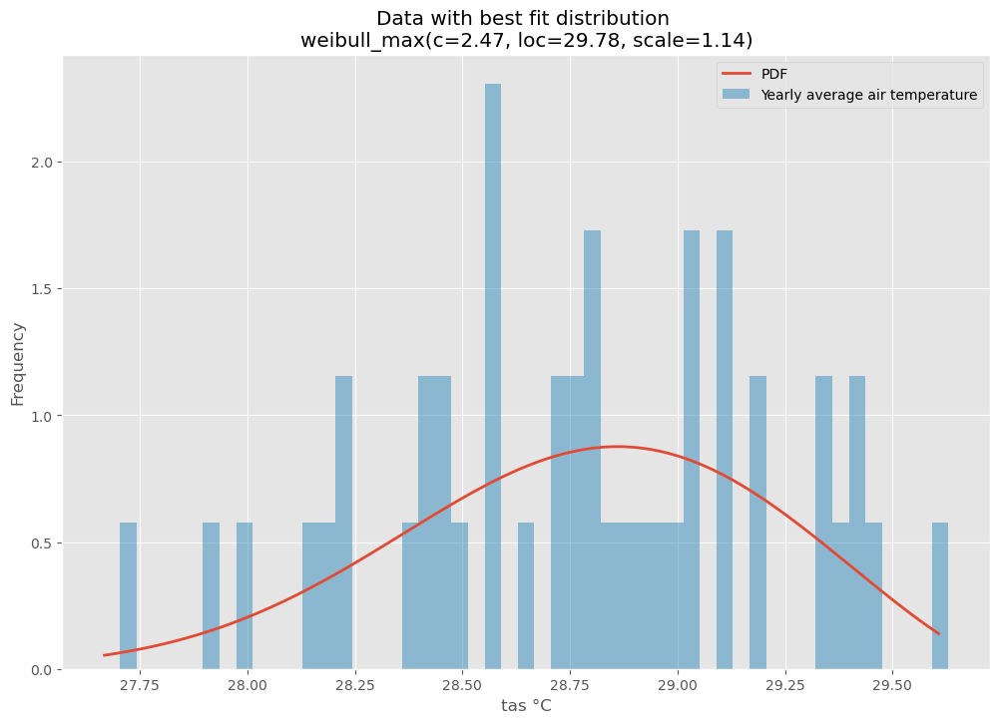

<Figure size 1200x800 with 0 Axes>

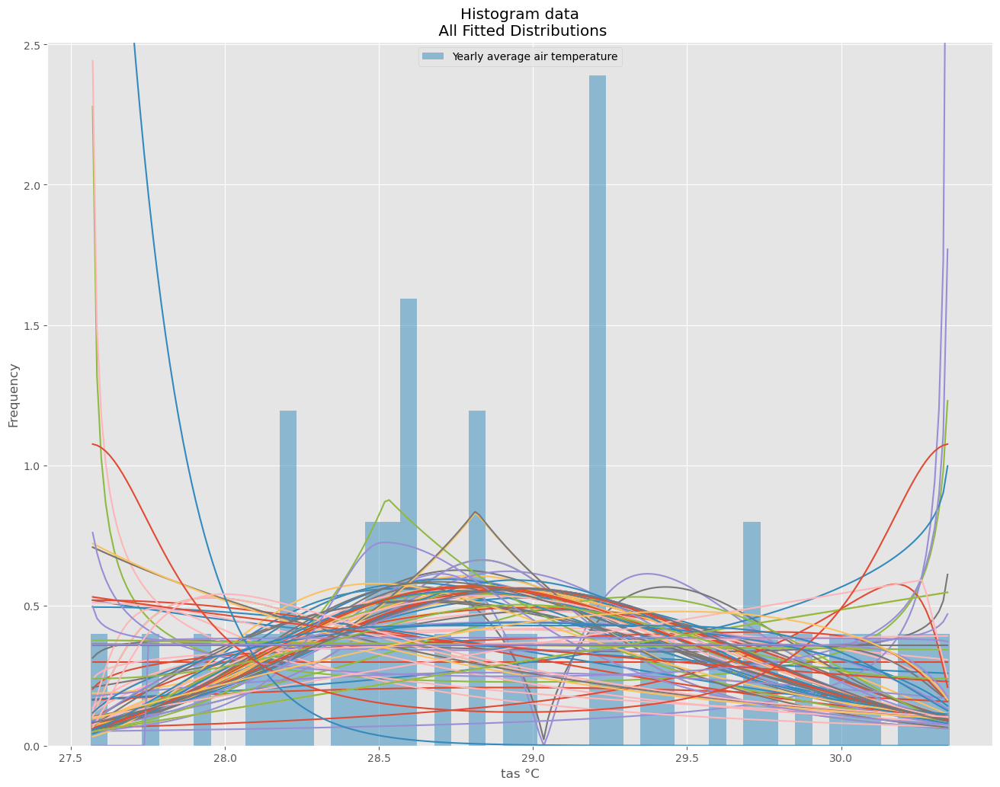

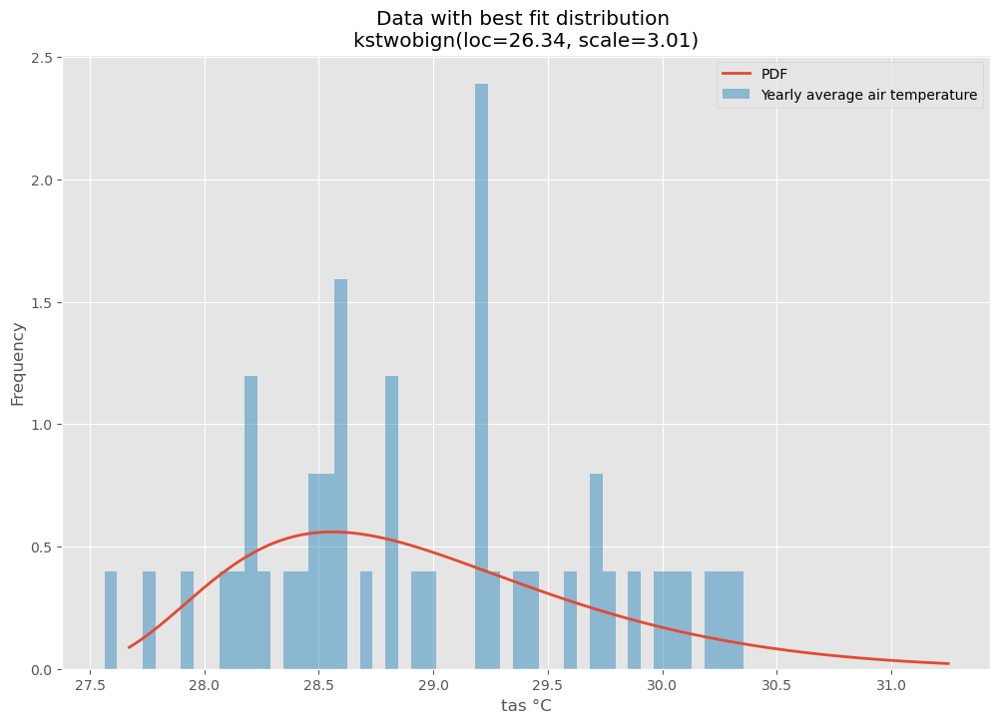

<Figure size 1200x800 with 0 Axes>

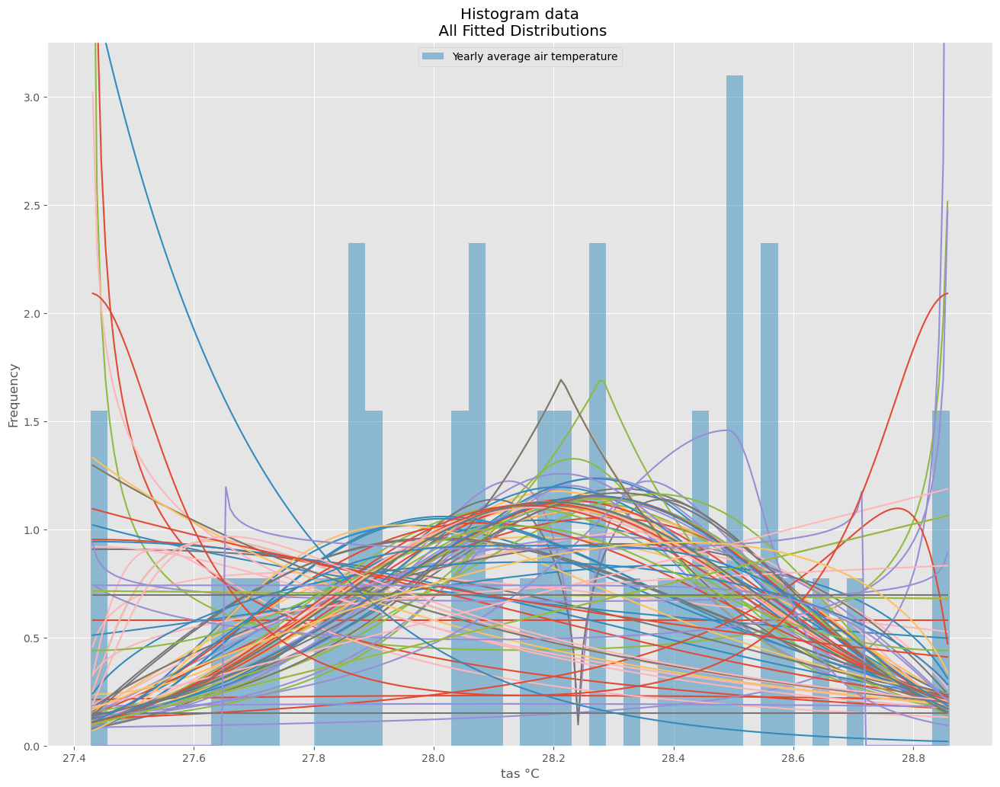

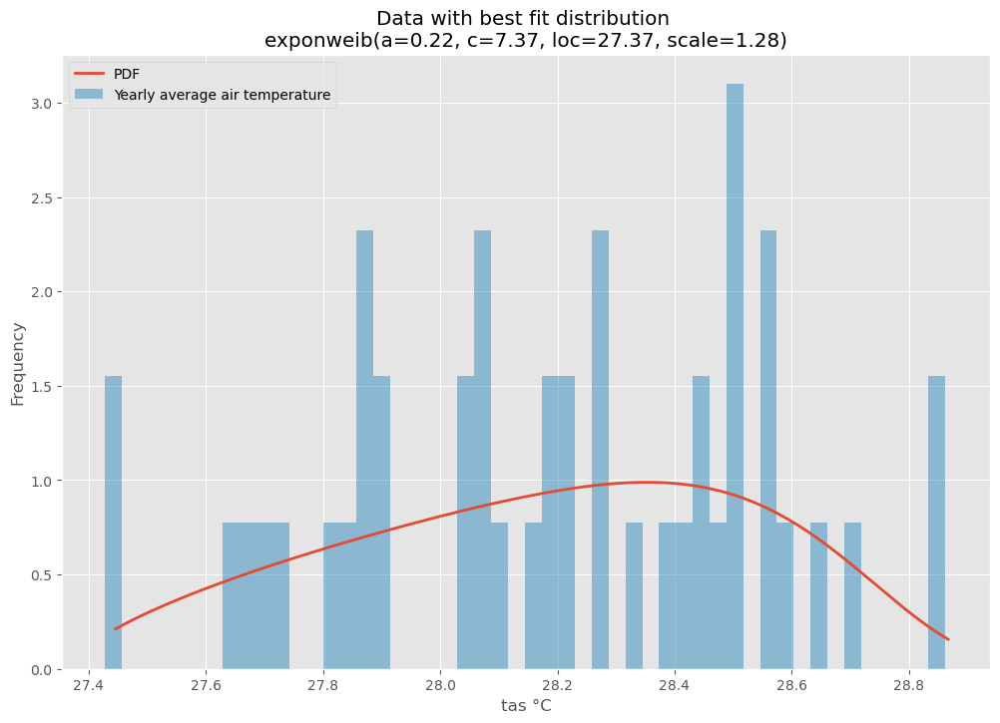

<Figure size 1200x800 with 0 Axes>

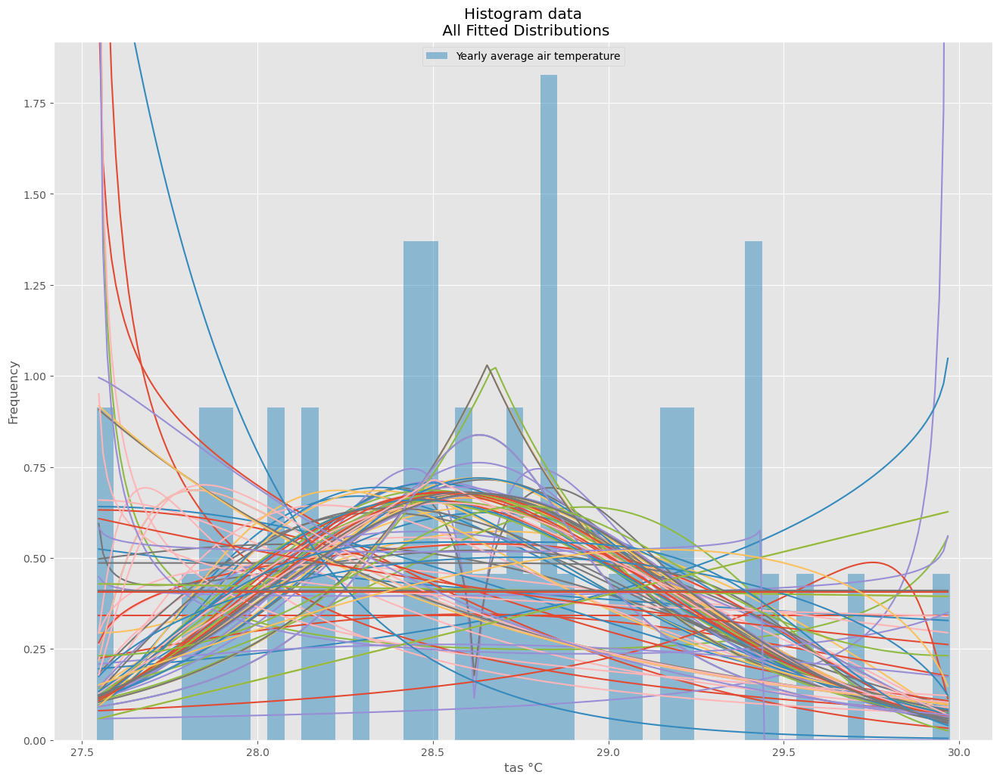

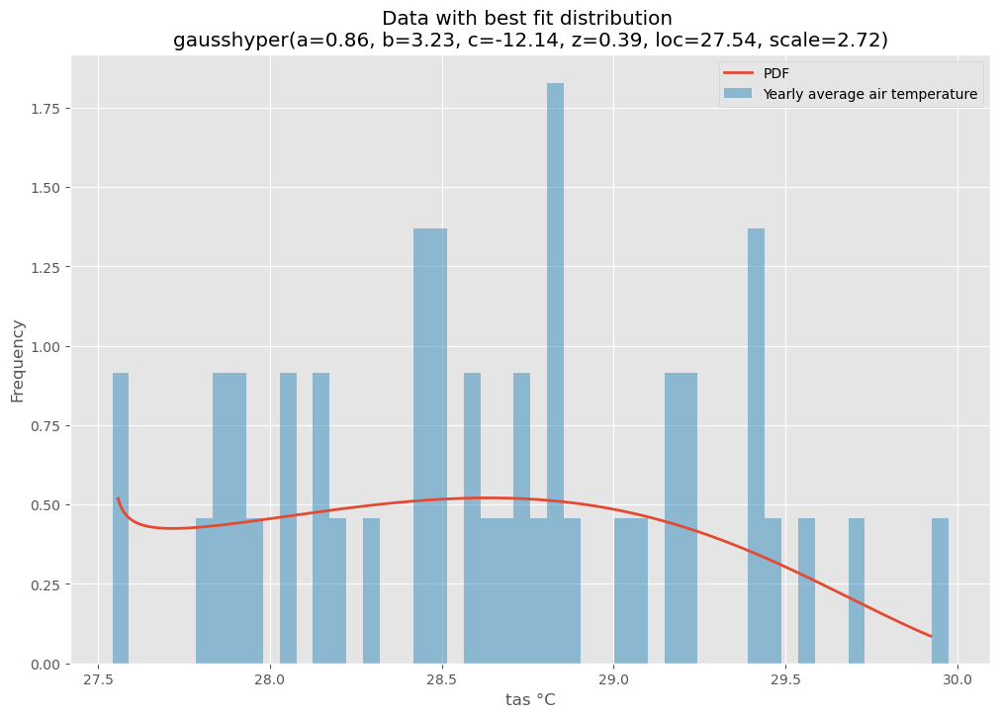

<Figure size 1200x800 with 0 Axes>

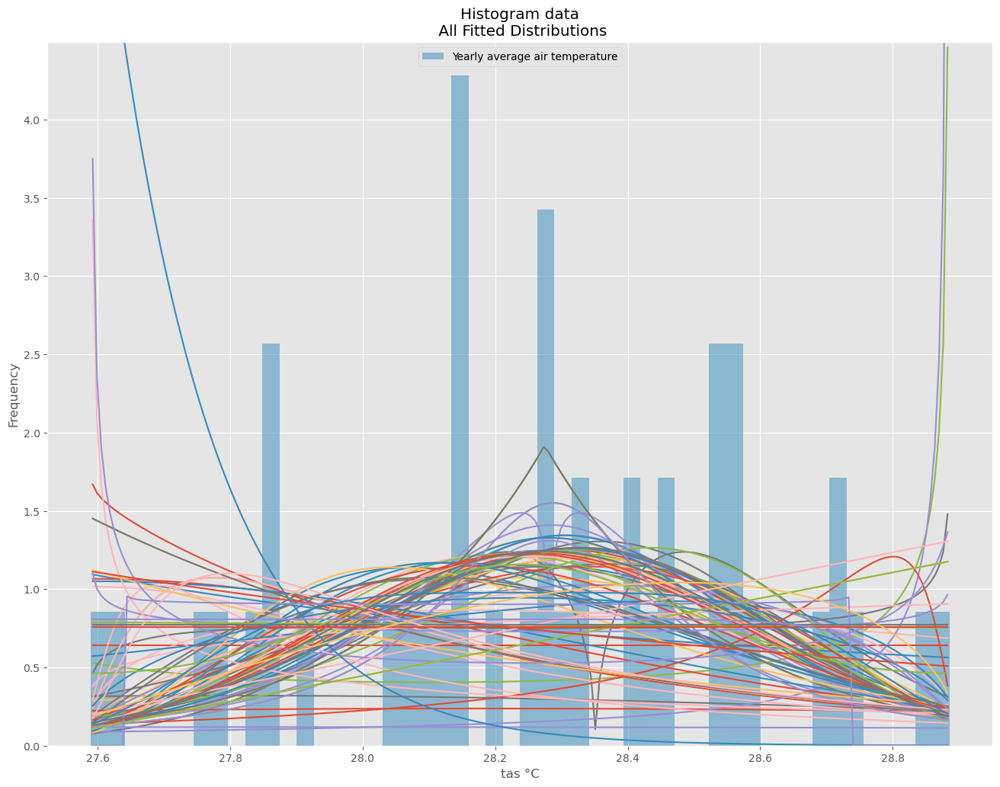

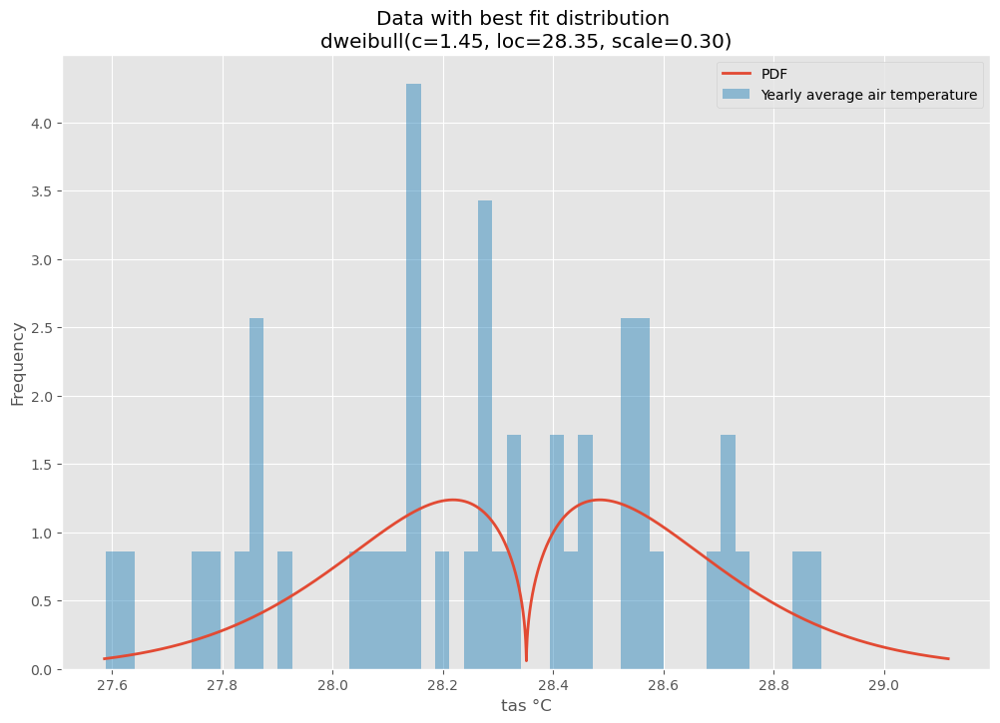

<Figure size 1200x800 with 0 Axes>

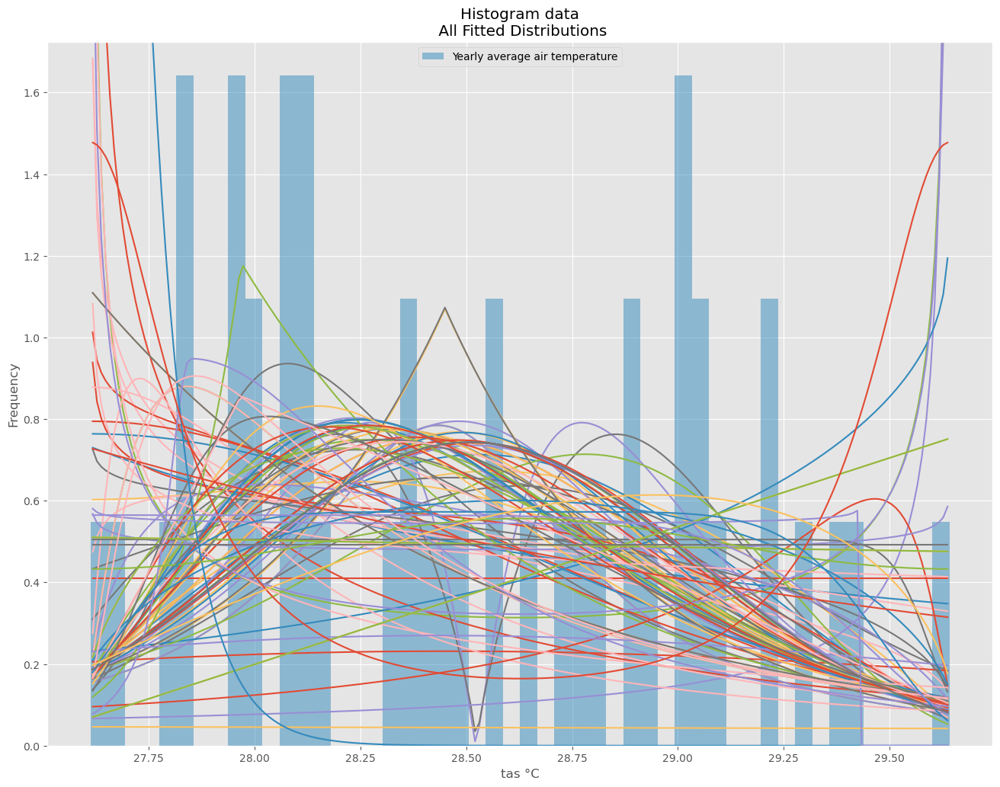

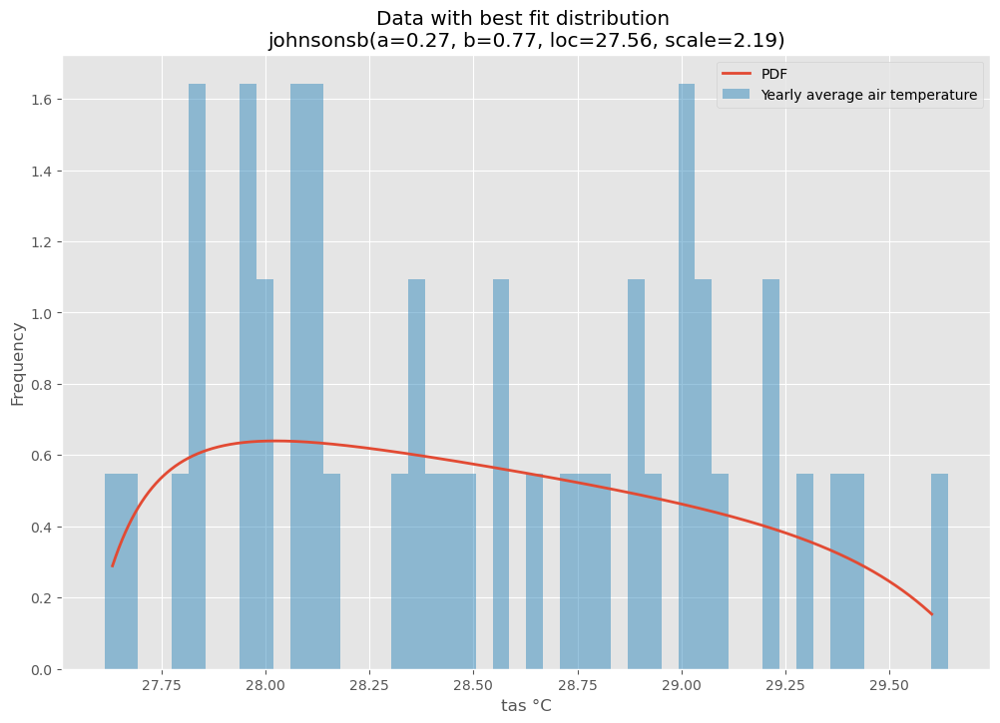

<Figure size 1200x800 with 0 Axes>

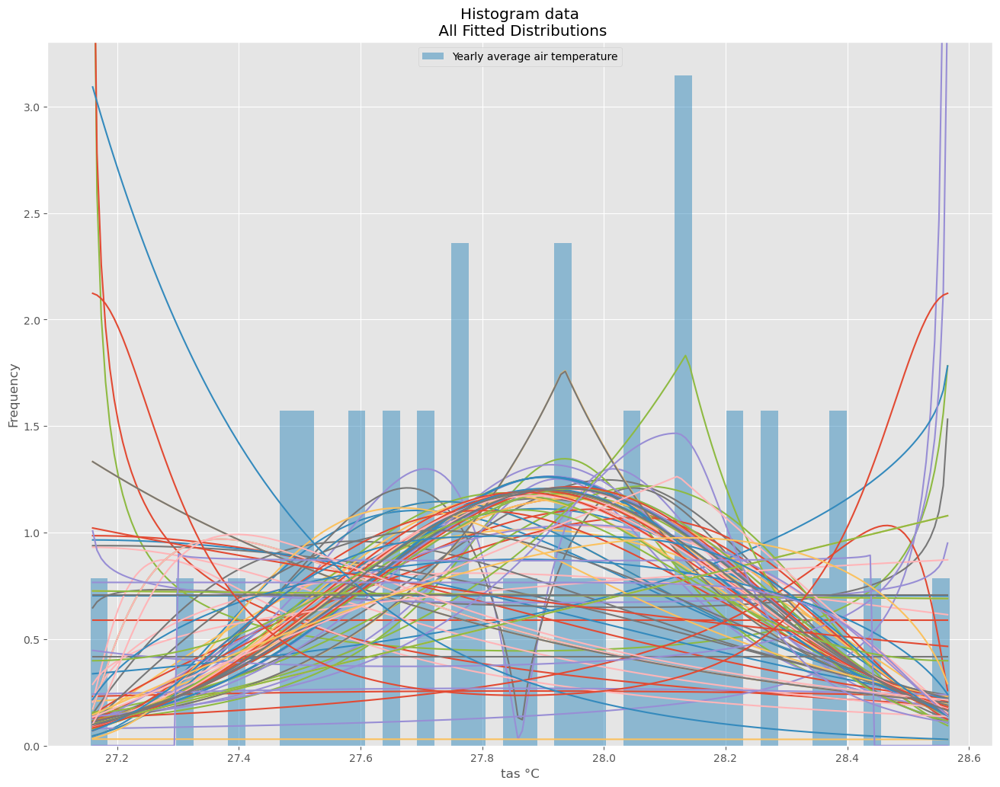

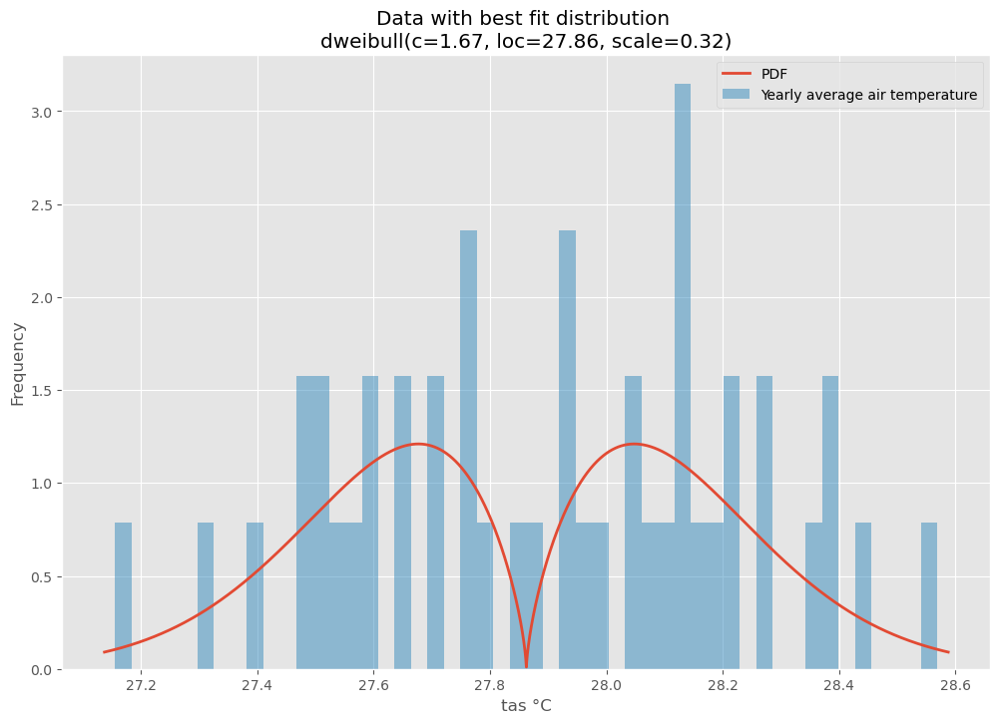

<Figure size 1200x800 with 0 Axes>

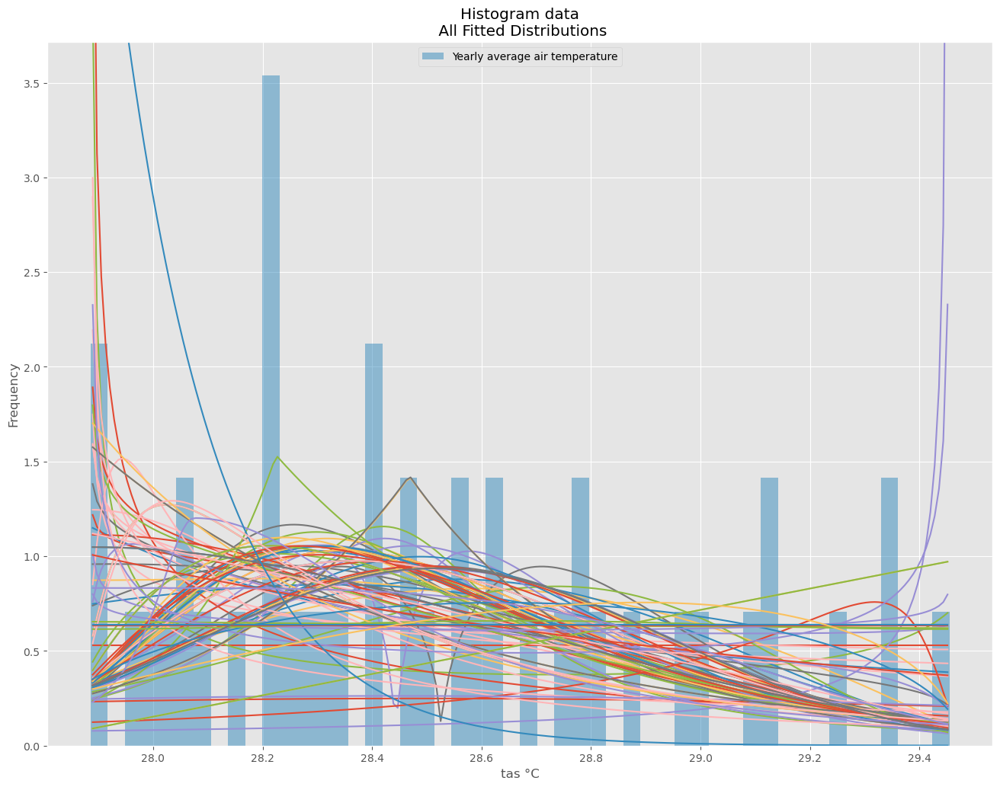

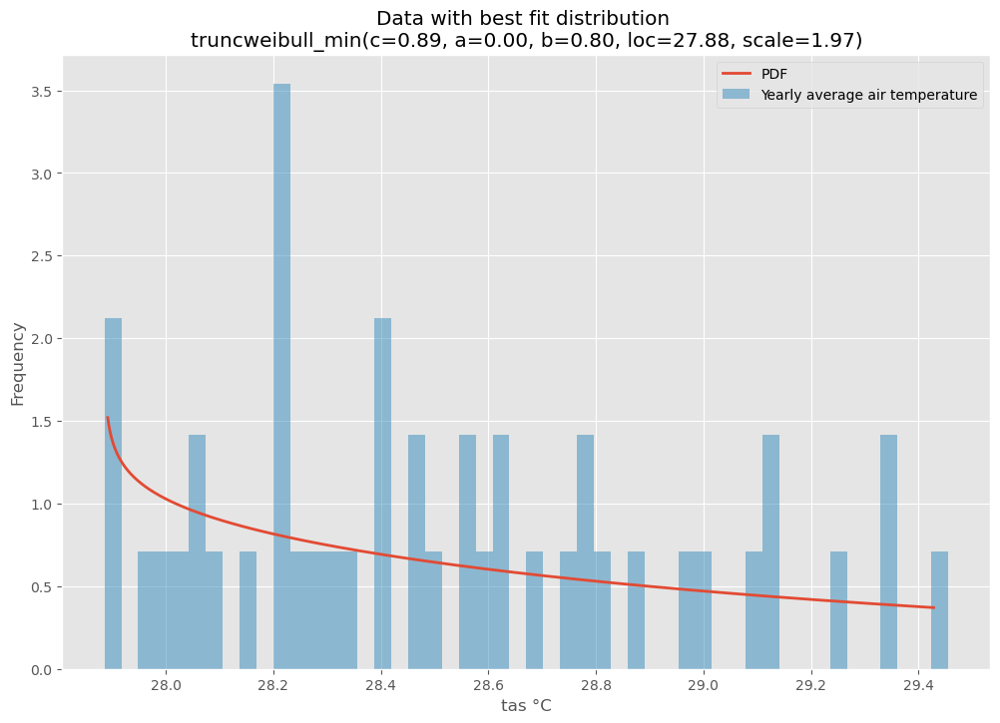

<Figure size 1200x800 with 0 Axes>

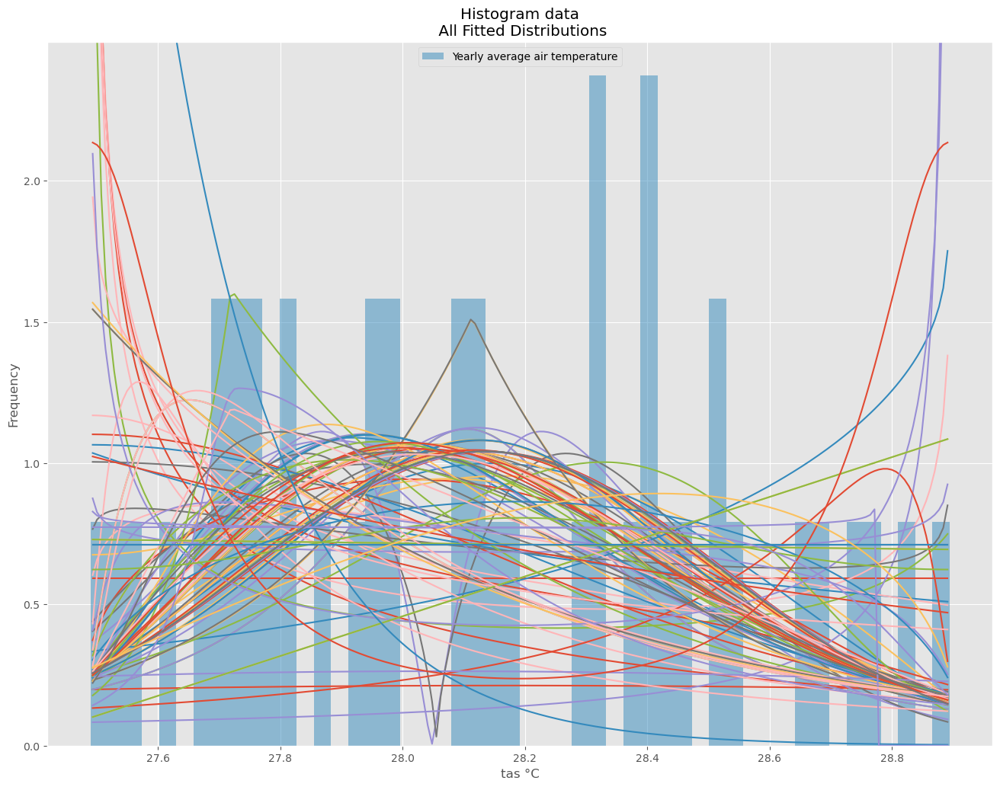

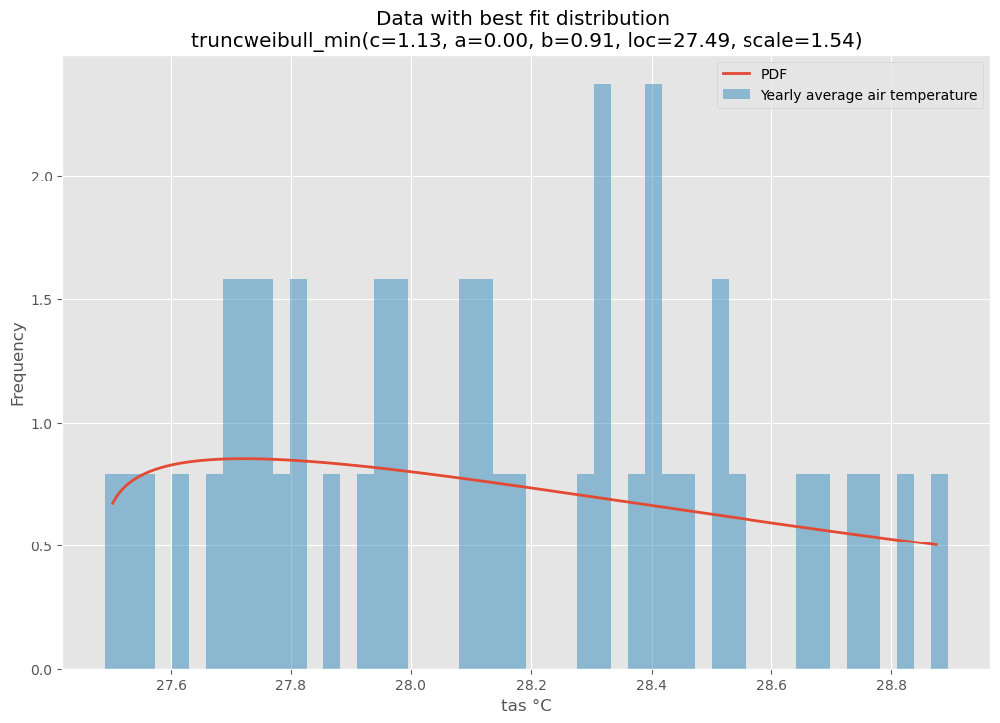

<Figure size 1200x800 with 0 Axes>

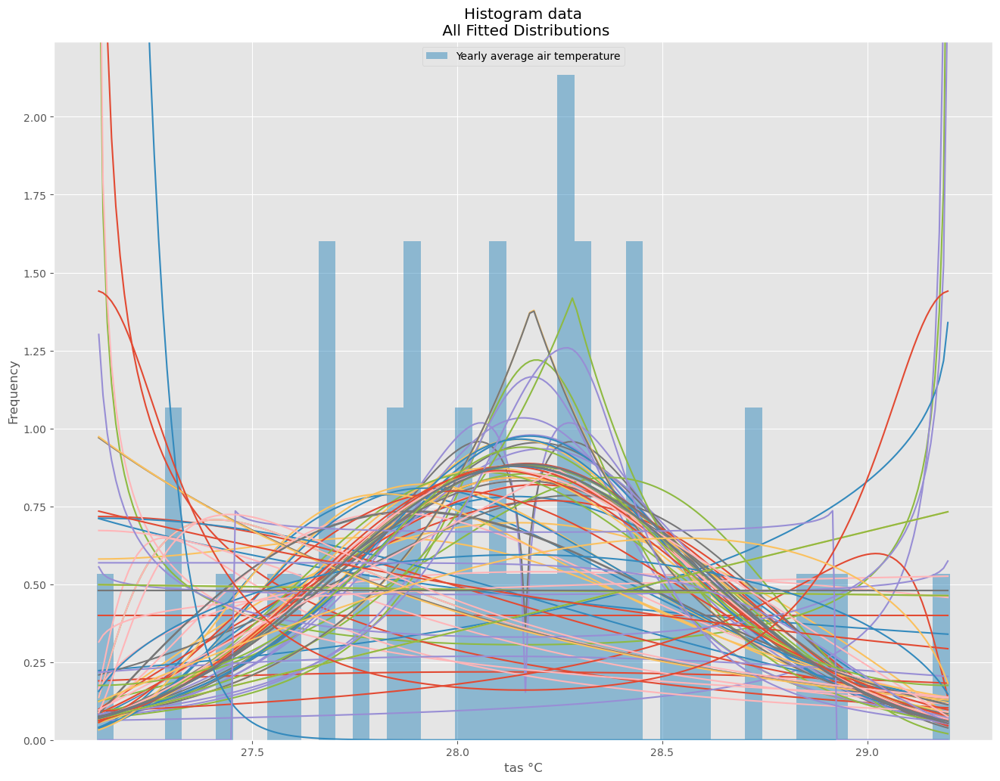

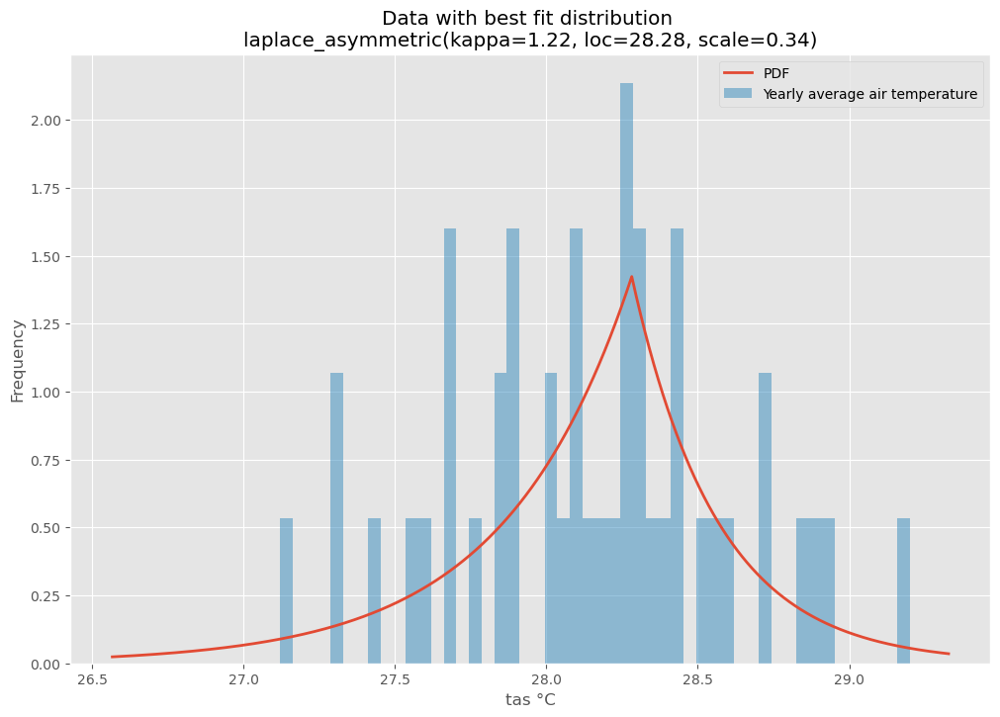

In [58]:
# as the elements of the project is not vulnerable regarding yearly temperature, no need to do risk assessment
var='tas'
description='Yearly average air temperature'
thresVal=40
thresDef='>'
(proba_event_accross_model_and_ssp_loc_tas,likelihood_accross_model_and_ssp_loc_tas)=likelihood_accross_models_and_ssps(df_yearly_avg_tas_NEXGDDPCMIP6_loc.reset_index()[df_yearly_avg_tas_NEXGDDPCMIP6_loc.reset_index()['Year'].between(2030,2074)],var,'°C',description,thresVal,thresDef)

In [59]:
proba_event_accross_model_and_ssp_loc_tas # 6.93085588542946e-08

0.0002995130901247793

In [60]:
likelihood_accross_model_and_ssp_loc_tas # Rare

'Rare'

## Extreme temperature increase

In [240]:
csv_path=r'\\cowi.net\projects\A245000\A248363\CRVA\Datasets\NEX-GDDP-CMIP6-AllMoz\csv_file'
locNames='_projectsMoz'
df_tasmax_NEXGDDPCMIP6 = import_treat_modeled_NEX_GDDP_CMIP6('tasmax','Celsius','day',1950,2100,csv_path,locNames) # maximum daily temperature

In [244]:
loc='WTP_Mutua_EIB'
df_tasmax_NEXGDDPCMIP6_loc = filter_dataframe(df_tasmax_NEXGDDPCMIP6,[loc],['TaiESM1'])

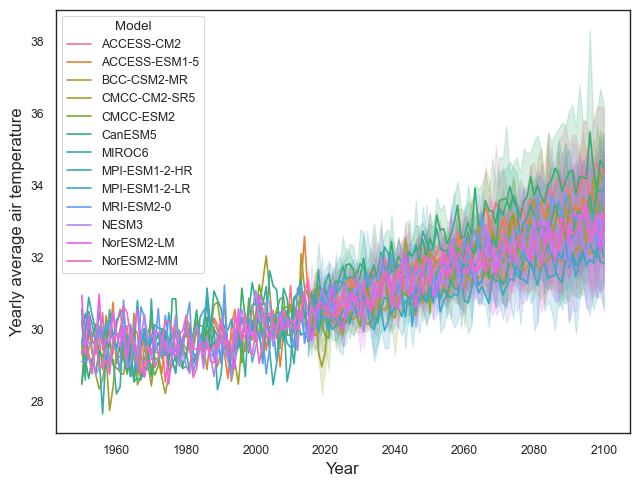

In [245]:
df_yearly_avg_tasmax_NEXGDDPCMIP6_loc=temporal_avg(df_tasmax_NEXGDDPCMIP6_loc,'temperature','Yearly average air temperature','year')
df_yearly_avg_tasmax_NEXGDDPCMIP6_loc=df_yearly_avg_tasmax_NEXGDDPCMIP6_loc.reset_index() #reset index derived from groupby when using temporal_avg function

fig,ax=plt.subplots()
plt.tight_layout() # Adjust the padding between and around subplots.
#df=df_yearly_avg_tas_NEXGDDPCMIP6_loc
p=sns.lineplot(df_yearly_avg_tasmax_NEXGDDPCMIP6_loc,x='Year',y='Yearly average air temperature',hue='Model')


## cdf-curves (tasmax)

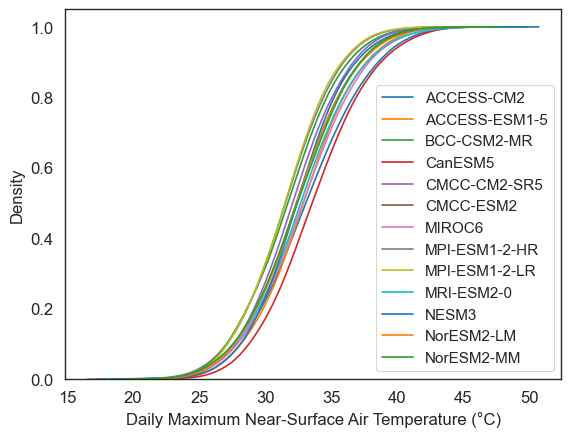

<Figure size 640x480 with 0 Axes>

In [250]:
# CDF-curves for Models with different scenarios 
scenario='ssp585' #'ssp126', ssp245', 'ssp370','ssp585'
models=['ACCESS-CM2', 'ACCESS-ESM1-5', 'BCC-CSM2-MR', 'CanESM5',
       'CMCC-CM2-SR5', 'CMCC-ESM2', 'MIROC6', 'MPI-ESM1-2-HR',
       'MPI-ESM1-2-LR', 'MRI-ESM2-0', 'NESM3', 'NorESM2-LM', 'NorESM2-MM',
       'TaiESM1'] 
df_tasmax_scen=df_tasmax_NEXGDDPCMIP6_loc[df_tasmax_NEXGDDPCMIP6_loc['Experiment']==scenario]

f, ax = plt.subplots()
plt.tight_layout
for m in models:
    df_tasmax_scen_mod=df_tasmax_scen[df_tasmax_scen['Model']==m]
    ax = sns.kdeplot(df_tasmax_scen_mod['Daily Maximum Near-Surface Air Temperature °C'], cumulative=True)
ax.legend(labels=models,fontsize=11)
ax.grid(False)
sns.set_context( rc={"axes.titlesize":13,"axes.labelsize":12})  
ax.tick_params(labelsize=12)
plt.xlabel('Daily Maximum Near-Surface Air Temperature (°C)')
sns.set_style("white")
sns.set_style(rc = {'axes.facecolor': 'white'})
plt.show()
f.tight_layout#
plt.savefig(loc+'tasmax'+scenario+ '.svg', bbox_inches='tight')

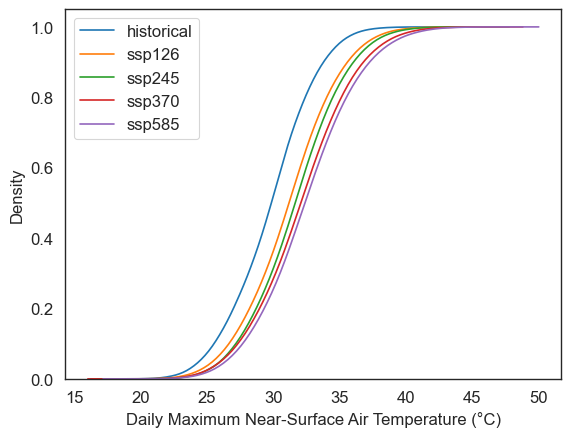

<Figure size 640x480 with 0 Axes>

In [315]:
# CDF-curves scenarios 
scenario=['historical','ssp126', 'ssp245', 'ssp370','ssp585']

f, ax = plt.subplots()
plt.tight_layout
for s in scenario:
    df_tasmax_scen=df_tasmax_NEXGDDPCMIP6_loc[df_tasmax_NEXGDDPCMIP6_loc['Experiment']==s]
    ax = sns.kdeplot(df_tasmax_scen['Daily Maximum Near-Surface Air Temperature °C'], cumulative=True)

ax.legend(labels=scenario,fontsize=12)
ax.grid(False)
sns.set_context( rc={"axes.titlesize":13,"axes.labelsize":12})  
ax.tick_params(labelsize=12)
plt.xlabel('Daily Maximum Near-Surface Air Temperature (°C)')
sns.set_style("white")
sns.set_style(rc = {'axes.facecolor': 'white'})
plt.show()
f.tight_layout#
plt.savefig(loc+'tasmax'+'scenarios'+ '.svg', bbox_inches='tight')

In [187]:
df_tasmax_NEXGDDPCMIP6_past = filter_dataframe(df_tasmax_NEXGDDPCMIP6,[loc],['TaiESM1','CMCC-CM2-SR5','NESM3'],start_y=1970,stop_y=2014)

In [188]:
df_tasmax_NEXGDDPCMIP6_future = filter_dataframe(df_tasmax_NEXGDDPCMIP6,[loc],['TaiESM1','CMCC-CM2-SR5','NESM3'],start_y=2030,stop_y=2074)
df_tasmax_NEXGDDPCMIP6_future

,Name project,Experiment,Model,Latitude,Longitude,Date,Daily Maximum Near-Surface Air Temperature °C,Year,Month,Season
337853,WTP_Mutua_EIB,ssp245,ACCESS-CM2,-19.375,34.625,01-01-2030,33.752655,2030,Jan,Humid
337854,WTP_Mutua_EIB,ssp245,ACCESS-CM2,-19.375,34.625,02-01-2030,33.921631,2030,Jan,Humid
337855,WTP_Mutua_EIB,ssp245,ACCESS-CM2,-19.375,34.625,03-01-2030,35.339844,2030,Jan,Humid
337856,WTP_Mutua_EIB,ssp245,ACCESS-CM2,-19.375,34.625,04-01-2030,34.537933,2030,Jan,Humid
337857,WTP_Mutua_EIB,ssp245,ACCESS-CM2,-19.375,34.625,05-01-2030,33.496124,2030,Jan,Humid
...,...,...,...,...,...,...,...,...,...,...
2050478,WTP_Mutua_EIB,ssp370,NorESM2-MM,-19.375,34.625,27-12-2074,33.779236,2074,Dec,Humid
2050479,WTP_Mutua_EIB,ssp370,NorESM2-MM,-19.375,34.625,28-12-2074,32.487274,2074,Dec,Humid
2050480,WTP_Mutua_EIB,ssp370,NorESM2-MM,-19.375,34.625,29-12-2074,30.806366,2074,Dec,Humid
2050481,WTP_Mutua_EIB,ssp370,NorESM2-MM,-19.375,34.625,30-12-2074,30.990967,2074,Dec,Humid


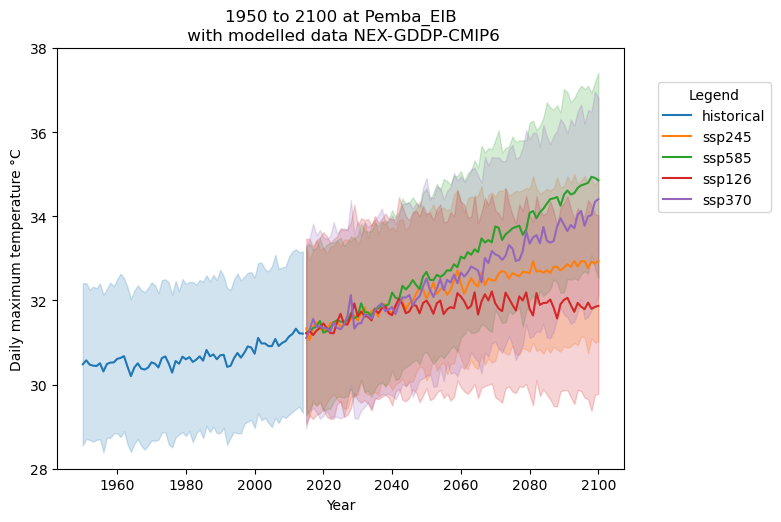

In [13]:
plot_title='max_temp_'+loc+'_1950-2100'
plot_lines(df_tasmax_NEXGDDPCMIP6_loc,'Year','Daily Maximum Near-Surface Air Temperature °C','Experiment','NEX-GDDP-CMIP6','Daily maximum temperature °C','',loc,y_start=1950,y_stop=2100,tuple_error_bar=('pi',80))
plt.savefig(plot_title+'.svg', bbox_inches='tight')

In [189]:
df_yearly_avg_tasmax_NEXGDDPCMIP6_loc=temporal_avg(df_tasmax_NEXGDDPCMIP6_loc,'temperature','Yearly average maximum temperature','year')

In [190]:
df_yearly_avg_tasmax_NEXGDDPCMIP6_loc.reset_index()

,Name project,Experiment,Model,Year,Yearly average maximum temperature
0,WTP_Mutua_EIB,historical,ACCESS-CM2,1950,30.233863
1,WTP_Mutua_EIB,historical,ACCESS-CM2,1951,29.142094
2,WTP_Mutua_EIB,historical,ACCESS-CM2,1952,30.014032
3,WTP_Mutua_EIB,historical,ACCESS-CM2,1953,29.322159
4,WTP_Mutua_EIB,historical,ACCESS-CM2,1954,29.323697
...,...,...,...,...,...
5721,WTP_Mutua_EIB,ssp585,TaiESM1,2096,41.472748
5722,WTP_Mutua_EIB,ssp585,TaiESM1,2097,40.648567
5723,WTP_Mutua_EIB,ssp585,TaiESM1,2098,39.462682
5724,WTP_Mutua_EIB,ssp585,TaiESM1,2099,42.749100


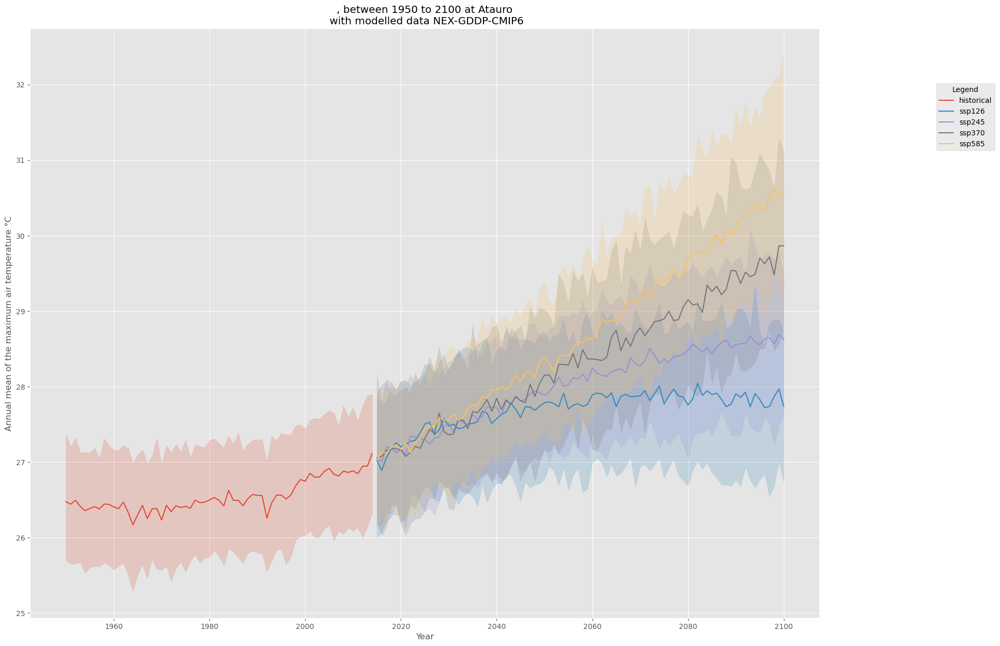

In [107]:
plot_title='max_temp_'+loc+'_1950-2100'
plot_lines(df_yearly_avg_tasmax_NEXGDDPCMIP6_loc,'Year','Yearly average maximum temperature','Experiment','NEX-GDDP-CMIP6','Annual mean of the maximum air temperature °C','',loc,y_start=1950,y_stop=2100,tuple_error_bar=('pi',80))
plt.savefig(plot_title+'.svg', bbox_inches='tight')

In [191]:
#df_yearly_avg_tasmax_NEXGDDPCMIP6_loc=temporal_avg(df_tasmax_NEXGDDPCMIP6,'temperature','Yearly average maximum temperature','year')
df_yearly_max_tasmax_NEXGDDPCMIP6_loc=temporal_max(df_tasmax_NEXGDDPCMIP6_loc,'temperature','Yearly maximum temperature','year')
df_yearly_max_tasmax_NEXGDDPCMIP6_loc=df_yearly_max_tasmax_NEXGDDPCMIP6_loc.reset_index()


### cdf_curves - tasmax -yearly max 

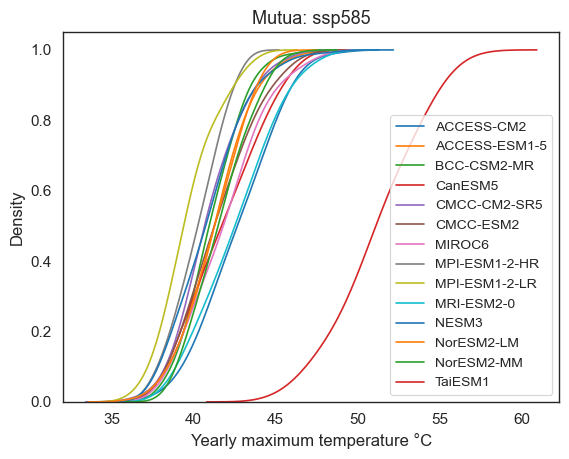

In [199]:
# CDF-curves for Models with different scenarios 
var='yearly maximum temperature'
scenario='ssp585' #'ssp126', ssp245', 'ssp370','ssp585'
models=['ACCESS-CM2', 'ACCESS-ESM1-5', 'BCC-CSM2-MR', 'CanESM5',
       'CMCC-CM2-SR5', 'CMCC-ESM2', 'MIROC6', 'MPI-ESM1-2-HR',
       'MPI-ESM1-2-LR', 'MRI-ESM2-0', 'NESM3', 'NorESM2-LM', 'NorESM2-MM',
       'TaiESM1'] 
loc_= loc.replace('_','') 
loc_=loc_.replace('WTP','')
loc_=loc_.replace('EIB','')

df=df_yearly_max_tasmax_NEXGDDPCMIP6_loc[df_yearly_max_tasmax_NEXGDDPCMIP6_loc['Experiment']==scenario]

f, ax = plt.subplots()
for m in models:
    df_mod=df[df['Model']==m]
    ax = sns.kdeplot(df_mod['Yearly maximum temperature'], cumulative=True) #°C
ax.legend(labels=models,fontsize=10)
ax.grid(False)
sns.set_context( rc={"axes.titlesize":13,"axes.labelsize":12})  
ax.tick_params(labelsize=11)
plt.xlabel('Yearly maximum temperature °C')
sns.set_style("white")
sns.set_style(rc = {'axes.facecolor': 'white'})
title=loc_+ ':'+' '+scenario
plt.title(title)
f.tight_layout#
f.savefig(loc+'_tasmax_yearlyMax_'+scenario+ '.svg', bbox_inches='tight')

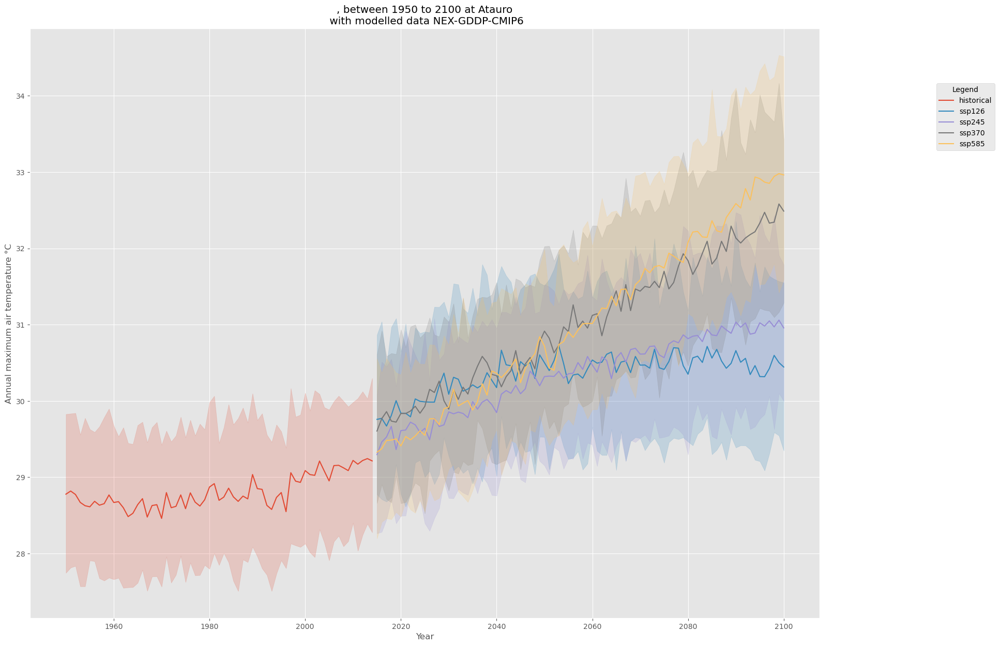

In [109]:
plot_lines(df_yearly_max_tasmax_NEXGDDPCMIP6_loc,'Year','Yearly maximum temperature','Experiment','NEX-GDDP-CMIP6','Annual maximum air temperature °C','',loc,y_start=1950,y_stop=2100,tuple_error_bar=('pi',80))

#### Vulnerability - Exposure - Event : Daily maximum temperature above 40 °

In [113]:
# statistical distribution for daily maximum temperature past and future
df_tasmax_NEXGDDPCMIP6_past = filter_dataframe(df_tasmax_NEXGDDPCMIP6,[loc],['TaiESM1','CMCC-CM2-SR5','NESM3'],start_y=1970,stop_y=2014)

df_stat_distr_tasmax_NEXGDDPCMIP6_loc_past = df_stat_distr(df_tasmax_NEXGDDPCMIP6_past[['Name project','Daily Maximum Near-Surface Air Temperature °C']])
df_stat_distr_tasmax_NEXGDDPCMIP6_loc_future = df_stat_distr(df_tasmax_NEXGDDPCMIP6_future[['Name project','Daily Maximum Near-Surface Air Temperature °C']])

In [114]:
df_stat_distr_tasmax_NEXGDDPCMIP6_loc_past

Daily Maximum Near-Surface Air Temperature °C             \
                                                     count       mean   
Name project                                                            
Atauro                                            180741.0  27.210589   

                                                                             
                   std        min      10%        50%        90%        max  
Name project                                                                 
Atauro        1.048319  22.617554  25.7229  27.333344  28.471069  31.034637

In [115]:
df_stat_distr_tasmax_NEXGDDPCMIP6_loc_future

Daily Maximum Near-Surface Air Temperature °C             \
                                                     count       mean   
Name project                                                            
Atauro                                            722964.0  28.519288   

                                                                              
                   std        min       10%        50%        90%        max  
Name project                                                                  
Atauro        1.247574  22.551086  26.83606  28.585052  30.076874  33.408264

In [121]:
changes_past_future_indicator_tasmax=changes_in_indicators(df_stat_distr_tasmax_NEXGDDPCMIP6_loc_past,df_stat_distr_tasmax_NEXGDDPCMIP6_loc_future,'Daily maximum air temperature', '°C','Extreme air temperature increase')
changes_past_future_indicator_tasmax#![image-3.png](attachment:image-3.png)

Extreme air temperature increase                            \
          Daily maximum air temperature                             
          Median for the past period °C Change in the median in %   
Atauro                        27.333344                  4.579421   

                                                                             \
                                                                              
       10-th percentile for the past period °C Change in 10-th percentile %   
Atauro                                 25.7229                     4.327503   

                                                                             
                                                                             
       90-th percentile for the past period °C Change in 90-th percentile %  
Atauro                               28.471069                     5.640127

In [122]:
df = pd.DataFrame()

In [123]:
df = pd.concat([changes_past_future_indicator_tas,changes_past_future_indicator_tasmax],axis=1)
df

Incremental air temperature change                            \
            Mean air temperature per year                             
            Median for the past period °C Change in the median in %   
Atauro                          26.928849                  5.066217   

                                                                             \
                                                                              
       10-th percentile for the past period °C Change in 10-th percentile %   
Atauro                               26.545754                     4.304537   

                                                                             \
                                                                              
       90-th percentile for the past period °C Change in 90-th percentile %   
Atauro                                27.30316                     6.851734   

       Extreme air temperature increase                            \
          Daily maximum air temperature                             
          Median for the past period °C Change in the median in %   
Atauro                        27.333344                  4.579421   

                                                                             \
                                                                              
       10-th percentile for the past period °C Change in 10-th percentile %   
Atauro                                 25.7229                     4.327503   

                                                                             
                                                                             
       90-th percentile for the past period °C Change in 90-th percentile %  
Atauro                               28.471069                     5.640127

#### Risk - Likelihood - Daily maximum temperature above 40 °

In [ ]:
(proba_event_accross_model_and_ssp_loc_tasmax_daily,likelihood_accross_model_and_ssp_loc_tasmax_daily)=likelihood_accross_models_and_ssps(df_tasmax_NEXGDDPCMIP6_future[['Experiment','Model','Daily Maximum Near-Surface Air Temperature °C']].dropna(),'tasmax','°C','Daily Maximum Near-Surface Air Temperature °C',40,'>')

In [ ]:
proba_event_accross_model_and_ssp_loc_tasmax_daily # result : 0.01264346317692103

In [ ]:
likelihood_accross_model_and_ssp_loc_tasmax_daily # result Rare

### maximum temperature in year

In [29]:
df_tasmax_NEXGDDPCMIP6_past_max_per_year= temporal_max(df_tasmax_NEXGDDPCMIP6_past[['Name project','Experiment','Model','Year','Daily Maximum Near-Surface Air Temperature °C']],'temperature','Daily Maximum Near-Surface Air Temperature °C','year')

In [30]:
df_tasmax_NEXGDDPCMIP6_future_max_per_year= temporal_max(df_tasmax_NEXGDDPCMIP6_future[['Name project','Experiment','Model','Year','Daily Maximum Near-Surface Air Temperature °C']],'temperature','Daily Maximum Near-Surface Air Temperature °C','year')

In [31]:
df_tasmax_NEXGDDPCMIP6_future_max_per_year = df_tasmax_NEXGDDPCMIP6_future_max_per_year.rename(columns={'Daily Maximum Near-Surface Air Temperature °C':'Yearly Maximum Near-Surface Air Temperature °C'})

In [32]:
df_tasmax_NEXGDDPCMIP6_past_max_per_year = df_tasmax_NEXGDDPCMIP6_past_max_per_year.rename(columns={'Daily Maximum Near-Surface Air Temperature °C':'Yearly Maximum Near-Surface Air Temperature °C'})

#### Vulnerability - Exposure - Maximum temperature per year

In [98]:
df_stat_distr_max_temp_past=df_stat_distr(df_tasmax_NEXGDDPCMIP6_past_max_per_year.reset_index()[['Name project','Yearly Maximum Near-Surface Air Temperature °C']])
df_stat_distr_max_temp_future=df_stat_distr(df_tasmax_NEXGDDPCMIP6_future_max_per_year.reset_index()[['Name project','Yearly Maximum Near-Surface Air Temperature °C']])

NameError: name 'df_tasmax_NEXGDDPCMIP6_past_max_per_year' is not defined

In [ ]:
df_stat_distr_max_temp_past
#![image-2.png](attachment:image-2.png)

In [ ]:
df_stat_distr_max_temp_future
#![image-2.png](attachment:image-2.png)

In [34]:
changes_past_future_indicator_tasmax_yearly_max=changes_in_indicators(df_stat_distr_max_temp_past,df_stat_distr_max_temp_future,'Yearly maximum air temperature', '°C','Extreme air temperature increase')
changes_past_future_indicator_tasmax_yearly_max

In [ ]:
df = pd.concat([df,changes_past_future_indicator_tasmax_yearly_max],axis=1)

#### Risk - Likelihood, temperature above 40 degrees

In [ ]:
(proba_event_accross_model_and_ssp_loc_tasmax_yearly,likelihood_accross_model_and_ssp_loc_tasmax_yearly)=likelihood_accross_models_and_ssps(df_tasmax_NEXGDDPCMIP6_future_max_per_year.reset_index()[['Experiment','Model','Daily Maximum Near-Surface Air Temperature °C']].dropna(),'tasmax','°C','Daily Maximum Near-Surface Air Temperature °C',40,'>')

In [ ]:
proba_event_accross_model_and_ssp_loc_tasmax_yearly*100 # 0.6629380428544061

In [ ]:
likelihood_accross_model_and_ssp_loc_tasmax_yearly # 'Likely'

### Number of days above 40 - as done in ccpk, work with max temp

In [37]:
df_tasmax_NEXGDDPCMIP6_days_above_40 = number_day_above_threshold(df_tasmax_NEXGDDPCMIP6_loc,'Maximum Air Temperature','Daily Maximum Near-Surface Air Temperature °C',40)

In [38]:
df_tasmax_NEXGDDPCMIP6_days_above_40

Average annual number of days with Maximum Air Temperature above 40
Name project  Experiment Model      Year                                                                     
Gorongosa_EIB historical ACCESS-CM2 1950                                                  0                  
                                    1951                                                  0                  
                                    1952                                                  0                  
                                    1953                                                  0                  
                                    1954                                                  0                  
...                                                                                     ...                  
              ssp585     NorESM2-MM 2096                                                 19                  
                                    2097                                                 14                  
                                    2098                                                 18                  
                                    2099                                                 25                  
                                    2100                                                 42                  

[4499 rows x 1 columns]

plot_lines(df_tasmax_NEXGDDPCMIP6_days_above_40,'Year','Average annual number of days with Maximum Air Temperature above 40','Experiment','NEX-GDDP-CMIP6','Number of days with air temperature above 40°C','','Gorongosa',y_start=1950,y_stop=2100,tuple_error_bar=('pi',80))
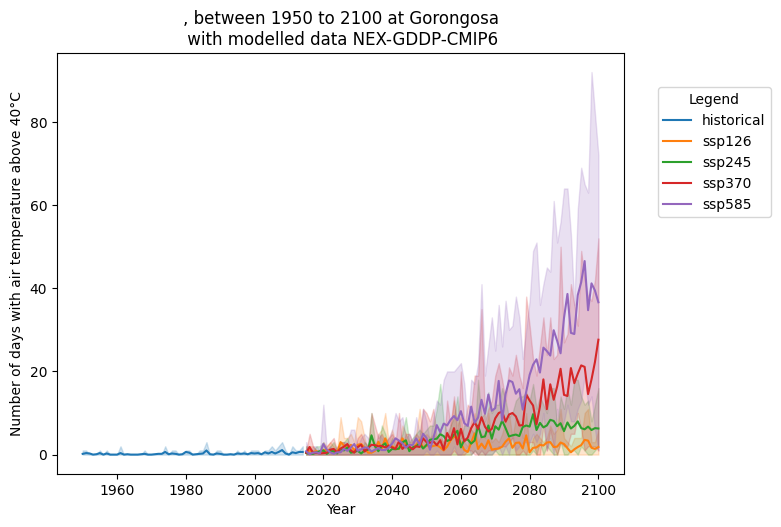

In [82]:
df_tasmax_NEXGDDPCMIP6_past_days_above_40 = number_day_above_threshold(df_tasmax_NEXGDDPCMIP6_past,'Maximum Air Temperature','Daily Maximum Near-Surface Air Temperature °C',40)

NameError: name 'df_tasmax_NEXGDDPCMIP6_past' is not defined

In [40]:
df_tasmax_NEXGDDPCMIP6_future_days_above_40 = number_day_above_threshold(df_tasmax_NEXGDDPCMIP6_future,'Maximum Air Temperature','Daily Maximum Near-Surface Air Temperature °C',40)

In [41]:
df_tasmax_NEXGDDPCMIP6_future_days_above_40

Average annual number of days with Maximum Air Temperature above 40
Name project  Experiment Model      Year                                                                     
Gorongosa_EIB ssp126     ACCESS-CM2 2030                                                  1                  
                                    2031                                                  3                  
                                    2032                                                  4                  
                                    2033                                                  2                  
                                    2034                                                  1                  
...                                                                                     ...                  
              ssp585     NorESM2-MM 2070                                                  3                  
                                    2071                                                  5                  
                                    2072                                                  5                  
                                    2073                                                  8                  
                                    2074                                                  9                  

[1980 rows x 1 columns]

#### Vulnerability - Number of days above 40 

In [97]:
df_stat_distr_max_temp_past_days_above_40=df_stat_distr(df_tasmax_NEXGDDPCMIP6_past_days_above_40.reset_index()[['Name project','Average annual number of days with Maximum Air Temperature above 40']])
df_stat_distr_max_temp_future_days_above_40=df_stat_distr(df_tasmax_NEXGDDPCMIP6_future_days_above_40.reset_index()[['Name project','Average annual number of days with Maximum Air Temperature above 40']])

NameError: name 'df_tasmax_NEXGDDPCMIP6_past_days_above_40' is not defined

In [43]:
df_stat_distr_max_temp_past_days_above_40

Average annual number of days with Maximum Air Temperature above 40  \
                                                                            count   
Name project                                                                        
Gorongosa_EIB                                              495.0                    

                                                            
                   mean       std  min  10%  50%  90%  max  
Name project                                                
Gorongosa_EIB  0.284848  0.695323  0.0  0.0  0.0  1.0  5.0

In [44]:
df_stat_distr_max_temp_future_days_above_40

Average annual number of days with Maximum Air Temperature above 40  \
                                                                            count   
Name project                                                                        
Gorongosa_EIB                                             1980.0                    

                                                              
                   mean       std  min  10%  50%   90%   max  
Name project                                                  
Gorongosa_EIB  3.916162  6.521395  0.0  0.0  2.0  11.0  67.0

In [45]:
changes_past_future_indicator_tasmax_days_above_40=changes_in_indicators(df_stat_distr_max_temp_past_days_above_40,df_stat_distr_max_temp_future_days_above_40,'Number of days with maximum air temperature above 40°C', '[-]','Extreme air temperature increase')

In [46]:
changes_past_future_indicator_tasmax_days_above_40

Extreme air temperature increase  \
              Number of days with maximum air temperature above 40°C   
                                      Median for the past period [-]   
Gorongosa_EIB                                                0.0       

                                         \
                                          
              Change in the median in %   
Gorongosa_EIB                       inf   

                                                        \
                                                         
              10-th percentile for the past period [-]   
Gorongosa_EIB                                      0.0   

                                            \
                                             
              Change in 10-th percentile %   
Gorongosa_EIB                          NaN   

                                                        \
                                                         
              90-th percentile for the past period [-]   
Gorongosa_EIB                                      1.0   

                                            
                                            
              Change in 90-th percentile %  
Gorongosa_EIB                       1000.0

In [47]:
changes_past_future_indicator_tasmax_days_above_40[[('Extreme air temperature increase','Number of days with maximum air temperature above 40°C','Change in the median in %')]]='Low'

In [48]:
changes_past_future_indicator_tasmax_days_above_40[[('Extreme air temperature increase','Number of days with maximum air temperature above 40°C','Change in 10-th percentile %')]]='Low'

In [49]:
changes_past_future_indicator_tasmax_days_above_40[[('Extreme air temperature increase','Number of days with maximum air temperature above 40°C','Change in 90-th percentile %')]]='Medium'

In [50]:
changes_past_future_indicator_tasmax_days_above_40

Extreme air temperature increase  \
              Number of days with maximum air temperature above 40°C   
                                      Median for the past period [-]   
Gorongosa_EIB                                                0.0       

                                         \
                                          
              Change in the median in %   
Gorongosa_EIB                       Low   

                                                        \
                                                         
              10-th percentile for the past period [-]   
Gorongosa_EIB                                      0.0   

                                            \
                                             
              Change in 10-th percentile %   
Gorongosa_EIB                          Low   

                                                        \
                                                         
              90-th percentile for the past period [-]   
Gorongosa_EIB                                      1.0   

                                            
                                            
              Change in 90-th percentile %  
Gorongosa_EIB                       Medium

changes_past_future_indicator_tasmax_days_above_40
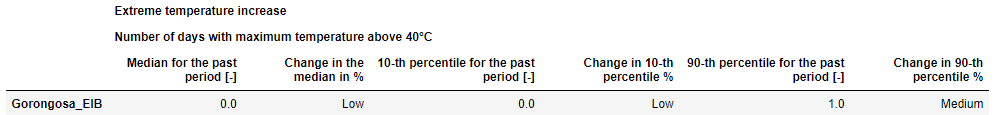

In [51]:
df = pd.concat([df,changes_past_future_indicator_tasmax_days_above_40],axis=1)

#### Risk - Likelihood, temperature above 40 degrees

In [ ]:
(proba_event_accross_model_and_ssp_gorongosa_tasmax_above40,likelihood_accross_model_and_ssp_gorongosa_tasmax_above40)=likelihood_accross_models_and_ssps(df_tasmax_NEXGDDPCMIP6_future_days_above_40.reset_index()[['Experiment','Model','Average annual number of days with Maximum Temperature above 40']].dropna(),'tasmax','°C','Average annual number of days with Maximum Temperature above 40',30,'>')

In [ ]:
proba_event_accross_model_and_ssp_gorongosa_tasmax_above40 # more than 30 number of days above 40 degrees per year : 0.028626984761512878

In [ ]:
0.028626984761512878*100

In [ ]:
likelihood_accross_model_and_ssp_gorongosa_tasmax_above40 # more than 30 number of days above 40 degrees per year :'Rare'

### Exposure and vulnerability

In [55]:
ExposureLevel_ = level_exposure(df)
df_sen = sensitivity()
df_v = vulnerability(df_sen,ExposureLevel_)

For project Gorongosa_EIB, climate variable Extreme air temperature increase
[('Extreme air temperature increase', 'Number of days with maximum air temperature above 40°C', 'Change in 10-th percentile %')]
Low
<class 'str'>
string
For project Gorongosa_EIB, climate variable Extreme air temperature increase
[('Extreme air temperature increase', 'Daily maximum air temperature', 'Change in 10-th percentile %')]
For project Gorongosa_EIB, climate variable Extreme air temperature increase
[('Extreme air temperature increase', 'Yearly maximum air temperature', 'Change in 10-th percentile %')]
For project Gorongosa_EIB, climate variable Incremental air temperature change
[('Incremental air temperature change', 'Mean air temperature per year', 'Change in 10-th percentile %')]
6.188156350087923
<class 'numpy.float64'>
Gorongosa_EIB
Medium exposure
No exposure
Medium exposure
No exposure
Medium exposure
No exposure
Medium exposure
No exposure


In [56]:
df_sen

Sensitivity level  \
                                           Incremental air temperature change   
Name project  Sensitivity theme                                                 
Gorongosa_EIB On-site assets and processes                             Medium   
              Inputs                                                       No   
              Output                                                       No   
              Transport links                                              No   

                                                                             
                                           Extreme air temperature increase  
Name project  Sensitivity theme                                              
Gorongosa_EIB On-site assets and processes                           Medium  
              Inputs                                                     No  
              Output                                                     No  
              Transport links                                            No

In [57]:
df_v

Vulnerability level  \
                                           Incremental air temperature change   
Name project  Sensitivity theme                                                 
Gorongosa_EIB On-site assets and processes                                 No   
              Inputs                                                       No   
              Output                                                       No   
              Transport links                                              No   

                                                                             
                                           Extreme air temperature increase  
Name project  Sensitivity theme                                              
Gorongosa_EIB On-site assets and processes                           Medium  
              Inputs                                                     No  
              Output                                                     No  
              Transport links                                            No

In [58]:
ExposureLevel_

Exposure level  \
              Extreme air temperature increase   
Gorongosa_EIB                           Medium   

                                                  
              Incremental air temperature change  
Gorongosa_EIB                                 No

Exposure level
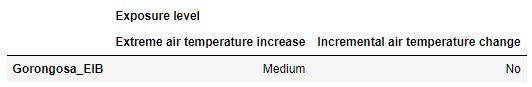
df_v
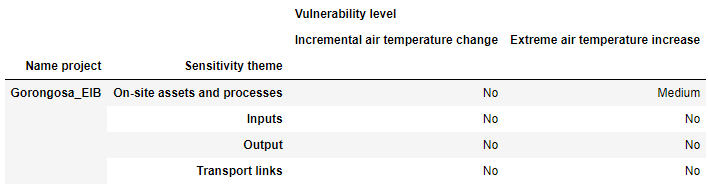

<a id='NEXGDDPCMIP6_Precipitation'></a>
## NEX-GDDP-CMIP6 Precipitation
Those data were not bias corrected a second time

In [ ]:
df_pr = pd.DataFrame()

In [ ]:
# import data
df_pr_NEXGDDPCMIP6=import_treat_modeled_NEX_GDDP_CMIP6('pr','mm_per_day','day',1950,2100)
df_pr_NEXGDDPCMIP6_gorongosa_past = filter_dataframe(df_pr_NEXGDDPCMIP6,['Gorongosa_EIB'],['TaiESM1','CMCC-CM2-SR5','NESM3'],start_y=1970,stop_y=2014)
df_pr_NEXGDDPCMIP6_gorongosa_future = filter_dataframe(df_pr_NEXGDDPCMIP6,['Gorongosa_EIB'],['TaiESM1','CMCC-CM2-SR5','NESM3'],start_y=2030,stop_y=2074)

In [ ]:
df_pr_NEXGDDPCMIP6_annual_mean = temporal_avg(df_pr_NEXGDDPCMIP6,'precipitation','Annual mean precipitation','year')

In [ ]:
plot_lines(df_pr_NEXGDDPCMIP6_annual_mean,'Year','Annual mean precipitation','Experiment','NEX-GDDP-CMIP6','Annual mean precipitation mm per year','','Gorongosa',y_start=1950,y_stop=2100,tuple_error_bar=('pi',80))

result plot_lines
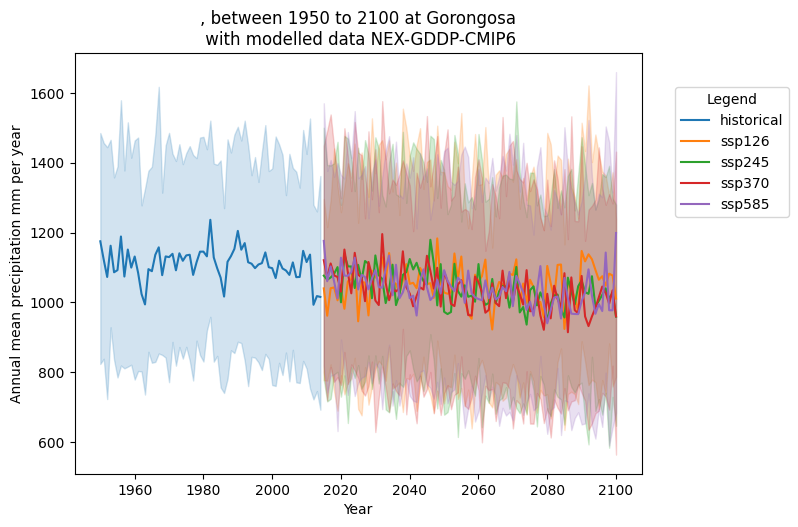

In [ ]:
trends_month('precipitation',df_pr_NEXGDDPCMIP6,'NEX-GDDP-CMIP6',pd.DataFrame(),'','Average','Gorongosa',temporal_resolution='Month',start_year_line=1970,stop_year_line=2014,start_year_boxplot=1950,stop_year_boxplot=2100,dry_season='yes')

result for trend month for the entire year 
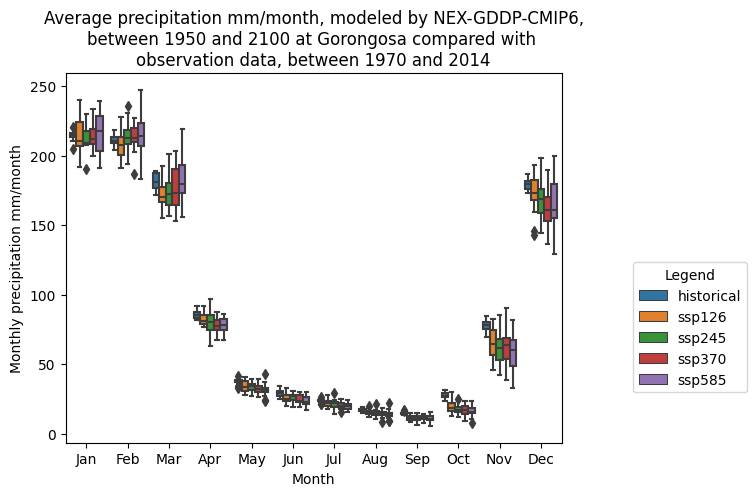

result trend month for the dry season
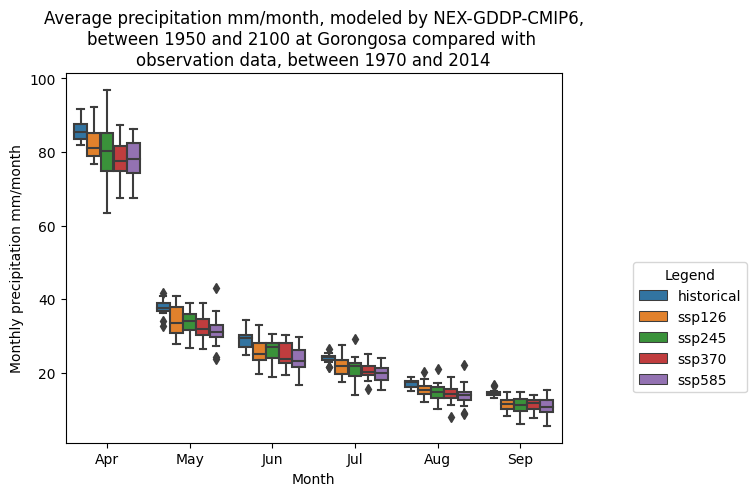

### Average monthly precipitation

In [ ]:
df_monthly_pr_NEXGDDPCMIP6_gorongosa_past=temporal_avg(df_pr_NEXGDDPCMIP6_gorongosa_past,'precipitation','Monthly average precipitation','month')
df_monthly_pr_NEXGDDPCMIP6_gorongosa_future=temporal_avg(df_pr_NEXGDDPCMIP6_gorongosa_future,'precipitation','Monthly average precipitation','month')

#### Vulnerability

In [ ]:
# statistical distribution for monthly average precipitation past and future
df_stat_distr_monthly_pr_NEXGDDPCMIP6_gorongosa_past = df_stat_distr(df_monthly_pr_NEXGDDPCMIP6_gorongosa_past.reset_index()[['Name project','Monthly average precipitation']])
df_stat_distr_monthly_pr_NEXGDDPCMIP6_gorongosa_future = df_stat_distr(df_monthly_pr_NEXGDDPCMIP6_gorongosa_future.reset_index()[['Name project','Monthly average precipitation']])

In [ ]:
df_stat_distr_monthly_pr_NEXGDDPCMIP6_gorongosa_past

In [ ]:
df_stat_distr_monthly_pr_NEXGDDPCMIP6_gorongosa_future

In [ ]:
changes_past_future_indicator_monthly_pr_NEXGDDPCMIP6_gorongosa=changes_in_indicators(df_stat_distr_monthly_pr_NEXGDDPCMIP6_gorongosa_past,df_stat_distr_monthly_pr_NEXGDDPCMIP6_gorongosa_future,'Monthly average precipitation', 'mm per month','Incremental rainfall change')

In [ ]:
changes_past_future_indicator_monthly_pr_NEXGDDPCMIP6_gorongosa

In [ ]:
changes_past_future_indicator_monthly_pr_NEXGDDPCMIP6_gorongosa

### Average wet seasonal precipitation

In [ ]:
df_wetSeason_pr_NEXGDDPCMIP6_gorongosa_past=temporal_avg(df_pr_NEXGDDPCMIP6_gorongosa_past[df_pr_NEXGDDPCMIP6_gorongosa_past['Season']=='Humid'],'precipitation','Wet season monthly average precipitation mm','month')
df_wetSeason_pr_NEXGDDPCMIP6_gorongosa_future=temporal_avg(df_pr_NEXGDDPCMIP6_gorongosa_future[df_pr_NEXGDDPCMIP6_gorongosa_future['Season']=='Humid'],'precipitation','Wet season monthly average precipitation mm','month')

#### Vulnerability

In [ ]:
# statistical distribution for daily maximum temperature past and future
df_stat_distr_wetSeason_pr_NEXGDDPCMIP6_gorongosa_past = df_stat_distr(df_wetSeason_pr_NEXGDDPCMIP6_gorongosa_past.reset_index()[['Name project','Wet season monthly average precipitation mm']])
df_stat_distr_wetSeason_pr_NEXGDDPCMIP6_gorongosa_future = df_stat_distr(df_wetSeason_pr_NEXGDDPCMIP6_gorongosa_future.reset_index()[['Name project','Wet season monthly average precipitation mm']])

df_stat_distr_wetSeason_pr_NEXGDDPCMIP6_gorongosa_past
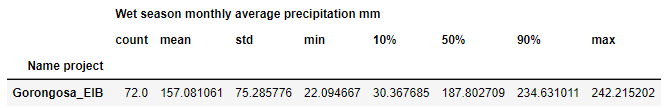

df_stat_distr_wetSeason_pr_NEXGDDPCMIP6_gorongosa_future
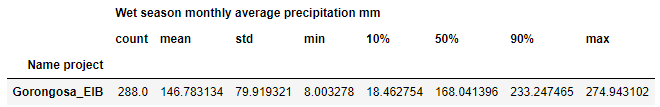

In [ ]:
changes_past_future_indicator_monthlyWetSeason_pr_NEXGDDPCMIP6_gorongosa=changes_in_indicators(df_stat_distr_wetSeason_pr_NEXGDDPCMIP6_gorongosa_past,df_stat_distr_wetSeason_pr_NEXGDDPCMIP6_gorongosa_future,'Monthly average precipitation during wet season', 'mm per month','Incremental rainfall change')

In [ ]:
changes_past_future_indicator_monthlyWetSeason_pr_NEXGDDPCMIP6_gorongosa[[('Incremental rainfall change','Monthly average precipitation during wet season','Change in 10-th percentile %')]]='Low'

changes_past_future_indicator_monthlyWetSeason_pr_NEXGDDPCMIP6_gorongosa
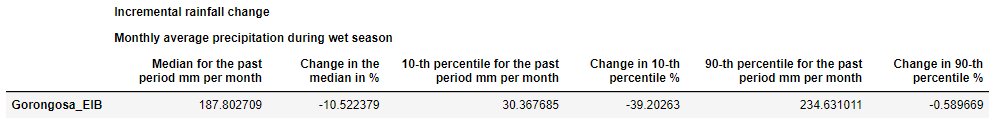

### Maximum 5 day rainfall

In [ ]:
df_pr_NEXGDDPCMIP6_gorongosa_past_5_day_event=dataframe_max_5_days_event(df_pr_NEXGDDPCMIP6_gorongosa_past,5)

In [ ]:
df_pr_NEXGDDPCMIP6_gorongosa_future_5_day_event=dataframe_max_5_days_event(df_pr_NEXGDDPCMIP6_gorongosa_future,5)

#### Vulnerability

In [ ]:
# statistical distribution for temperature past and future
df_stat_distr_5dayevent_pr_NEXGDDPCMIP6_gorongosa_past = df_stat_distr(df_pr_NEXGDDPCMIP6_gorongosa_past_5_day_event.reset_index()[['Name project','5 days rainfall mm']])
df_stat_distr_5dayevent_pr_NEXGDDPCMIP6_gorongosa_future = df_stat_distr(df_pr_NEXGDDPCMIP6_gorongosa_future_5_day_event.reset_index()[['Name project','5 days rainfall mm']])

df_stat_distr_5dayevent_pr_NEXGDDPCMIP6_gorongosa_past
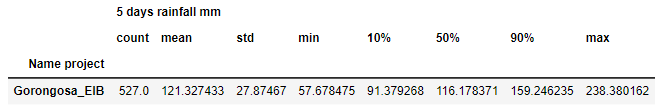

df_stat_distr_5dayevent_pr_NEXGDDPCMIP6_gorongosa_future
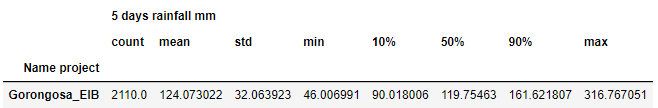

In [ ]:
changes_past_future_indicator_5dayevent_pr=changes_in_indicators(df_stat_distr_5dayevent_pr_NEXGDDPCMIP6_gorongosa_past,df_stat_distr_5dayevent_pr_NEXGDDPCMIP6_gorongosa_future,'Maximum five days rainfall', 'mm','Extreme rainfall change')

In [ ]:
changes_past_future_indicator_5dayevent_pr

changes_past_future_indicator_5dayevent_pr
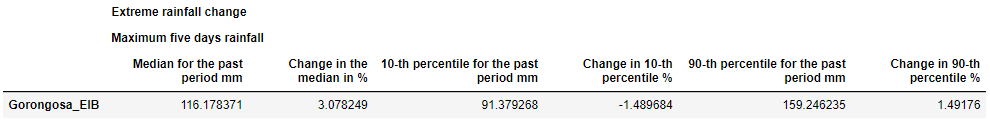

In [ ]:
df_pr=pd.concat([changes_past_future_indicator_monthlyWetSeason_pr_NEXGDDPCMIP6_gorongosa,changes_past_future_indicator_5dayevent_pr],axis=1)

#### Risk

In [ ]:
# as the elements of the project is not vulnerable regarding yearly temperature, no need to do risk assessment
(proba_event_accross_model_and_ssp_gorongosa_pr_5day,likelihood_accross_model_and_ssp_gorongosa_pr_5day)=likelihood_accross_models_and_ssps(df_pr_NEXGDDPCMIP6_gorongosa_future_5_day_event.reset_index(),'pr','mm_per_5day','Yearly average temperature',116,'>')

In [ ]:
proba_event_accross_model_and_ssp_gorongosa_pr_5day

In [ ]:
likelihood_accross_model_and_ssp_gorongosa_pr_5day

### Future value of 100 years event

In [ ]:
df_return_period_pr_past=dataframe_threshold_coresponding_to_return_period_model(df_pr_NEXGDDPCMIP6_gorongosa_past.dropna(),'Mean of the daily precipitation rate mm_per_day')

In [ ]:
df_return_period_pr_future=dataframe_threshold_coresponding_to_return_period_model(df_pr_NEXGDDPCMIP6_gorongosa_future.dropna(),'Mean of the daily precipitation rate mm_per_day')

In [ ]:
df_return_period_pr_past['Value for return period 100 years mm/day'] = df_return_period_pr_past['Value for return period 100 years mm/day'].astype(int)

In [ ]:
df_return_period_pr_future['Value for return period 100 years mm/day'] = df_return_period_pr_future['Value for return period 100 years mm/day'].astype(int)

#### Vulnerability

In [ ]:
# statistical distribution for temperature past and future
df_stat_distr_100year_event_pr_NEXGDDPCMIP6_gorongosa_past = df_stat_distr(df_return_period_pr_past.reset_index()[['Name project','Value for return period 100 years mm/day']])
df_stat_distr_100year_event_pr_NEXGDDPCMIP6_gorongosa_future = df_stat_distr(df_return_period_pr_future.reset_index()[['Name project','Value for return period 100 years mm/day']])

df_stat_distr_100year_event_pr_NEXGDDPCMIP6_gorongosa_past
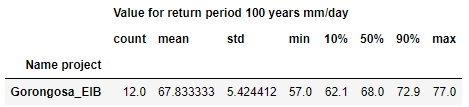

df_stat_distr_100year_event_pr_NEXGDDPCMIP6_gorongosa_future
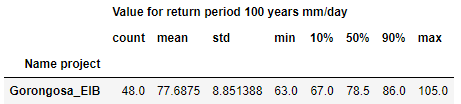

In [ ]:
changes_past_future_indicator_100year_event_pr=changes_in_indicators(df_stat_distr_100year_event_pr_NEXGDDPCMIP6_gorongosa_past,df_stat_distr_100year_event_pr_NEXGDDPCMIP6_gorongosa_future,'100 year event', 'mm/day','Extreme rainfall change')

changes_past_future_indicator_100year_event_pr
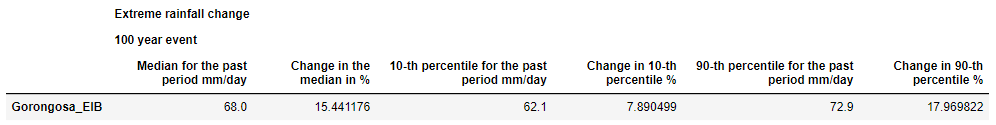

In [ ]:
df_pr=pd.concat([df_pr,changes_past_future_indicator_100year_event_pr],axis=1)

#### Risk

In [ ]:
# as the elements of the project is not vulnerable regarding yearly temperature, no need to do risk assessment
(proba_event_accross_model_and_ssp_gorongosa_pr_100yearevent,likelihood_accross_model_and_ssp_gorongosa_pr_100yeareven)=likelihood_accross_models_and_ssps(df_return_period_pr_future.reset_index(),'pr','mm_per_5day','Yearly average temperature',68,'>')

### Future return period of one day rainfall event with a current return of 100 years

In [ ]:
df_=dataframe_return_period_coresponding_to_past_100year_event_model(df_pr_NEXGDDPCMIP6_gorongosa_future.dropna(),'Mean of the daily precipitation rate mm_per_day',df_return_period_pr_past)

In [ ]:
df_

### Exposure for precipitation

In [ ]:
ExposureLevel_pr = level_exposure(df_pr)
df_sen = sensitivity()
df_v_pr = vulnerability(df_sen,ExposureLevel_pr)

In [ ]:
df_pr

In [ ]:
df_sen

In [ ]:
ExposureLevel_pr

In [ ]:
df_v_pr

ExposureLevel_pr
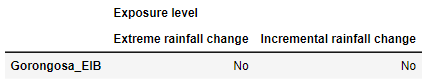

df_v_pr
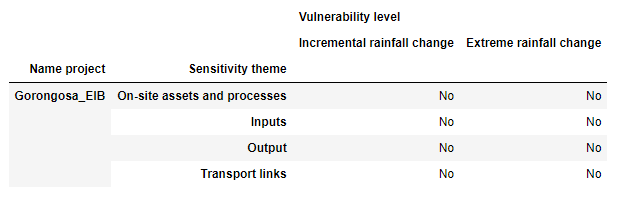

<a id='wind'></a>
## Wind Speed

Daily wind speed, historical and projected.

In [ ]:
def convert_wind_unit(i):
    # convert wind unit from m.s-1 too km per h
    i = i*3.6
    return i

In [ ]:
# import data
df_Wind_NEXGDDPCMIP6=import_treat_modeled_NEX_GDDP_CMIP6('sfcWind','m_s-1','day',1950,2100)
df_Wind_NEXGDDPCMIP6[['Daily-Mean Near-Surface Wind Speed m_s-1']]=df_Wind_NEXGDDPCMIP6[['Daily-Mean Near-Surface Wind Speed m_s-1']].applymap(convert_wind_unit)
df_Wind_NEXGDDPCMIP6_gorongosa_past = filter_dataframe(df_Wind_NEXGDDPCMIP6,['Gorongosa_EIB'],['TaiESM1','CMCC-CM2-SR5','NESM3'],start_y=1970,stop_y=2014)
df_Wind_NEXGDDPCMIP6_gorongosa_future = filter_dataframe(df_Wind_NEXGDDPCMIP6,['Gorongosa_EIB'],['TaiESM1','CMCC-CM2-SR5','NESM3'],start_y=2030,stop_y=2074)

<a id='humidity'></a>
## Humidity

Source : https://cds.climate.copernicus.eu/cdsapp#!/dataset/projections-cmip6?tab=form

### Relative humidity

Relative humidity of air: amount if moisture it contains compared to the maximum amount of moisture it can have at a specific temperature

### Extraction of Relative humidity data

In [ ]:
global_variable = 'Relative_Humidity'
name_variable = 'near_surface_relative_humidity' # only available on a monthly basis

#### Historical data

#### Projections

<a id='solar_radiation'></a>
## Solar radiation

In [ ]:
global_variable = 'Solar_radiation'
# choose of the climate variable from copernicus to represent : choose of surface_downwelling_shortwave_radiation because
# 1. interest for project located at the surface of the Earth
# 2. for most project (for example solar panels), we are interest in radiation going down, not up
# 3. Shortwave radiation are the ones produce by the sun
name_variable = 'surface_downwelling_shortwave_radiation' # only available on a monthly basis

#### Historical data for solar radiation

#### Projection for data solar radiation

<a id='land_climate_variables'></a>
# LAND

[Home](#beginning_CRVA)

<a id='landslides'></a>
## Landslides - Land

source: https://datacatalog.worldbank.org/search/dataset/0037584 (Global Landslide Hazard Map, The World Bank)

### Description of LS_TH : 
The Global Landslide Hazard Map presents a qualitative representation of global landslide hazard at a global scale. It is the combination of the The Global Landslide Hazard Map: Median Annual Rainfall-Triggered Landslide Hazard (1980-2018) and The Global Landslide Hazard Map: Earthquake-Triggered Landslide Hazard which has then been simplified to four rank categories, ranging from Very low to High landslide hazard, based on the existing system used by ThinkHazard! (www.thinkhazard.org)

### Description of LS_RF_Median_1980-2018 :
The Global Rainfall-Triggered Landslide Hazard Map presents a quantitative representation of landslide hazard. This component is the median annual rainfall-triggered landslide hazard assessment for the period 1980 – 2018. Raster values represent the modelled average annual frequency of significant rainfall-triggered landslides per sq. km.

In [ ]:

#Landslides data path
landslidesTH_path=os.path.join(data_folder,'landslides/wb_GlLandslHazard/ls_th/LS_TH.tif') ## Global landslide hazard map (TH ranks --> Think hazard ranks)
landslidesRF_path=os.path.join(data_folder,'landslides/wb_GlLandslHazard/ls_rf_median_1980-2018/LS_RF_Median_1980-2018.tif')

#spatial stats
projects['landslides_THmax']=pd.DataFrame(zonal_stats(vectors=projects_buf, raster=landslidesTH_path, 
                                                            all_touched=True, stats='max'))
projects['landslidesRF_medianMax']=pd.DataFrame(zonal_stats(vectors=projects_buf, raster=landslidesRF_path, 
                                                            all_touched=True, stats='max'))
#show table
projects[[project_id,'landslides_THmax','landslidesRF_medianMax']].head()

#plot landslides TH
fig, ax = plt.subplots()
landslides = rioxarray.open_rasterio(landslidesTH_path)
landslides_clip = landslides.rio.clip(study_area.geometry, study_area.crs, drop=True)
landslides_clip.plot(ax=ax, cmap='Reds',vmin=1, vmax=4)
points=projects.plot(ax=ax,cmap='Greys') # what are those points ????

#close
landslides.close()
landslides_clip.close()

# didn't achieved to present the RF datas
#plot landslides RF
#fig, ax = plt.subplots()
#landslides = rioxarray.open_rasterio(landslidesRF_path)
#landslides_clip = landslides.rio.clip(study_area.geometry, study_area.crs, drop=True)
#landslides_clip.plot(ax=ax, cmap='Reds',vmin=1, vmax=4)
#points=projects.plot(ax=ax,cmap='Greys') # what are those points ????
#landslides.close()

## Global wildfire hazard - Land

This jupyter notebook is to study the global wildfire hazard

Source : https://datacatalog.worldbank.org/search/dataset/0042058/Global-wildfire-hazard

Description of the source : The approach to classify wildfire hazard levels used is based solely on fire weather index climatology. Fire weather indices are used in many countries to assess both the onset of conditions that will allow fires to spread, as well as the likelihood of fire at any point in the landscape. The method presented uses statistical modelling (extreme value analysis) of a 30 year fire weather climatology to assess the predicted fire weather intensity for specific return period intervals. These intensities are classified based on thresholds using conventions to provide hazard classes that correspond to conditions that can support problematic fire spread in the landscape if an ignition and sufficient fuel were to be present.

Date of export : 23.03.23

Projection FWI for europe : https://cds.climate.copernicus.eu/cdsapp#!/dataset/sis-tourism-fire-danger-indicators?tab=overview

Projection seasonal severity rating of for EUrope : https://www.eea.europa.eu/data-and-maps/figures/projected-meteorological-forest-fire-danger

Calculation of the FWI : https://cwfis.cfs.nrcan.gc.ca/background/summary/fwi

GLOBAL PROJeTIONS NOT FOUND


## Soil erosion - Land

Source for global actual situations : https://data.jrc.ec.europa.eu/dataset/jrc-esdac-120

<a id='hydrosphere_climate_variables'></a>
# HYDROSPHERE

[Home](#beginning_CRVA)

<a id='relative_sea_level_rise'></a>
## Relative sea level rise

In [ ]:
## use copernicus or NASA data ? NASA data are in COWI servor \\COWI.net\projects\A245000\A248363\CRVA\Datasets\SeaLevelRise\Nasa
# use mean sea level > https://cds.climate.copernicus.eu/cdsapp#!/dataset/sis-water-level-change-indicators-cmip6?tab=overview

<a id='sea_water_temperature'></a>
## Sea water temperature

In [ ]:
global_variable = 'Sea_water_temperature'
name_variable = 'sea_surface_temperature' # only estimate for the surface in the copernicus CMIP6

#### Historical data

In [ ]:
(year_historical, year_str_historical, index_historical)=year_copernicus(1850,2014)
temporal_resolution = 'monthly'
# Register data from copernicus for humidity in a dataframe and production of a csv file for the period indicated above
Sea_water_temperature_historical = dataframe_csv_copernicus(temporal_resolution,year_str_historical,copernicus_elements.experiments_historical,copernicus_elements.models,out_path,global_variable, name_variable,area)    

#### Projection data

In [ ]:
(year, year_str, index)=year_copernicus(2020,2100)
temporal_resolution = 'monthly'
# Register data from copernicus for humidity in a dataframe and production of a csv file for the period indicated above
Sea_water_temperature = dataframe_csv_copernicus(temporal_resolution,year_str,copernicus_elements.experiments,copernicus_elements.models,out_path,global_variable, name_variable,area)    

<a id='water_availability'></a>
### Water availability
Represented with water stress

Did not find historical data, look into world bank

Source for projections from 2020 to 2050 : https://www.wri.org/data/aqueduct-water-stress-projections-data
Informations about how the shp is designed located here : data_folder, Water_Availability_WaterStress\aqueduct_projections_20150309_shp\aqueduct_projections_schematic_20140615 (excel sheet)

In [ ]:
## Projection of water stress
# register path to water stress data
water_stress_location_path=os.path.join(data_folder,'Water_Availability_WaterStress/aqueduct_projections_20150309_shp/aqueduct_projections_20150309.shp')
# register data in default projection 4326
water_stress = gpd.read_file(water_stress_location_path).to_crs(bCRS) # uncertain that projeciton is the default one
ws_geometry = water_stress.geometry # register geometry for later
# filter columns of dataframe that are not water stress related
elements_to_drop=('sv','ut','bt','r','u','c','20','BasinID','dwnBasinID','Shape_Leng','Shape_Le_1') # if a column contains a str in this list, the column should be drop
# 20 to remove the projections for 2020 (the projections were made in 2015)

for name_column_out in elements_to_drop:
    water_stress=water_stress.drop(water_stress.filter(regex=name_column_out).columns, axis=1)
    
# making name of columns more precise
# information on column names come from 
#\\COWI.net\projects\A245000\A248363\CRVA\Datasets\Water_Availability_WaterStress\aqueduct_projections_20150309_shp\aqueduct_projections_schematic_20140615
scenarios_ws=['ssp2_rcp45','ssp2_rcp85','ssp3_rcp85']
projections_ws = ['projection_2030 ','projection_2040 ']
old_name = ['ws', '30','40','24','28','38','tl']
new_name = ['water stress ','projection_2030 ','projection_2040 ','ssp2_rcp45','ssp2_rcp85','ssp3_rcp85','']

for o,n in zip(old_name,new_name): # iterate accross the two list at a time
    water_stress.columns = water_stress.columns.str.replace(o, n) # replacing "40" by "projection_2040" in names of columns
        
# water_stress is a panda dataframe, not geopanda.dataframe. Need to convert it again in geopandas.geodataframe.GeoDataFrame. 
# Otherwise, impossible to use sjoin later
water_stress = GeoDataFrame(water_stress, crs=bCRS, geometry=ws_geometry) # convert panda.dataframe in geopandas.geodataframe.GeoDataFrame

# join information from water stress to projects

projects=projects.sjoin(water_stress,how='left',predicate='within', lsuffix="_left") # need to rename name of columns to make it understandable
projects.drop('index_right', axis=1, inplace=True) # drop column containing index from water stress
projects # projects stays a geopandas.geodataframe.GeoDataFrame

In [ ]:
Display_map_projects(projects,study_area,'water stress','Map presenting water stress projections for Mozambique projects', 2, 3, out_path)
# This function aims to display every projects wanted by the user with a map as a background
### Parameters of the function : 
# projects: geopanda.dataframe containing projects information
# study_area: geopanda.dataframe containing study_area information
# str_interest: string of the climate variable of interest to be represented
# title_for_image: title for image composed of subplots
# number_rows: the user should indicate the number of rows for the subplots
# number_cols: the user should indicate the number of cols for the subplots
# out_path: begenning of the path to register the image

In [ ]:
# select climate variable to be represented
columns_to_represent= list(projects.filter(regex='water stress').columns) # select columns that should be presented in plots
columns_to_represent2=[ ('\n').join(k.split(' ')[-2:])  for k in columns_to_represent] # delete 'water stress' from 
# the list column_to_represent and insert \n to do a back to line
number_plots = len(columns_to_represent)

# create figure
fig, axs = plt.subplots(nrows=2,ncols=3, sharex=True, sharey=True,figsize=(8,8))

color_dict = {'Low':'green', 'Antarctica':'white', 'Asia':'pink', 
              'Europe':'green', 'North America':'brown',
              'Oceania':'blue', 'Seven seas (open ocean)':'gray',
              'South America':'red'}

# map in the subplot
k = 0

for i in np.arange(0,3):# columns
    for j in np.arange(0,2): # lines
        base = study_area.plot(ax=axs[j][i],color='white', edgecolor='black')# background is map of the study area presenting 
        # country borders of this area
        projects.plot(ax=axs[j][i], column=columns_to_represent[k])# plot the projects as points; legeng = True 
        # impose a color for the projects point depending on the value in the column
        
        # give subplot a title
        ax_created = axs[j][i]
        ax_created.title.set_text(columns_to_represent2[k])
        
        k+=1 # incrementation to iterate columns_to_represent
plr
plt.suptitle('Map presenting water stress projections for Mozambique projects') # give a global name to the image
plt.savefig(os.path.join(out_path,'figures','water stress','Map presenting water stress projections for Mozambique projects'),format ='png') # savefig or save text must be before plt.show. for savefig, format should be explicity written
plt.show()

In [ ]:
np.arange(0,3)

In [ ]:
axs

In [ ]:
projects

In [ ]:
columns_to_represent= list(projects.filter(regex='water stress').columns) # select columns that should be presented in plots
columns_to_represent=[ (' ').join(k.split(' ')[-2:])  for k in columns_to_represent] # delete 'water stress' from the list column_to_represent

In [ ]:
columns_to_represent

In [ ]:
[s.replace('water stress ', '') for s in columns_to_represent]
columns_to_represent

In [ ]:
# plot results for projects
columns_to_represent= list(projects.filter(regex='water stress').columns) # select columns that should be presented in plots
number_plots = len(columns_to_represent)

# trying to do a map with shape of area and points projets
#projects.plot(column='water stress projection_2030 ssp2_rcp45', legend=True)

In [ ]:
fig, (ax1, ax2,ax3) = plt.subplots(ncols=3, sharex=True, sharey=True,figsize=(8,8))
#norm = plt.colors.Normalize(vmin=projects.val.min(), vmax=projects.val.max()) # to normalize legend between the different plots
# wait to see if new intallation worked
base = study_area.plot(ax=ax1,color='white', edgecolor='black')
projects.plot(ax=ax1, column='water stress projection_2030 ssp2_rcp45',legend=True)
base = study_area.plot(ax=ax2,color='white', edgecolor='black')
projects.plot(ax=ax2, column='water stress projection_2040 ssp2_rcp45',legend=True)
base = study_area.plot(ax=ax3,color='white', edgecolor='black')
projects.plot(ax=ax3, column='water stress projection_2030 ssp2_rcp85',legend=True)
#projects.plot(column='water stress projection_2030 ssp2_rcp45',ax=base, legend=True);

<a id='floods'></a>
## Floods - Hydrosphere

####  Fluvial
Sources:
1) JRC Flood Hazard Map, http://data.europa.eu/89h/jrc-floods-floodmapgl_rp100y-tif : The map depicts flood prone areas at global scale for flood events with 100-year return period. Resolution is 30 arcseconds (approx. 1km). Cell values indicate water depth (in m). The map can be used to assess flood exposure and risk of population and assets. NOTE: this dataset is based on JRC elaborations and is not an official flood hazard map (for details and limitations please refer to related publications).
2) Dataset of tropical cyclone Idai and subsequent flood disaster in Southern Africa (March 2019). National Tibetan Plateau Data Center, https://data.tpdc.ac.cn/en/data/8d836d13-a8e6-492b-9324-00fbfce40619/ 

#### Coastal 
Source: WRI Aqueduct database

In [ ]:
# save the path for the image presenting the floods which have a return period of a 100 year
flood_path=os.path.join(data_folder,'floodMapGL_rp100y/floodMapGL_rp100y.tif')

buffer_flood=1000#meters # pas sure : sert a avoir les 
if buffer_flood != 0:
    projects_bufFlood=projects.to_crs(mCRS)  #project to crs with metric units to get buffer in meters
    projects_bufFlood['geometry']=projects.to_crs(mCRS).buffer(buffer_flood) #assign the buffer as the new geometry - 
    projects_bufFlood=projects_bufFlood.to_crs(bCRS)#project back to orginal crs

projects['floods100yr_max']=pd.DataFrame(zonal_stats(vectors=projects_bufFlood, raster=flood_path, 
                                                            all_touched=True, stats='max'))
#plot
fig, ax = plt.subplots()
floods = rioxarray.open_rasterio(flood_path)
floods_clip = floods.rio.clip(study_area.geometry, study_area.crs, drop=True)
floods_clip.plot(ax=ax,cmap='Blues',vmin=0,vmax=25)
projects.plot(ax=ax,color='Black') # mapping the projects located in the study area
#cb.set_label('Water depth (m)') # name for color scale ne fonctionne pas car cette ligne appartient a basemap language
ax.set_title('Floods extent with a\nreturn period of 100 years') # set a title to the image

#close
floods_clip.close()
floods.close()

#### Sea level rise

Global Mean Sea Level
Source : https://climate.nasa.gov/vital-signs/sea-level/ ; used the Global Mean Sea Level (Global Isostatic Adjustment (GIA) applied) variation (mm) with respect to 20-year TOPEX/Jason collinear mean reference 

Sea Level Trends
Source : https://sealevel.colorado.edu/trend-map : sea level trend from 1992 to 2022

<a id='second_effect_climate_variables'></a>
# Second effect climate variables

[Home](#beginning_CRVA)

<a id='cyclone_risk'></a>
## Cyclones
data source: https://wesr.unepgrid.ch/?project=MX-XVK-HPH-OGN-HVE-GGN&language=en UNEP-GRID, 

cyclone risk level from 1 (low) to 5 (extreme)

In [ ]:
#cyclone data path
cyclone_path=os.path.join(data_folder,'cyclones/unep_grid/cy_risk.tif')
 
   # \\COWI.net\projects\A245000\A248363\CRVA\Datasets\cyclones\unep_grid
#spatial stats
projects['cyclone_risk']=pd.DataFrame(zonal_stats(vectors=projects_buf, raster=cyclone_path, all_touched=True, stats='max'))

#show table
projects[[project_id,'cyclone_risk']].head()

#plot
fig, ax = plt.subplots()
cyclone = rioxarray.open_rasterio(cyclone_path)
cyclone_clip = cyclone.rio.clip(study_area.geometry, study_area.crs, drop=True)
cyclone_clip.plot(ax=ax)
projects.plot(ax=ax) # plot the projects on the map

plt.title('Cyclone risk level') # title of the graph

#close
cyclone_clip.close()
cyclone.close()

<a id='climate_change_info_for_each_project_in_study_area'></a>
# Climate change information concerning the projects in the study area

Display climate change information concerning the project you are looking into.

[Home](#beginning_CRVA)

In [ ]:
# selection of projects in the study area
#RAPY: not useful since study area is just for plotting purposes, projects should be only the relevant ones already
#projects_of_interest=projects[projects.within(study_area)]

# selection of the information to display
list_of_names=['Name','province','climatology-hd40_2020-2039_ssp245_median',
               'daily-median-Wind-2100-ssp5_8_5','landslides_THmax','floods100yr_max','cyclone_risk']

# display selected climate change information of the projects in the study area
projects_of_interest_filtered = projects[list_of_names]
projects_of_interest_filtered

# Export
Exports the calculated climate variables to a csv file

[Home](#beginning_CRVA)

In [ ]:
projects.T.to_csv('outputs/csv/projects_climate_risks.csv')